<a href="https://colab.research.google.com/github/ALRIER/MultilayerNetworks_InsectsPUB/blob/main/Insectos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Paquetes

In [30]:
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
from sklearn.feature_extraction.text import CountVectorizer
from nltk.tokenize import word_tokenize
nltk.download('punkt')
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from collections import Counter
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import networkx as nx
from collections import ChainMap
from sklearn.preprocessing import FunctionTransformer
import spacy
import os
import itertools
import community
from community import community_louvain
from networkx.algorithms import community as nx_community
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.patches as mpatches
from sklearn.cluster import AgglomerativeClustering
from community.community_louvain import best_partition
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()
nltk.download('wordnet')
from sklearn.feature_extraction.text import CountVectorizer
import string
import operator
import math
import pickle
from mpl_toolkits.mplot3d.art3d import Line3DCollection
from collections import defaultdict
from networkx.algorithms import centrality
import random

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [31]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [32]:
folder ='/content/drive/MyDrive/Projects/Insects'
os.chdir(folder) # Cambia el directorio de trabajo

In [33]:
file_list = os.listdir() # Obtén la lista de archivos en la carpeta
data_frames = {} # Crea un diccionario para almacenar los DataFrames
for file in file_list:
    if file.endswith('.xlsx') or file.endswith('.csv'):  # Verifica si el archivo es XLSX o CSV
        if file.endswith('.xlsx'):
            data_frames[file] = pd.read_excel(file)
        elif file.endswith('.csv'):
            data_frames[file] = pd.read_csv(file)
# Imprime los nombres de los DataFrames y su información básica
for file, df in data_frames.items():
    print(f"Archivo: {file}")

Archivo: NOCOMPARED_MATRIX.xlsx
Archivo: Characteristics2DF.csv
Archivo: COMPARED_MATRIX.xlsx


In [34]:
data_names = {key: value for key, value in data_frames.items()}
for key, value in data_names.items():
    print("DataFrame:", key)

DataFrame: NOCOMPARED_MATRIX.xlsx
DataFrame: Characteristics2DF.csv
DataFrame: COMPARED_MATRIX.xlsx


In [35]:
compared = pd.read_excel('COMPARED_MATRIX.xlsx')
compared.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 35 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   P1-EATING PATTERN-CONS                                          1 non-null      object 
 1   P1-EATING PATTERN-NONCONS                                       1 non-null      object 
 2   P2-CHARACTERISTICS AND PREFERENCES-CONS                         1 non-null      object 
 3   P2-CHARACTERISTICS AND PREFERENCES-NONCONS                      1 non-null      object 
 4   P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS                 1 non-null      object 
 5   P3- CHARACTERISTICS OF NON-PREFERRED FOODS-NONCONS              1 non-null      object 
 6   P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-CONS            1 non-null      object 
 7   P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-NONCONS  

In [36]:
# Concatenar las filas de 'Totalconsum' y 'Totalnonconsum' en un solo string
"""fullcon = ' '.join(compared['Totalconsum'].dropna().astype(str))
fullnon = ' '.join(compared['Totalnonconsum'].dropna().astype(str))
redcons = pd.Series(fullcon)
rednon = pd.Series(fullnon)"""

"fullcon = ' '.join(compared['Totalconsum'].dropna().astype(str))\nfullnon = ' '.join(compared['Totalnonconsum'].dropna().astype(str))\nredcons = pd.Series(fullcon)\nrednon = pd.Series(fullnon)"

#todo

#Coocurrences Matrix


#P1-EATING PATTERN

In [37]:
p1cons= compared['P1-EATING PATTERN-CONS'].astype(str)
p1noncons= compared['P1-EATING PATTERN-NONCONS'].astype(str)

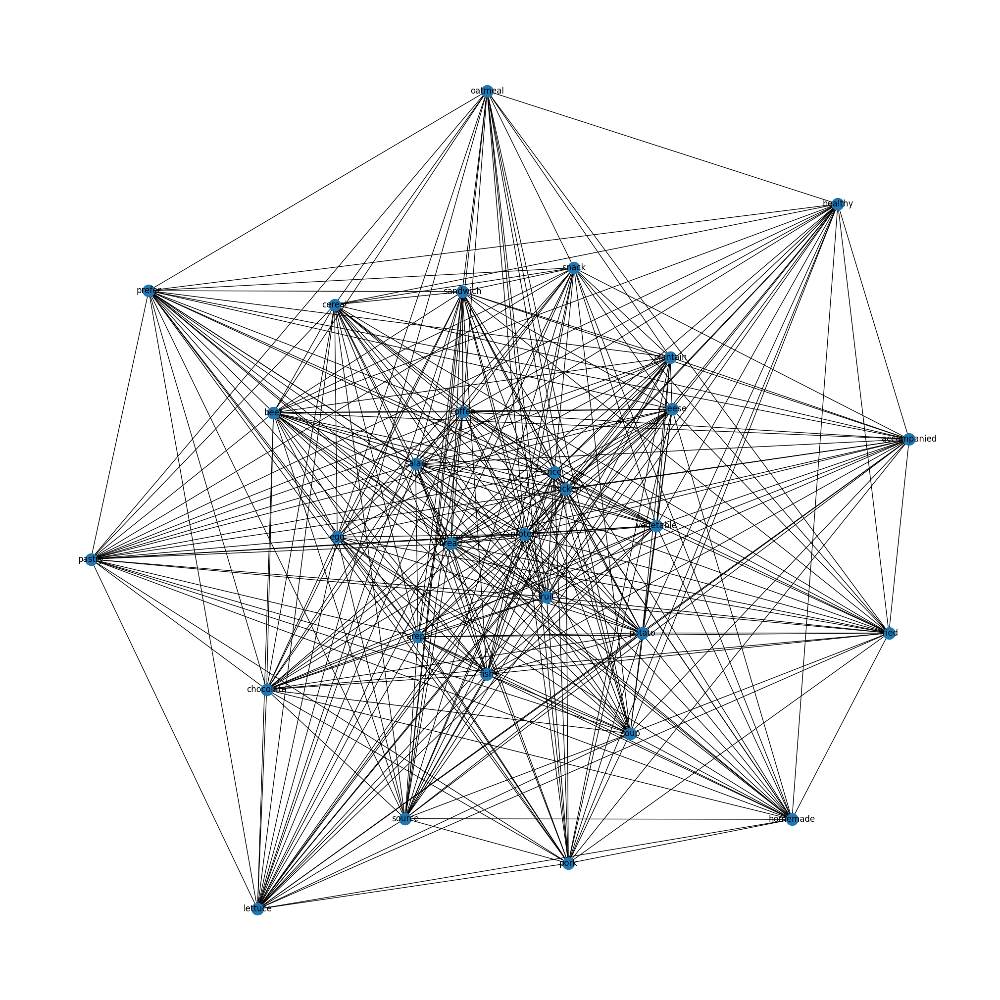

[[  0   0  18  57  21   0  66  21  72   0  33   9  60   9   0   6   0   9
   24  15  42   9  99   0  45  24  33  21  12  57]
 [  0   0   0   0  91 117   0  91 312 234 143  39 260   0  39  26   0  39
    0  65 182  39 429 390 195 104   0  91  52 247]
 [ 18   0   0 114  42  54 132  42 144 108  66  18 120  18  18  12  24  18
   48  30   0  18 198 180  90  48  66  42  24 114]
 [ 57   0 114   0 133 171 418 133 456   0 209  57 380   0  57  38   0  57
  152  95 266  57 627 570 285 152 209 133  76 361]
 [ 21  91  42 133   0   0 154  49 168 126  77  21 140  21   0  14  28  21
    0   0  98   0 231 210 105  56  77  49  28   0]
 [  0 117  54 171   0   0 198  63 216   0   0  27 180  27  27  18   0  27
   72  45 126  27 297 270 135  72  99  63   0 171]
 [ 66   0 132 418 154 198   0   0 528 396 242   0 440  66  66  44  88   0
  176 110 308   0 726 660 330 176   0 154  88 418]
 [ 21  91  42 133  49  63   0   0 168 126  77  21 140  21  21  14   0  21
    0  35  98  21 231   0 105  56   0  49  28 133]


In [38]:
#cleaning and text preparation section -->
def clean_text(text):
    additional_stopwords = ['ve', 'we', 'overall', 'she', 'it', 'he', 'avoid',
                            'called', 'audition', 'adhere', 'after', 'brownie',
                            'apple', 'arepuelas']
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
all_network_labels = {} #dictionaty to keep all node lables
#functin to generate graphs
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # Probability for the edges.
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['water','addition', 'afternoon', 'almost', 'alone', 'along', 'also', 'although', 'always', 'amount', 'another', 'anything', 'appetite', 'approximately', 'arepas', 'around', 'available', 'baby', 'back', 'balanced', 'based', 'basic', 'beverage', 'breakfast', 'breast', 'breastfeeding', 'carbohydrate', 'carnivorous', 'change', 'chickpea','choice', 'cola', 'cold', 'come', 'common', 'compared', 'complement', 'completely', 'consistent', 'consisting', 'consists', 'constant', 'consume', 'cooked', 'cookie', 'cooking', 'cooky', 'corn', 'could', 'course', 'crackling', 'cu', 'cucumber', 'cupcake', 'currently', 'cut', 'daily', 'dairy', 'decrease', 'depending', 'detrimental', 'diet', 'dinner', 'dish', 'dont', 'drink', 'eating', 'effort', 'either', 'eliminated', 'eliminating', 'else', 'empanada', 'emphasize', 'enjoy', 'especially', 'even', 'evening', 'every', 'everything', 'except', 'exclusively', 'fall', 'fast', 'favorite', 'feel', 'find', 'focus', 'focusing', 'follow', 'following', 'food', 'form', 'frequently', 'generally', 'going', 'good', 'grain', 'gram', 'grape', 'green', 'guava', 'habit', 'hardly', 'health', 'healthier', 'healthily', 'herbal', 'home', 'hour', 'house', 'hungry', 'hurry', 'improving', 'include', 'includes', 'including', 'increased', 'indulge', 'instance', 'intake', 'interestingly', 'item', 'juice', 'kind', 'known', 'lack', 'later', 'le', 'leftover', 'legume', 'level', 'light', 'lighter', 'like', 'liquid', 'little', 'lunch', 'lunchtime', 'made', 'main', 'mainly', 'maintain', 'make', 'many', 'mashed', 'maybe', 'meal', 'mean', 'meat', 'menu', 'method', 'midday', 'midmorning', 'might', 'missing', 'moderate', 'mogolla', 'morning', 'mostly', 'moving', 'much', 'night', 'normal', 'nowadays', 'oat', 'occasion', 'occasionally', 'often', 'option', 'packaged', 'pancake', 'pand', 'part', 'particular', 'passion', 'paste', 'peach', 'pear', 'penchant', 'pevery', 'piece', 'pineapple', 'plate', 'plenty', 'pof', 'possible', 'prepare', 'prepared', 'primarily', 'quick', 'quite', 'rarely', 'really', 'reason', 'reduced', 'refined', 'regular', 'regularly', 'rely', 'restaurant', 'restricting',  'scrambled', 'serving', 'significant', 'similar', 'since', 'situation', 'small', 'snacking', 'soda', 'solid', 'something', 'sometimes', 'sou' 'source', 'squash', 'start', 'started', 'steamed', 'stick', 'still', 'strict', 'strictly', 'substantial', 'sweet', 'taste', 'tend', 'though', 'three', 'throughout', 'time', 'toast', 'today', 'topped', 'towards', 'turn', 'type', 'typical', 'typically', 'unhealthy', 'urge', 'used', 'usual', 'usually', 'variation', 'variety', 'various', 'vary', 'way', 'week', 'well', 'white', 'without', 'work', 'would', 'year']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:30] #Select the top nodes
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20)) #Fig size
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p1c = p1cons.apply(clean_text)
network1 = create_red(p1c, 'network1')


# Obtener y mostrar la matriz de adyacencia
adjacency_matrix = nx.adjacency_matrix(network1).toarray()
print(adjacency_matrix)


Now, this dictionary preints the nodes and its frequency in the graph. It helps to delete nodes.

In [39]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network1)
dfx

,Node,Total Co-occurrence Frequency
22,protein,9933
23,rice,7500
6,chicken,5984
8,coffee,5640
12,fruit,5340
3,bread,5263
29,vegetable,4978
24,salad,4305
20,potato,3766
9,egg,3564


This chunk of code helps to pas a list of strings and it converts it into a simple list of individual strings...

It is pretty usefull when deleting nodes is necessary

In [40]:

texto = """
15	lemon	176
19	omelet	176
7	carrot	176
5	blackberry	176
30	watermelon	176
27	strawberry	352
2	banana	352
3	bean	352
21	pizza	352
20	papaya	352
28	tuna	352
18	milk	352
17	lettuce	352
1	avocado	352
14	empanadas	352
12	chorizo	352
16	lentil	352
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'lemon','omelet','carrot','blackberry','watermelon','strawberry','banana','bean','pizza','papaya','tuna','milk','lettuce','avocado','empanadas','chorizo','lentil'


#1N

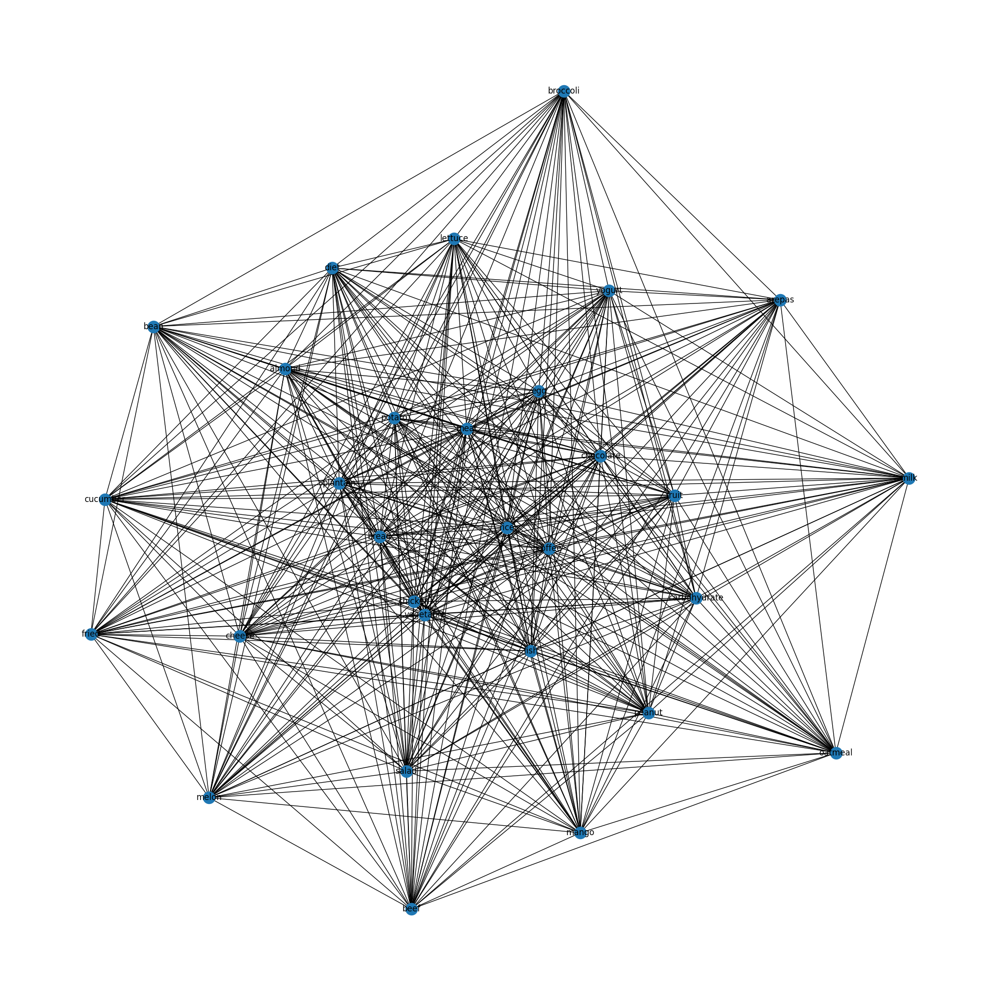

[[  0  28  28  28 140  21  56  49 133  91 133  28  42  98 105  28  70  42
   35 119  28  21  21  42  70  77 133  42 140  49]
 [ 28   0  16  16  80  12  32  28  76  52  76  16  24  56  60  16  40  24
   20  68  16  12  12  24  40  44  76  24  80  28]
 [ 28  16   0  16  80  12  32  28  76  52  76  16  24  56  60  16  40  24
   20  68  16  12  12  24  40  44  76  24  80  28]
 [ 28  16  16   0  80  12  32  28  76  52  76  16  24  56  60  16  40  24
   20  68  16  12  12  24  40  44  76  24  80  28]
 [140  80  80  80   0  60 160 140 380 260 380  80 120 280 300  80 200 120
  100 340  80  60  60 120 200 220 380 120 400 140]
 [ 21  12  12  12  60   0  24  21  57  39  57  12  18  42  45  12  30  18
   15  51  12   9   9  18  30  33  57  18  60  21]
 [ 56  32  32  32 160  24   0  56 152 104 152  32  48 112 120  32  80  48
   40 136  32  24  24  48  80  88 152  48 160  56]
 [ 49  28  28  28 140  21  56   0 133  91 133  28  42  98 105  28  70  42
   35 119  28  21  21  42  70  77 133  42 140  49]


In [41]:
def clean_text(text):
    additional_stopwords = ['ve', 'we', 'overall', 'she', 'it', 'he', 'avoid',
                            'called', 'audition', 'adhere', 'after', 'brownie',
                            'apple', 'arepuelas']
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 9:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = [
'academic', 'accompanied','accompany', 'additionally', 'afternoon', 'along', 'also', 'although', 'always', 'animal', 'another', 'around', 'available', 'bar', 'based', 'basic', 'breakfast', 'broth', 'chickpea', 'class', 'consist', 'consisting', 'consists', 'consume', 'consumed', 'contain', 'cooky', 'corn', 'course', 'daily', 'dairy', 'delight', 'depending', 'depends', 'different', 'dinner', 'dish', 'diverse', 'dont', 'drink', 'early', 'eating', 'either', 'enjoy', 'evening', 'find', 'focus', 'followed', 'food', 'form', 'four', 'full', 'grain', 'granadilla', 'granola', 'green', 'home', 'hour', 'hunger', 'include', 'includes', 'including', 'incorporate', 'juice', 'kind', 'later', 'left', 'leftover', 'light', 'lighter', 'like', 'local', 'lunch', 'main', 'mandarin', 'meal', 'menu', 'midmorning', 'might', 'milkbased', 'morning', 'mostly', 'night', 'noon', 'nut', 'occasionally', 'often', 'option', 'otherwise', 'packaged', 'part', 'pea', 'piece', 'plain', 'plenty', 'portion', 'product', 'protein', 'pwith', 'raisin', 'rarely', 'regular', 'repeat', 'repeated', 'rest', 'right', 'room', 'routine', 'santafereño', 'scrambled', 'serving', 'side', 'similar', 'slice', 'small', 'smaller', 'snack', 'soda', 'something', 'sometimes', 'sou', 'soup', 'source', 'starch', 'start', 'studying', 'sweet', 'switch', 'though', 'three', 'throughout', 'time', 'toast', 'treat', 'turnover', 'type', 'typical', 'typically', 'university', 'usual', 'usually', 'varied', 'varies', 'variety', 'various', 'vary', 'well', 'whatever', 'wheat', 'whether', 'whole']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:30]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p1n = p1noncons.apply(clean_text)
network1n = create_red(p1n, 'network1n')

# Obtener y mostrar la matriz de adyacencia
adjacency_matrix = nx.adjacency_matrix(network1n).toarray()
print(adjacency_matrix)

In [42]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network1n)
dfx

,Node,Total Co-occurrence Frequency
28,vegetable,5160
4,bread,5160
26,rice,4921
8,chicken,4921
10,coffee,4921
19,meat,4437
14,fish,3945
13,egg,3696
9,chocolate,3445
25,potato,2937


In [43]:
# Texto proporcionado
texto = """
15	melon	992
1	bean	992
8	cucumber	992
2	beef	992
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'melon','bean','cucumber','beef'


#P2-CHARACTERISTICS AND PREFERENCES

In [44]:
p2cons= compared['P2-CHARACTERISTICS AND PREFERENCES-CONS'].astype(str)
p2noncons= compared['P2-CHARACTERISTICS AND PREFERENCES-NONCONS'].astype(str)

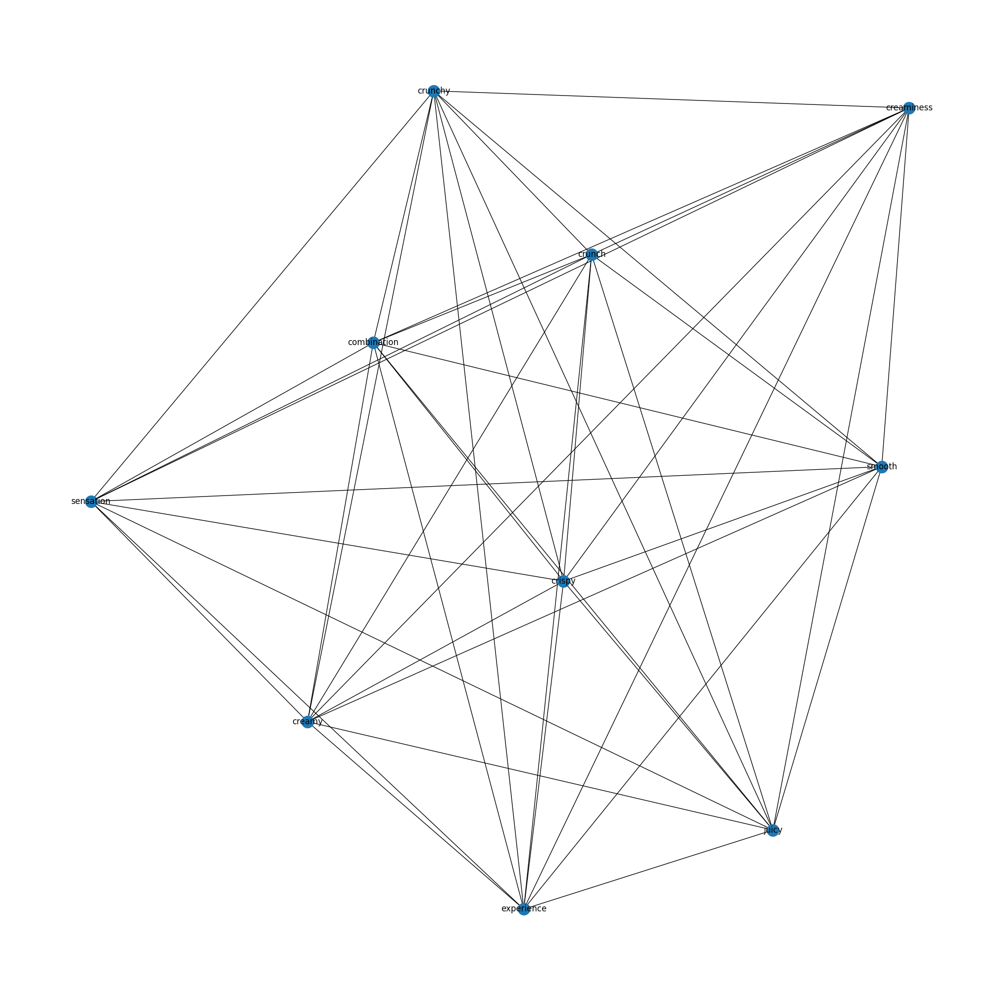

In [45]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['equilibrium','escape','everevolving','everexpanding','excites','enrich','expand','expectation','expedition','experiencing','experiment','explored','enriches','enhances','greasy','edible','dynamic','eager','eagerly','easy','ecstasy','edge','effect','enhance','egg','elevate','elevates','encountered','end','enduring','explorer','explosion','exquisite','gain','fork','fortunate','fracture','french','fry','full','gateway','extra','glide','global','go','goldenhued','graced','grease','fondness','foam','flood','flesh','finding','fillet','fiery','fettuccine','fattening','fascination','fascinating','farmer','familiar','fails','exudes','extremely','extraaged','zucchini','flavor','flaky','tactile','tahini','creative','wanted','universal','wall','voyage','vitality','vital','vendor','vast','vary','varies','varied','used','upon','unveil','universe','teeth','tasted','tangible','seasoned','side','shrimp','shredded','shred','sheer','shatters','share','served','sensorial','sense','seemingly','seem','seeing','seared','simply','scrambled','satisfy','sampling','sample','samosa','salty','salt','said','rough','rolled','roll','role','roasted','simple','single','taken','steak','sure','supple','sunsoaked','summary','succulence','substantial','sublime','strength','strand','story','stimulating','stew','step','state','slip','starting','stall','stage','spring','spread','spark','southeast','soup','snap','matter','small','slowly','maybe','ability','match','coating','city','clear','cling','clinging','coated','cold','chicharrón','colombi','companion','complexity','condiment','connecting','chickpea','chewy','consider','cause','cacophony','captivated','caramel','carbonara','carrot','case','celebration','chewiness','challenge','champion','change','char','cheddar','chef','connection','constant','dissolve','delectable','culminates','curious','dairy','deconstructed','deeply','defies','deliver','depends','derive','described','design','designed','desire','crystalline','crumbles','constantly','course','consumption','continue','continuing','control','cooling','corner','couscous','croissant','cracker','crackle','crackling','cradle','craftsm','creation','butterscotch','butter','bustling','appreciate','alone','although','amalgamation','angel','animalbased','approach','almond','approached','arepa','aroma','around','artisanal','artistry','almost','allure','bursting','addition','absorbing','accompanied','accompany','acidic','adapts','added','additional','allows','admit','adore','adorned','alive','all','allow','asia','assortment','avenue','brewery','blueberry','body','bold','bound','boundary','bowl','bridge','await','bright','brilliance','brings','brown','build','burger','black','beyond','beverage','best','beneath','beloved','believe','begin','become','beckon','beautifully','bar','banana','balanced','baguette','away','awakens','digestible','dog','master','innovation','impression','indulge','indulgence','infinity','infused','initial','innovative','imagine','insatiable','inspiration','instead','integrity','intense','international','important','iconic','intertwines','harm','guess','guilty','gustatory','hair','hand','happening','harmonizes','hummus','healthy','hedonistic','heirloom','hibiscus','home','honey','absolutely','intrigue','dream','local','light','lightness','liking','lingers','linguine','little','loses','leaving','lover','luxurious','maintaining','malaysi','mango','marbling','legume','le','intriguingly','joy','introduce','introduces','invite','itself','jam','japanese','juice','latin','kill','kind','kore','laksa','landscape','lasting','ground','green','greatest','excite','enthusiasm','entices','choice','immense','surprise','chip','practically','tangy','tantalizes','technique','spoonful','indi','preparation','coulis','steamed','ignites','surprising','coconut','combining','reveal','coming','complement','surrounded','homemade','strong','consume','street','strawberry','cookie','core','could','perfect','intertwine','spectacular','prepared','reason','embark','embodiment','first','filling','regarding','satisfaction','enthusiast','feast','ethereal','even','release','exciting','exotic','falafel','resistance','robust','experimentation','extraordinary','right','expression','ready','raspberry','quickly','prime','curiosity','custard','daring','tempura','pressure','snack','delivers','delve','dente','profile','earthy','profound','slight','dimension','discovering','discovery','diversity','divine','silkiness','drizzle','decadence','cocktail','revel','middle','amaze','beckons','noodle','beef','beer','uncharted','irresistible','inviting','twist','invigorating','moist','truly','blend','nourishment','lime','versatility','triple','bechamel','beauty','america','multisensory','mood','vinaigrette','vinegar','various','another','molten','animal','awaken','need','junk','back','unfolds','balsamic','challenging','bean','molecular','mind','boasting','vibrant','territory','think','melt','within','toasted','indulgent','wine','touch','additionally','marinated','catch','white','wonder','melting','cease','aged','breast','term','boundless','ajiaco','tenderness','market','intricate','captivates','quest','ramen','push','meaty','retaining','punctuated','region','rarely','related','miso','meringue','mixology','moderate','regional','modern','recipe','resonates','merge','remain','remains','remind','melted','reduce','reminder','pastry','protagonist','open','oasis','picturesque','obtained','picture','personally','occasional','perhaps','offering','olive','perceive','opened','mondongo','ordinary','oregano','paella','palatability','pancetta','paradise','penne','particular','pear','patty','pizza','place','playfulness','nuance','moroccaninspired','promise','morsel','mosaic','product','probably','mostly','mouthful','must','presented','presence','next','north','prepare','nostalgia','preference','poorly','pomegranate','point','novel','pleased','myriad','smell','revelation','river','undertake','understand','uncovered','unadulterated','ultimately','turning','turn','truck','trove','trip','trigger','tribute','treat','traveler','trattorias','transformed','tradition','totally','tossed','tooth','titillate','tingling','time','thrill','though','thick','thai','tend','tempting','undisputed','unfolding','unforgettable','weekend','yielding','would','wonderful','without','wide','whisk','whirlwind','whipped','wellseasoned','wellprepared','wellcrafted','welfare','weight','like','food','taste','bite','every','culinary','chicken','pasta','really','meat','sauce','also','fruit','dish','journey','world','cheese','offer','adventure','delight','come','chocolate','symphony','cuisine','palate','enjoy','contrast','fresh','testament','favorite','fusion','different','realm','endless','sens','salad','sensory','delightful','dont','mouth','exterior','interplay','satisfying','embrace','unique','protein','create','velvety','something','canvas','exploring','add','love','richness','ingredient','marriage','meal','hamburger','feel','never','refreshing','milk','natural','magic','possibility','perfectly','bud','layer','soft','rice','interior','together','color','savory','fish','find','exploration','balance','crisp','creating','thing','captivating','itali','take','delicate','playground','mushroom','many','make','lie','savor','harmonious','buttery','slightly','excitement','example','diverse','dessert','fast','essence','yield','becomes','well','matching','appeal','curry','spaghetti','adding','dance','vegetable','spice','especially','pleasure','lettuce','tomato','burst','masterpiece','combined','relish','prefer','juxtaposition','know','culture','opportunity','plate','blue','creates','cake','unexpected','cream','meet','gastronomy','much','pure','explore','crust','taco','delicious','making','mashed','marvel','releasing','sushi','bliss','variety','depth','dense','tart','whether','unknown','tantalizing','life','tapestry','crouton','trying','keep','array','baked','general','gelatinous','garlic','way','shell','found','ginger','avocado','form','attention','skin','flavorful','baking','sometimes','anticipation','always','result','dressing','succulent','ripe','sancocho','anything','give','seafood','apple','everything','bandeja','golden','source','rich','firm','provide','parmes','trout','paisa','pairing','textural','center','nut','presentation','connects','thrilling','treasure','comforting','nature','chew','transport','brittle','potato','umami','nothing','pleasant','nutty','tongue','contrasting','brie','cooking','mediterrane','tasty','work','true','craft','medley','truffle','caress','cooked','grainy','play','appreciation','accompanying','waiting','grape','platter','achieved','freshness','seeking','seed','gooey','peach','hard','nuttiness','savoring','harmony','health','flakiness','heart','gouda','silky','good','zing','freshly','fuel','paramount','zest','sharpness','short','showcase','part','gentle','paired','passion','pair','forget','gift','overall','plantain','zesty','weakness','orchestra','watermelon','hearty','salsa','satisfyingly','range','lava','moment']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p2c = p2cons.apply(clean_text)
network2 = create_red(p2c, 'network2')

In [46]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network2)
dfx

,Node,Total Co-occurrence Frequency
3,crispy,3036
0,combination,2584
4,crunch,2584
2,creamy,2466
6,experience,2224
7,juicy,2100
5,crunchy,1974
8,sensation,1716
9,smooth,1584
1,creaminess,1176


In [47]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [48]:
#print("Nodos en red3:", network2.nodes())

#2N

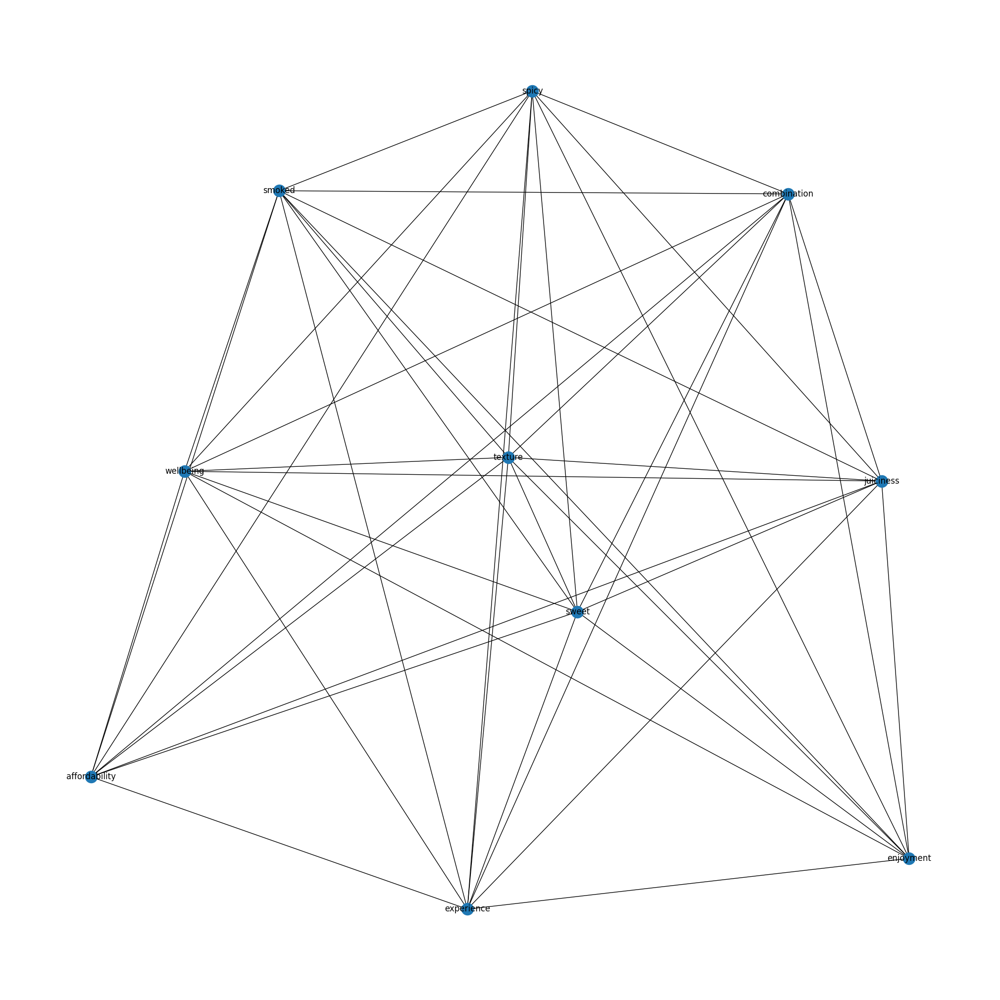

In [49]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['lead','includes','inconvenience','increasing','incredible','indispensable','influence','lieu','infusing','ingenuity','ingestion','lesser','lane','integrate','investing','invigorate','involves','hydrated','leaf','leading','key','kitchen','illness','however','hungry','happiness','fond','fortifying','foster','fully','furnish','gastronomic','giving','goto','grand','guidance','guided','harbor','hungerinduced','heavenly','heavy','heightened','heritage','high','higher','hint','list','hue','hued','lingering','magical','loving','loyalty','primarily','process','proclivity','profusion','promoting','prompting','provides','pursuit','pwith','quite','rather','receive','saucy','skeletal','sumptuousness','supersedes','supporting','susceptible','sustain','thereby','thread','threequarters','preclude','precedence','power','mitigation','favor','mainly','malady','manifest','memory','mentioned','meticulous','midst','mindfulness','mine','mitigate','moisture','nutritional','mom','mouthwatering','mucilaginous','multiplicity','muscle','natto','navigate','nearterm','negative','neurological','notice','comfort','broad','buying','caloric','cardiovascular','category','catering','celebrated','celebrating','chameleonlike','charting','chilly','common','fare','companionship','compared','complemented','component','concoction','confection','conjures','consistently','constituent','constitutes','contain','contribute','bring','boost','boon','block','achieving','acid','adequate','advantage','adverse','affording','affords','agree','akin','allowing','alltime','along','amidst','amount','amplification','animosity','anticipate','appetite','area','artistic','augment','avert','aware','bear','better','conversely','cornerstone','efficient','effortlessly','elevated','elevating','embracing','emerge','emerges','enables','encapsulates','encompass','endeavor','enhanced','enough','ensure','ensures','ensuring','entail','escapade','everyday','evident','excellent','exceptional','excessive','exerts','expect','accentuated','efficiently','efficiency','echo','dancing','debate','decision','definitely','deleterious','derived','detrimental','developing','difference','diminish','disagree','dislike','distinct','distinctive','dividend','drastically','drawing','drawn','drinking','drop','earn','easytoeat','facet','diet','fat','essential','risk','grain','bone','carbohydrate','function','quality','energy','dietary','nutrient','juicy','eating','disease','help','salmon','consuming','vitamin','mojarra','mineral','nutritious','one','fatty','lentil','pea','towards','system','broccoli','daily','proper','whole','chronic','saturated','sugar','brain','diabetes','water','often','mental','intake','enjoyable','benefit','portion','fiber','improve','stand','size','inclination','worth','impact','hydration','day','processed','pumpkin','cook','crucial','furthermore','fried','repair','pivotal','functioning','avoiding','among','seasoning','melon','unwanted','solid','mandarin','maintain','squash','arroz','avoid','level','digestion','lasagna','bodily','element','pollo','inherent','pork','calorie','significant','extends','refined','formation','foremost','equal','firstly','resist','excess','remember','importance','fundamental','physical','lifestyle','linchpin','liquid','longterm','manifold','organ','might','option','opting','moderation','moreover','mother','necessary','neurodegenerative','oat','notwithstanding','nourishing','people','issue','great','informed','growth','habit','promote','probiotic','hold','prevent','immune','imperative','implication','preferred','including','incorporate','increase','incredibly','individual','indulging','effort','nutrition','created','amazing','underestimate','undesirable','unhealthy','controlling','summation','corn','counterpart','coupled','crafted','crave','craving','structure','unprocessed','antioxidant','dehydration','beneficial','constipation','consists','chewing','tissue','throughout','busy','building','broth','cherished','coffee','blood','cognitive','text','tender','bounty','type','talk','viscous','trans','sourced','active','warmth','speaking','advance','digestive','softer','adaptability','disorder','sodium','slippery','despite','slimy','adopting','effectively','adopt','offered','personal','pesky','unappealing','unbeatable','pillar','occupy','planning','tug','trust','offputting','occasion','plethora','wholesome','obviate','plus','wield','winwin','transformative','transform','posed','penchant','vivid','undeniable','okra','vibrantly','want','outcome','outlet','versatile','overconsumption','unwelcome','optimal','overly','operation','warms','overstated','unpleasant','overwhelming','position','onthego','packed','paradigm','onset','partaking','unparalleled','wellrounded','particularly','omega','patacones','underestimated','paying','tends','traditional','resorting','resolve','residue','requisite','require','stabilization','replete','repast','stable','staying','render','steadfast','steaming','steer','regimen','resort','spectrum','potential','special','situation','significance','sidestep','shortterm','shame','serve','sensation','select','seek','soothing','sou','soul','sound','routine','rival','steering','strike','reducing','substance','prevalent','preserving','preservation','present','preparing','tandem','prepackaged','teeming'
,'equilibrium','escape','everevolving','everexpanding','excites','enrich','expand','expectation','expedition','experiencing','experiment','explored','enriches','enhances','greasy','edible','dynamic','eager','eagerly','easy','ecstasy','edge','effect','enhance','egg','elevate','elevates','encountered','end','enduring','explorer','explosion','exquisite','gain','fork','fortunate','fracture','french','fry','full','gateway','extra','glide','global','go','goldenhued','graced','grease','fondness','foam','flood','flesh','finding','fillet','fiery','fettuccine','fattening','fascination','fascinating','farmer','familiar','fails','exudes','extremely','extraaged','zucchini','flavor','flaky','tactile','tahini','creative','wanted','universal','wall','voyage','vitality','vital','vendor','vast','vary','varies','varied','used','upon','unveil','universe','teeth','tasted','tangible','seasoned','side','shrimp','shredded','shred','sheer','shatters','share','served','sensorial','sense','seemingly','seem','seeing','seared','simply','scrambled','satisfy','sampling','sample','samosa','salty','salt','said','rough','rolled','roll','role','roasted','simple','single','taken','steak','sure','supple','sunsoaked','summary','succulence','substantial','sublime','strength','strand','story','stimulating','stew','step','state','slip','starting','stall','stage','spring','spread','spark','southeast','soup','snap','matter','small','slowly','maybe','ability','match','coating','city','clear','cling','clinging','coated','cold','chicharrón','colombi','companion','complexity','condiment','connecting','chickpea','chewy','consider','cause','cacophony','captivated','caramel','carbonara','carrot','case','celebration','chewiness','challenge','champion','change','char','cheddar','chef','connection','constant','dissolve','delectable','culminates','curious','dairy','deconstructed','deeply','defies','deliver','depends','derive','described','design','designed','desire','crystalline','crumbles','constantly','course','consumption','continue','continuing','control','cooling','corner','couscous','croissant','cracker','crackle','crackling','cradle','craftsm','creation','butterscotch','butter','bustling','appreciate','alone','although','amalgamation','angel','animalbased','approach','almond','approached','arepa','aroma','around','artisanal','artistry','almost','allure','bursting','addition','absorbing','accompanied','accompany','acidic','adapts','added','additional','allows','admit','adore','adorned','alive','all','allow','asia','assortment','avenue','brewery','blueberry','body','bold','bound','boundary','bowl','bridge','await','bright','brilliance','brings','brown','build','burger','black','beyond','beverage','best','beneath','beloved','believe','begin','become','beckon','beautifully','bar','banana','balanced','baguette','away','awakens','digestible','dog','master','innovation','impression','indulge','indulgence','infinity','infused','initial','innovative','imagine','insatiable','inspiration','instead','integrity','intense','international','important','iconic','intertwines','harm','guess','guilty','gustatory','hair','hand','happening','harmonizes','hummus','healthy','hedonistic','heirloom','hibiscus','home','honey','absolutely','intrigue','dream','local','light','lightness','liking','lingers','linguine','little','loses','leaving','lover','luxurious','maintaining','malaysi','mango','marbling','legume','le','intriguingly','joy','introduce','introduces','invite','itself','jam','japanese','juice','latin','kill','kind','kore','laksa','landscape','lasting','ground','green','greatest','excite','enthusiasm','entices','choice','immense','surprise','chip','practically','tangy','tantalizes','technique','spoonful','indi','preparation','coulis','steamed','ignites','surprising','coconut','combining','reveal','coming','complement','surrounded','homemade','strong','consume','street','strawberry','cookie','core','could','perfect','intertwine','spectacular','prepared','reason','embark','embodiment','first','filling','regarding','satisfaction','enthusiast','feast','ethereal','even','release','exciting','exotic','falafel','resistance','robust','experimentation','extraordinary','right','expression','ready','raspberry','quickly','prime','curiosity','custard','daring','tempura','pressure','snack','delivers','delve','dente','profile','earthy','profound','slight','dimension','discovering','discovery','diversity','divine','silkiness','drizzle','decadence','cocktail','revel','middle','amaze','beckons','noodle','beef','beer','uncharted','irresistible','inviting','twist','invigorating','moist','truly','blend','nourishment','lime','versatility','triple','bechamel','beauty','america','multisensory','mood','vinaigrette','vinegar','various','another','molten','animal','awaken','need','junk','back','unfolds','balsamic','challenging','bean','molecular','mind','boasting','vibrant','territory','think','melt','within','toasted','indulgent','wine','touch','additionally','marinated','catch','white','wonder','melting','cease','aged','breast','term','boundless','ajiaco','tenderness','market','intricate','captivates','quest','ramen','push','meaty','retaining','punctuated','region','rarely','related','miso','meringue','mixology','moderate','regional','modern','recipe','resonates','merge','remain','remains','remind','melted','reduce','reminder','pastry','protagonist','open','oasis','picturesque','obtained','picture','personally','occasional','perhaps','offering','olive','perceive','opened','mondongo','ordinary','oregano','paella','palatability','pancetta','paradise','penne','particular','pear','patty','pizza','place','playfulness','nuance','moroccaninspired','promise','morsel','mosaic','product','probably','mostly','mouthful','must','presented','presence','next','north','prepare','nostalgia','preference','poorly','pomegranate','point','novel','pleased','myriad','smell','revelation','river','undertake','understand','uncovered','unadulterated','ultimately','turning','turn','truck','trove','trip','trigger','tribute','treat','traveler','trattorias','transformed','tradition','totally','tossed','tooth','titillate','tingling','time','thrill','though','thick','thai','tend','tempting','undisputed','unfolding','unforgettable','weekend','yielding','would','wonderful','without','wide','whisk','whirlwind','whipped','wellseasoned','wellprepared','wellcrafted','welfare','weight','like','food','taste','bite','every','culinary','chicken','pasta','really','meat','sauce','also','fruit','dish','journey','world','cheese','offer','adventure','delight','come','chocolate','symphony','cuisine','palate','enjoy','contrast','fresh','testament','favorite','fusion','different','realm','endless','sens','salad','sensory','delightful','dont','mouth','exterior','interplay','satisfying','embrace','unique','protein','create','velvety','something','canvas','exploring','add','love','richness','ingredient','marriage','meal','hamburger','feel','never','refreshing','milk','natural','magic','possibility','perfectly','bud','layer','soft','rice','interior','together','color','savory','fish','find','exploration','balance','crisp','creating','thing','captivating','itali','take','delicate','playground','mushroom','many','make','lie','savor','harmonious','buttery','slightly','excitement','example','diverse','dessert','fast','essence','yield','becomes','well','matching','appeal','curry','spaghetti','adding','dance','vegetable','spice','especially','pleasure','lettuce','tomato','burst','masterpiece','combined','relish','prefer','juxtaposition','know','culture','opportunity','plate','blue','creates','cake','unexpected','cream','meet','gastronomy','much','pure','explore','crust','taco','delicious','making','mashed','marvel','releasing','sushi','bliss','variety','depth','dense','tart','whether','unknown','tantalizing','life','tapestry','crouton','trying','keep','array','baked','general','gelatinous','garlic','way','shell','found','ginger','avocado','form','attention','skin','flavorful','baking','sometimes','anticipation','always','result','dressing','succulent','ripe','sancocho','anything','give','seafood','apple','everything','bandeja','golden','source','rich','firm','provide','parmes','trout','paisa','pairing','textural','center','nut','presentation','connects','thrilling','treasure','comforting','nature','chew','transport','brittle','potato','umami','nothing','pleasant','nutty','tongue','contrasting','brie','cooking','mediterrane','tasty','work','true','craft','medley','truffle','caress','cooked','grainy','play','appreciation','accompanying','waiting','grape','platter','achieved','freshness','seeking','seed','gooey','peach','hard','nuttiness','savoring','harmony','health','flakiness','heart','gouda','silky','good','zing','freshly','fuel','paramount','zest','sharpness','short','showcase','part','gentle','paired','passion','pair','forget','gift','overall','plantain','zesty','weakness','orchestra','watermelon','hearty','salsa','satisfyingly','range','lava','moment']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p2n = p2noncons.apply(clean_text)
network2n = create_red(p2n, 'network2n')

In [50]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network2n)
dfx

,Node,Total Co-occurrence Frequency
8,texture,600
7,sweet,336
1,combination,141
3,experience,141
4,juiciness,141
5,smoked,141
6,spicy,141
9,wellbeing,141
0,affordability,92
2,enjoyment,92


In [51]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [52]:

#print("Nodos en red4:", network2n.nodes())


#P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS'

In [53]:
p3cons= compared['P3- CHARACTERISTICS OF NON-PREFERRED FOODS-CONS'].astype(str)
p3noncons= compared['P3- CHARACTERISTICS OF NON-PREFERRED FOODS-NONCONS'].astype(str)

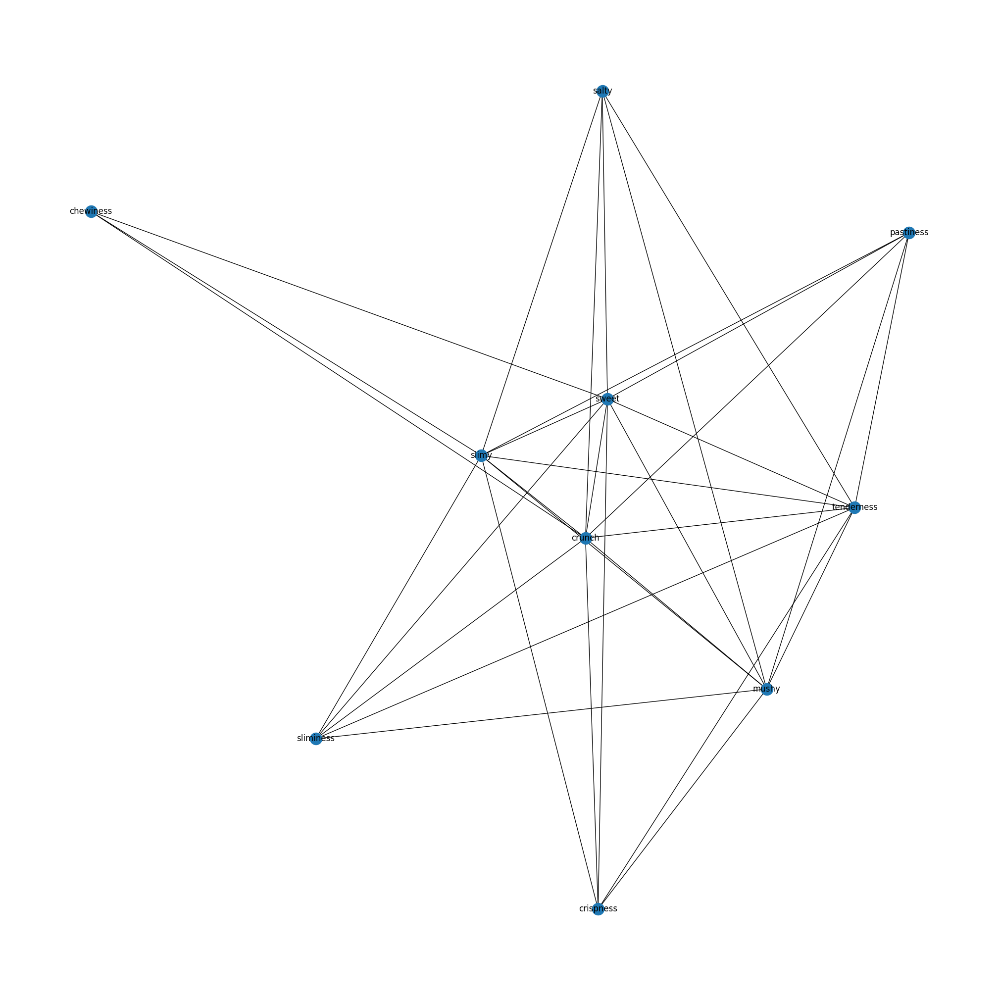

In [54]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['familiarity','crisp','crispy','insect','sensation','smell','taste','flavor','texture','heightens','hesitate','hidden','hint','however','luster','cream','create','creating','cringe','culprit','dancing','daring','deeper','defies','distinct','distinction','diverge','engaging','enjoyment','enrich','entered','enthusiasm','enthusiast','enthusiastic','entice','enticing','entity','entomophagous','entranced','escapade','eschew','essential','etching','everevolving','evident','enigma','enduring','dog','endure','dominion','doubleedged','each','eager','echo','echoing','edge','egg','elaborate','elicits','else','embarked','encapsulated','encountered','encountering','ended','conspire','conjure','planet','back','ardent','arm','ascended','asserting','attention','attuned','audacious','awaken','backdrop','concoction','ball','barrier','base','basically','becomes','beetroot','behind','being','approach','appetizer','appearance','apart','abrasive','accept','accompanied','adventurous','adversary','adversity','aficionado','aftertaste','alien','align','ally','alone','already','always','anew','another','anymore','belies','best','beyond','celebrated','chance','chapter','character','cherished','chicken','chorus','cloud','colombi','combined','comforting','companion','completely','complexity','compose','composing','composition','celebration','celebrate','biggest','cautious','biting','blend','bling','boast','bocadillo','bordering','brick','bringing','broaden','burst','cabbage','captivated','capture','caress','carousel','cat','cauldron','evokes','evolved','evolving','minuscule','meaning','medley','memory','mention','mere','meticulously','mind','minimal','mirror','exchange','mojojoy','morph','morphed','morsel','mosaic','mouse','move','mayonnaise','maximum','match','masquerade','intrigued','intriguing','introduced','introduces','invoke','journeyed','kicker','lacking','later','lend','lettuce','lie','light','longing','abound','marked','marvel','munch','name','narrator','overly','parasite','participant','particular','path','patron','pattern','pausing','pave','peating','pedestal','people','perception','pfor','pineapple','pioneer','pizza','plain','paradox','natural','organ','neither','nonconsumers','nostalgia','note','nutritional','obligation','obviously','occasionally','odor','offputting','okay','one','onion','openmindedness','opportunity','or','orb','intrigue','intricate','intertwined','flit','follow','follows','foray','forced','forever','fragment','fragmentation','fruit','gastronomy','give','glassy','glide','good','goodness','grand','grappling','folk','fleeting','great','finger','excited','excitement','exciting','exist','expected','explain','extends','exudes','eye','familiar','fascination','fault','favorite','fear','feeling','figure','grayish','grew','interaction','illuminated','immediately','imparting','incredible','individual','indulgence','influence','infuse','ingredient','inherent','initial','initially','insectfood','instance','instead','insurmountable','intention','imagine','idea','grou','ibias','guess','guest','guinea','gusto','hand','handle','happen','happened','hard','headfirst','headscratcher','heavy','unite','canvas','beet','carrot','carry','cartilage','overbearing','problem','tolerate','together','dismiss','yeah','curiosity','distinctive','diving','redefined','drawn','refusing','ecoconscious','yielded','embraced','embracing','adorned','yielding','relinquish','endless','meltinthemouth','melon','melodious','enigmatic','enjoy','subtle','distaste','moment','dish','mouth','tiny','delicacy','anything','myriad','thought','range','deter','persistence','upon','aligns','tenaciously','mostly','intestinal','rhythm','poorly','plea','precursor','potent','predisposes','preferred','pleasant','rib','pof','preparation','prefer','rich','rice','revel','revelation','posse','resounding','reluctance','resonates','rabbit','reminiscent','rather','reminding','ready','real','reason','recoil','remembered','regular','relationship','remains','release','remaining','relinquished','relish','rapid','quite','resonate','quickly','pretty','prickly','resists','proceed','product','resilience','proteinpacked','prove','provided','provides','pungent','put','residue','quail','quick','proving','splendor','ripe','triumphant','transition','traversing','treat','tree','tricky','tried','trip','trust','transcends','tugging','ultimately','unabating','uncanny','unconventional','uncovered','uncovers','transient','trade','undertaken','thrill','tension','tentative','term','territory','thigh','though','threshold','thrive','tough','throatscratchers','throne','told','tomato','tongue','took','torment','understand','unease','tenacity','willingness','warm','went','whatever','whenever','whiff','wholeheartedly','wild','wind','waiting','worm','worry','woven','yang','yearning','yogurt','young','want','vivid','unexplored','unspoken','unfamiliar','unfurls','union','unites','unless','unrest','unseen','unwilling','vibrant','usually','varied','variety','velvety','venturing','verge','vibrancy','tender','tempting','robustness','signal','seriously','served','shake','shatters','shiver','shudder','shun','skepticism','sensory','slickness','slide','slip','slipperiness','slurper','snake','softness','serf','sends','solidity','savior','role','sail','sardine','satiate','satisfaction','satisfy','saving','scare','sell','screw','seafood','secret','seeking','seem','seemed','seems','solid','someone','temperament','symbol','surface','surrender','sushi','sustainability','sustainable','swallow','sword','takeaway','subtlety','taken','tantalizes','tasted','teeter','tell','telling','superhero','struggle','sonata','spinning','sou','soul','sound','source','specifically','spell','spine','plate','strike','started','steadfast','step','still','stimulate','stimulates','stopped','play','ability','plantbased','difficult','depending','derivative','despite','deterrent','detest','developed','devotee','dichotomy','digestion','conjures','dimension','disappointment','disciple','discordant','discovered','disdain','dissolve','distant','depend','demeanor','delightful','defy','consumed','contemplation','contradiction','converge','conviction','could','countless','crab','like','dont','food','culinary','journey','world','palate','bite','also','might','find','mashua','tapestry','tuber','thing','salad','experience','preference','something','aversion','every','tactile','sometimes','snack','diverse','realm','vegetable','embrace','symphony','entomophagy','adventure','offer','cuisine','strong','soup','aroma','challenge','tamarillo','cucumber','beckon','gelatinous','pasty','landscape','nature','even','certain','perspective','exploration','testament','color','think','lentil','chocolate','carnival','childhood','delight','feel','really','dislike','bud','narrative','unique','packaged','combination','often','either','international','meat','story','cooked','consume','possibility','pepper','whole','appreciate','dance','savory','table','banana','become','bell','milk','resistance','reminder','eating','juice','delicate','glossy','contrast','little','fig','chewy','challenging','come','friend','throat','time','make','take','pressure','satisfying','within','well','alternative','almost','beauty','kind','staple','sens','allure','animal','many','spectrum','akin','ride','discomfort','explore','sense','potato','exotic','maybe','exoskeleton','especially','lingers','reluctant','essence','creature','much','encounter','diversity','digest','thrilling','mainly','soft','redefine','finding','tale','evolution','different','stew','everything','emerges','navigate','substantial','others','unknown','hold','leaving','shiny','shimmering','unfolds','arracacha','wellprepared','scratchy','leave','identity','called','shape','learned','gustatory','peculiar','away','seek','serve','bring','unpleasant','harmonious','blood','unsung','harmony','kaleidoscope','bitter','part','presence','savor','hero','iridescent','clinging','line','robust','yield','consistency','insectbased','nutrition','fragrance','puree','pork','sipper','gastronomic','would','chew','cling','inviting','anticipation','open','appeal','level','gentle','strange','home','interplay','horizon','remain','issue','innovation','iridescence','humble','scratching','stir','linger','maestro','know','example','lingering','forget','form','formidable','fine','found','fret','slightest','life','structure','fervor','gateway','general','liver','long','simmering','grace','longer','look','grip','made','shimmer','exploring','slurpers','leaf','lead','stand','lack','yucca','discovery','right','critter','balance','unassuming','waltz','wanting','comfort','subcutaneous','provoke','obscure','weave','traverse','welcome','transit','novelty','transformation','nothing','traditional','convention','traded','armor','quest','country','prepared','quirk','uncharted','protein','promise','brittle','passion','present','bland','unveil','papaya','bowl','boyac','past','paint','brings','brittleness','pate','broccoli']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p3c = p3cons.apply(clean_text)
network3 = create_red(p3c, 'network3')

In [55]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network3)
dfx

,Node,Total Co-occurrence Frequency
2,crunch,341
8,sweet,297
7,slimy,245
3,mushy,114
9,tenderness,114
1,crispness,66
4,pastiness,66
5,salty,66
6,sliminess,66
0,chewiness,27


In [56]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#3N

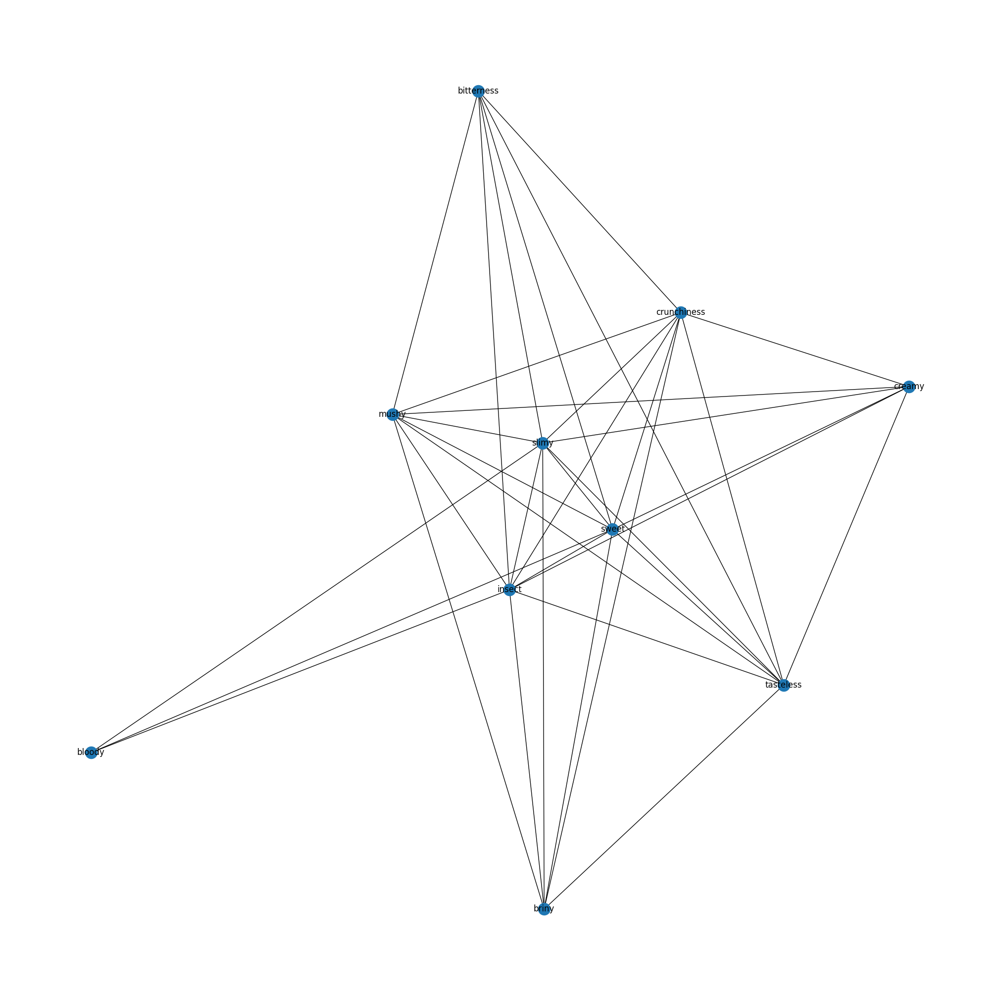

In [57]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['familiarity','crisp','crispy','sensation','smell','taste','flavor','texture','consuming','avoid','chinese','fish','list','liking','trying','pumpkin','tend','shrimp','thanks','option','particularly','matter','pas','coffee','unappetizing','type','lechona','veggie','intestine','interest','personal','rat','combo','coconut','left','turnip','earthy','suit','nope','fond','clear','nogo','garlic','fried','uncomfortable','tibia','crunchy','health','stick','used','cauliflower','steer','catastrophe','draw','sweetness','involve','le','whether','perhaps','along','rubbery','making','japanese','yolk','spinach','pause','tends','party','deliver','enhance','enemy','sausage','throw','dining','processed','salty','runny','risk','scene','tied','tolimense','tendency','overpowering','technique','fuss','it','spreading','high','stuff','solve','ground','lose','goto','menu','mixed','mystery','sign','tamal','tarantula','short','opting','involved','deal','zone','consider','unsettling','boyacense','actually','ant','cocido','available','board','without','aware','wondering','chanfaina','clash','cunchito','wellcooked','bigbottom','choose','chunchullo','characteristic','item','willing','say','parade','aspect','willingly','stay','wrap','steak','history','perfectly','steal','cheese','charm','spoonful','impact','perceive','help','stellar','groove','bread','measure','nose','nightmare','befriend','need','show','better','offender','okra','milder','metabolism','mess','bit','mentioned','simply','keep','seedy','voice','visual','letdown','slurp','oriental','viscera','least','vibe','kitchen','kinda','sugar','gritty','shrim','pet','touch','rsvping','tenfoot','acquire','wrong','profile','them','enjoyable','rain','they','grainy','those','eats','fall','turned','count','earlier','duty','quality','dressing','drenched','unappealing','total','topic','toosweet','cross','trifecta','confused','flour','gooey','phase','remember','go','super','chunky','decided','plenty','plus','decline','unpredictable','pole','anyone','closer','flavorful','component','adventurer','finale','condiment','wheelhouse','remotely','response','resisted','reputation','shortlist','shine','seasoning','shedding','wide','worldwide','sauce','sandpaper','winning','rub','savoring','scent','shaped','rough','seduce','rooted','younger','revolt','revisit','selective','triple','spirit','wellbeing','upset','sum','supremely','sure','swallowing','regard','taking','talk','unnervingly','unleash','temptation','universe','test','unimpressed','underlying','thoroughly','threat','undercooked','uncooked','ticket','tickle','toward','towards','town','tread','trigger','tummy','trinity','unwillingness','succulent','sight','succulence','weather','way','significant','signify','similarly','single','wasabi','situation','slightly','warming','slippery','soon','spice','versatility','venture','heightens','hesitate','hidden','hint','however','luster','cream','create','creating','cringe','culprit','dancing','daring','deeper','defies','distinct','distinction','diverge','engaging','enjoyment','enrich','entered','enthusiasm','enthusiast','enthusiastic','entice','enticing','entity','entomophagous','entranced','escapade','eschew','essential','etching','everevolving','evident','enigma','enduring','dog','endure','dominion','doubleedged','each','eager','echo','echoing','edge','egg','elaborate','elicits','else','embarked','encapsulated','encountered','encountering','ended','conspire','conjure','planet','back','ardent','arm','ascended','asserting','attention','attuned','audacious','awaken','backdrop','concoction','ball','barrier','base','basically','becomes','beetroot','behind','being','approach','appetizer','appearance','apart','abrasive','accept','accompanied','adventurous','adversary','adversity','aficionado','aftertaste','alien','align','ally','alone','already','always','anew','another','anymore','belies','best','beyond','celebrated','chance','chapter','character','cherished','chicken','chorus','cloud','colombi','combined','comforting','companion','completely','complexity','compose','composing','composition','celebration','celebrate','biggest','cautious','biting','blend','bling','boast','bocadillo','bordering','brick','bringing','broaden','burst','cabbage','captivated','capture','caress','carousel','cat','cauldron','evokes','evolved','evolving','minuscule','meaning','medley','memory','mention','mere','meticulously','mind','minimal','mirror','exchange','mojojoy','morph','morphed','morsel','mosaic','mouse','move','mayonnaise','maximum','match','masquerade','intrigued','intriguing','introduced','introduces','invoke','journeyed','kicker','lacking','later','lend','lettuce','lie','light','longing','abound','marked','marvel','munch','name','narrator','overly','parasite','participant','particular','path','patron','pattern','pausing','pave','peating','pedestal','people','perception','pfor','pineapple','pioneer','pizza','plain','paradox','natural','organ','neither','nonconsumers','nostalgia','note','nutritional','obligation','obviously','occasionally','odor','offputting','okay','one','onion','openmindedness','opportunity','or','orb','intrigue','intricate','intertwined','flit','follow','follows','foray','forced','forever','fragment','fragmentation','fruit','gastronomy','give','glassy','glide','good','goodness','grand','grappling','folk','fleeting','great','finger','excited','excitement','exciting','exist','expected','explain','extends','exudes','eye','familiar','fascination','fault','favorite','fear','feeling','figure','grayish','grew','interaction','illuminated','immediately','imparting','incredible','individual','indulgence','influence','infuse','ingredient','inherent','initial','initially','insectfood','instance','instead','insurmountable','intention','imagine','idea','grou','ibias','guess','guest','guinea','gusto','hand','handle','happen','happened','hard','headfirst','headscratcher','heavy','unite','canvas','beet','carrot','carry','cartilage','overbearing','problem','tolerate','together','dismiss','yeah','curiosity','distinctive','diving','redefined','drawn','refusing','ecoconscious','yielded','embraced','embracing','adorned','yielding','relinquish','endless','meltinthemouth','melon','melodious','enigmatic','enjoy','subtle','distaste','moment','dish','mouth','tiny','delicacy','anything','myriad','thought','range','deter','persistence','upon','aligns','tenaciously','mostly','intestinal','rhythm','poorly','plea','precursor','potent','predisposes','preferred','pleasant','rib','pof','preparation','prefer','rich','rice','revel','revelation','posse','resounding','reluctance','resonates','rabbit','reminiscent','rather','reminding','ready','real','reason','recoil','remembered','regular','relationship','remains','release','remaining','relinquished','relish','rapid','quite','resonate','quickly','pretty','prickly','resists','proceed','product','resilience','proteinpacked','prove','provided','provides','pungent','put','residue','quail','quick','proving','splendor','ripe','triumphant','transition','traversing','treat','tree','tricky','tried','trip','trust','transcends','tugging','ultimately','unabating','uncanny','unconventional','uncovered','uncovers','transient','trade','undertaken','thrill','tension','tentative','term','territory','thigh','though','threshold','thrive','tough','throatscratchers','throne','told','tomato','tongue','took','torment','understand','unease','tenacity','willingness','warm','went','whatever','whenever','whiff','wholeheartedly','wild','wind','waiting','worm','worry','woven','yang','yearning','yogurt','young','want','vivid','unexplored','unspoken','unfamiliar','unfurls','union','unites','unless','unrest','unseen','unwilling','vibrant','usually','varied','variety','velvety','venturing','verge','vibrancy','tender','tempting','robustness','signal','seriously','served','shake','shatters','shiver','shudder','shun','skepticism','sensory','slickness','slide','slip','slipperiness','slurper','snake','softness','serf','sends','solidity','savior','role','sail','sardine','satiate','satisfaction','satisfy','saving','scare','sell','screw','seafood','secret','seeking','seem','seemed','seems','solid','someone','temperament','symbol','surface','surrender','sushi','sustainability','sustainable','swallow','sword','takeaway','subtlety','taken','tantalizes','tasted','teeter','tell','telling','superhero','struggle','sonata','spinning','sou','soul','sound','source','specifically','spell','spine','plate','strike','started','steadfast','step','still','stimulate','stimulates','stopped','play','ability','plantbased','difficult','depending','derivative','despite','deterrent','detest','developed','devotee','dichotomy','digestion','conjures','dimension','disappointment','disciple','discordant','discovered','disdain','dissolve','distant','depend','demeanor','delightful','defy','consumed','contemplation','contradiction','converge','conviction','could','countless','crab','like','dont','food','culinary','journey','world','palate','bite','also','might','find','mashua','tapestry','tuber','thing','salad','experience','preference','something','aversion','every','tactile','sometimes','snack','diverse','realm','vegetable','embrace','symphony','entomophagy','adventure','offer','cuisine','strong','soup','aroma','challenge','tamarillo','cucumber','beckon','gelatinous','pasty','landscape','nature','even','certain','perspective','exploration','testament','color','think','lentil','chocolate','carnival','childhood','delight','feel','really','dislike','bud','narrative','unique','packaged','combination','often','either','international','meat','story','cooked','consume','possibility','pepper','whole','appreciate','dance','savory','table','banana','become','bell','milk','resistance','reminder','eating','juice','delicate','glossy','contrast','little','fig','chewy','challenging','come','friend','throat','time','make','take','pressure','satisfying','within','well','alternative','almost','beauty','kind','staple','sens','allure','animal','many','spectrum','akin','squirm','vegetari','vast','starchy','various','value','staunch','usual','stem','sticking','storm','regarding','acceptables','refuse','cut','detail','despise','desire','desirable','described','derive','dealbreaker','day','culture','refusal','crunch','crucial','credit','craving','cook','contrary','continuing','contest','develop','direction','discerning','distinctly','faves','fat','fails','faced','experimenting','expectation','exactly','empty','embark','eludes','eggs','eater','easier','dude','double','done','dive','consumer','connotation','confusion','beloved','begin','battle','based','bane','attribute','association','assault','artificial','array','around','aromatic','appetizing','anytime','admit','adjective','additionally','blame','blur','concept','boat','combine','clashing','clarify','cholesterol','chewing','chalkboard','category','carefully','bypass','buying','burger','bueno','broth','brew','boundary','bother','book','favor','firm','first','overwhelm','overload','overcooked','overall','openminded','onto','oneway','onetwo','olfactory','oceanic','nuhuh','notsopleasant','non','never','navigating','nail','accompany','miss','overpowers','painted','meal','pasta','referred','referee','radar','questioning','question','puzzled','punch','pulse','provide','probably','praised','powerhouse','potential','popularity','polished','picky','pdue','melt','mark','fishy','horror','highlighting','heck','hearty','hanging','groundsladen','grilled','gravitating','going','gang','fusion','fullon','full','focus','flop','float','flip','flavoring','hit','inclination','main','inclined','magnifying','locally','liquid','legume','lastly','lackluster','known','juicy','jive','jasmine','is','invading','intense','integral','insects','incorporate','moving'
,'ride','discomfort','explore','sense','potato','exotic','maybe','exoskeleton','especially','lingers','reluctant','essence','creature','much','encounter','diversity','digest','thrilling','mainly','soft','redefine','finding','tale','evolution','different','stew','everything','emerges','navigate','substantial','others','unknown','hold','leaving','shiny','shimmering','unfolds','arracacha','wellprepared','scratchy','leave','identity','called','shape','learned','gustatory','peculiar','away','seek','serve','bring','unpleasant','harmonious','blood','unsung','harmony','kaleidoscope','bitter','part','presence','savor','hero','iridescent','clinging','line','robust','yield','consistency','insectbased','nutrition','fragrance','puree','pork','sipper','gastronomic','would','chew','cling','inviting','anticipation','open','appeal','level','gentle','strange','home','interplay','horizon','remain','issue','innovation','iridescence','humble','scratching','stir','linger','maestro','know','example','lingering','forget','form','formidable','fine','found','fret','slightest','life','structure','fervor','gateway','general','liver','long','simmering','grace','longer','look','grip','made','shimmer','exploring','slurpers','leaf','lead','stand','lack','yucca','discovery','right','critter','balance','unassuming','waltz','wanting','comfort','subcutaneous','provoke','obscure','weave','traverse','welcome','transit','novelty','transformation','nothing','traditional','convention','traded','armor','quest','country','prepared','quirk','uncharted','protein','promise','brittle','passion','present','bland','unveil','papaya','bowl','boyac','past','paint','brings','brittleness','pate','broccoli']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p3n = p3noncons.apply(clean_text)
network3n = create_red(p3n, 'network3n')

In [58]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network3n)
dfx

,Node,Total Co-occurrence Frequency
8,sweet,912
7,slimy,816
5,insect,660
4,crunchiness,305
6,mushy,305
9,tasteless,189
0,bitterness,120
2,briny,120
3,creamy,120
1,bloody,47


In [59]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#4-CULTURAL BELIEFS ABOUT CONSUMPTION

In [60]:
p4cons= compared['QUESTION 6 - CULTURAL BELIEFS ABOUT CONSUMPTION-CONS'].astype(str)
p4noncons= compared['P6-CULTURAL BELIEFS ABOUT CONSUMPTION- NONCONS'].astype(str)

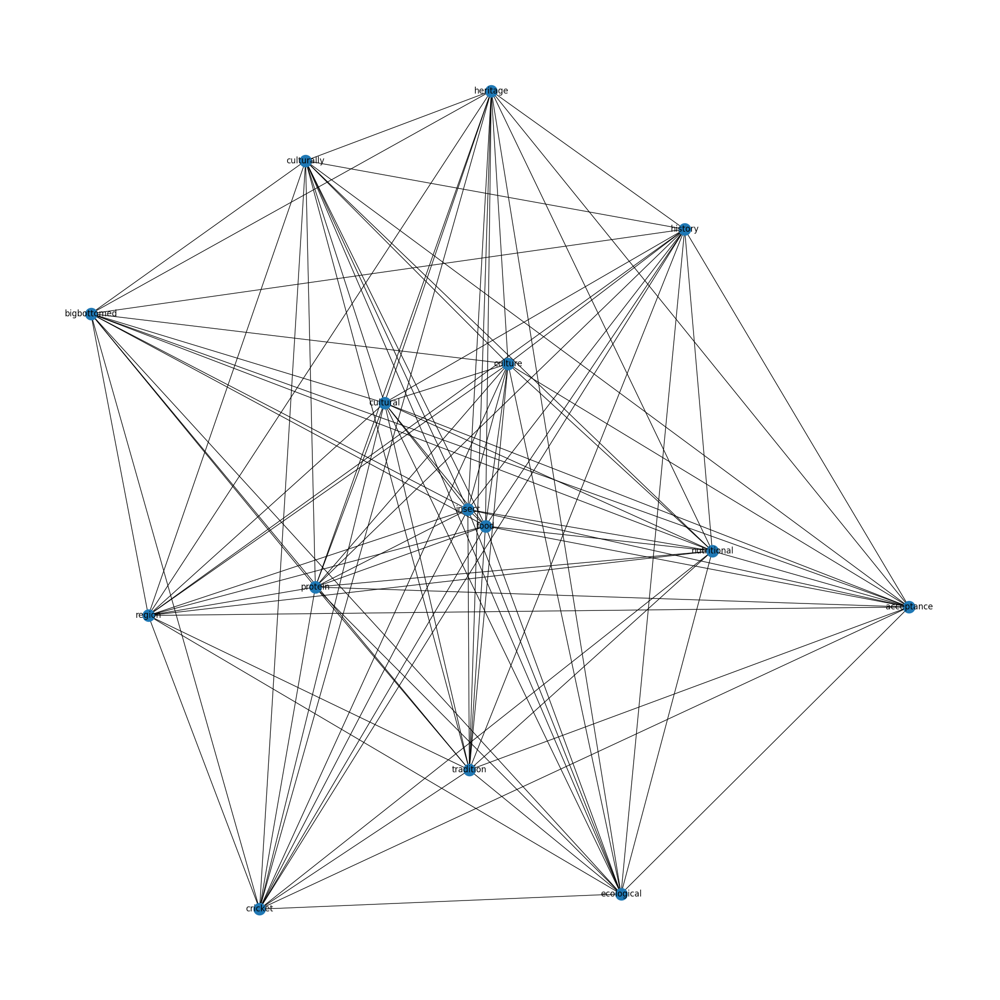

In [61]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p4c = p4cons.apply(clean_text)
network4 = create_red(p4c, 'network4')

In [62]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network4)
dfx

,Node,Total Co-occurrence Frequency
10,insect,21111
3,cultural,13056
7,food,12831
5,culture,8439
12,protein,6831
14,tradition,3991
11,nutritional,3100
4,culturally,2799
9,history,2799
13,region,2799


In [63]:
# Texto proporcionado
texto = """
11	curiosity	316
15	ecology	316
34	nutrition	316
7	crosscultural	316
26	gastronomy	316
25	gastronomic	316
24	footprint	316
39	sustainable	316
40	taboo	316
18	edibility	316
32	insectbased	316
19	entomophagy	702
22	folk	702
2	balance	702
38	sustainability	702
5	colombia	702
33	nutrient	702
21	familiarity	702
28	healthy

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy'


#4N

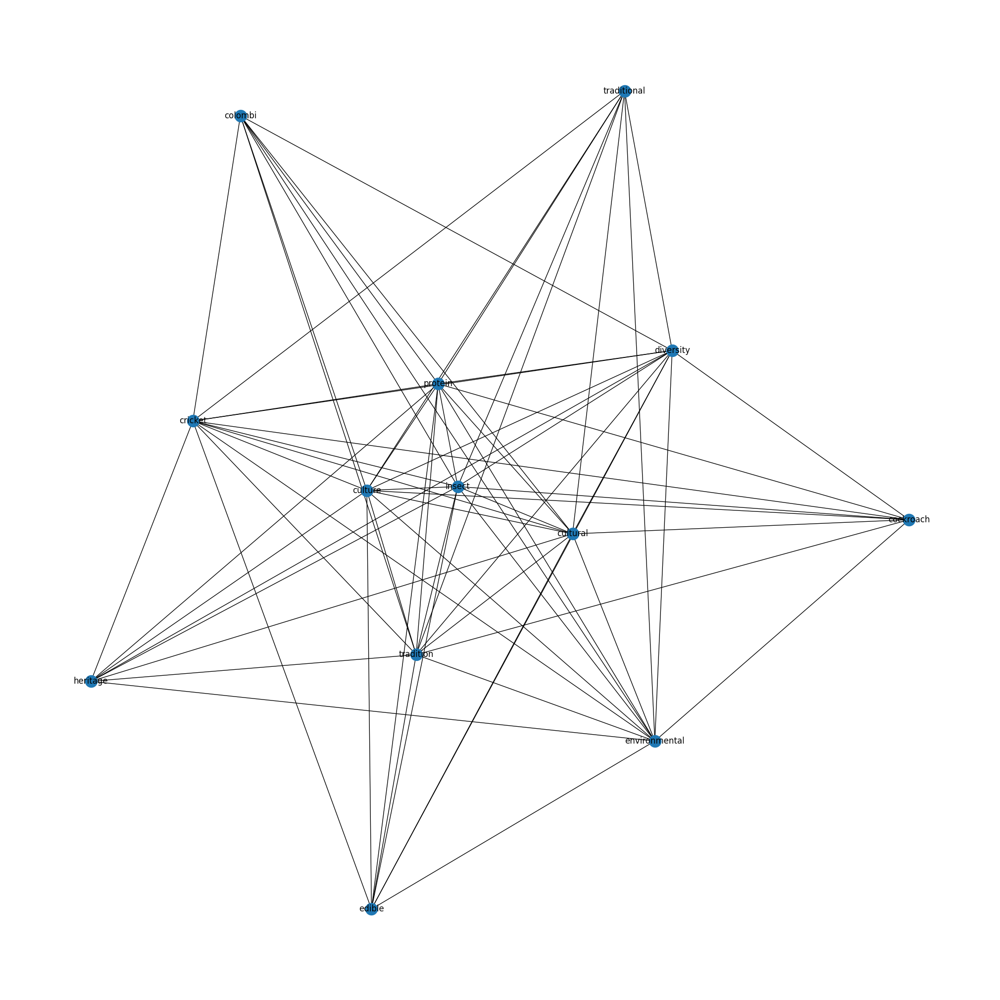

In [64]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','china','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','cheaper','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:13]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p4n = p4noncons.apply(clean_text)
network4n = create_red(p4n, 'network4n')

In [65]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network4n)
dfx

,Node,Total Co-occurrence Frequency
9,insect,4785
4,culture,2737
3,cultural,2125
10,protein,1905
11,tradition,1320
5,diversity,685
2,cricket,552
7,environmental,417
0,cockroach,264
1,colombi,264


In [66]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [67]:
#plt.title('Question 4: Cultural beliefs about insect-food based consumption - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P4.png', dpi=300, bbox_inches='tight')
#plt.show()

#P5-KNOWLEDGE ABOUT INSECTS

In [68]:
p5cons= compared['QUESTION 7 - KNOWLEDGE ABOUT INSECTS-CONS\n'].astype(str)
p5noncons= compared['P7-KNOWLEDGE ABOUT INSECTS-NONCONS'].astype(str)

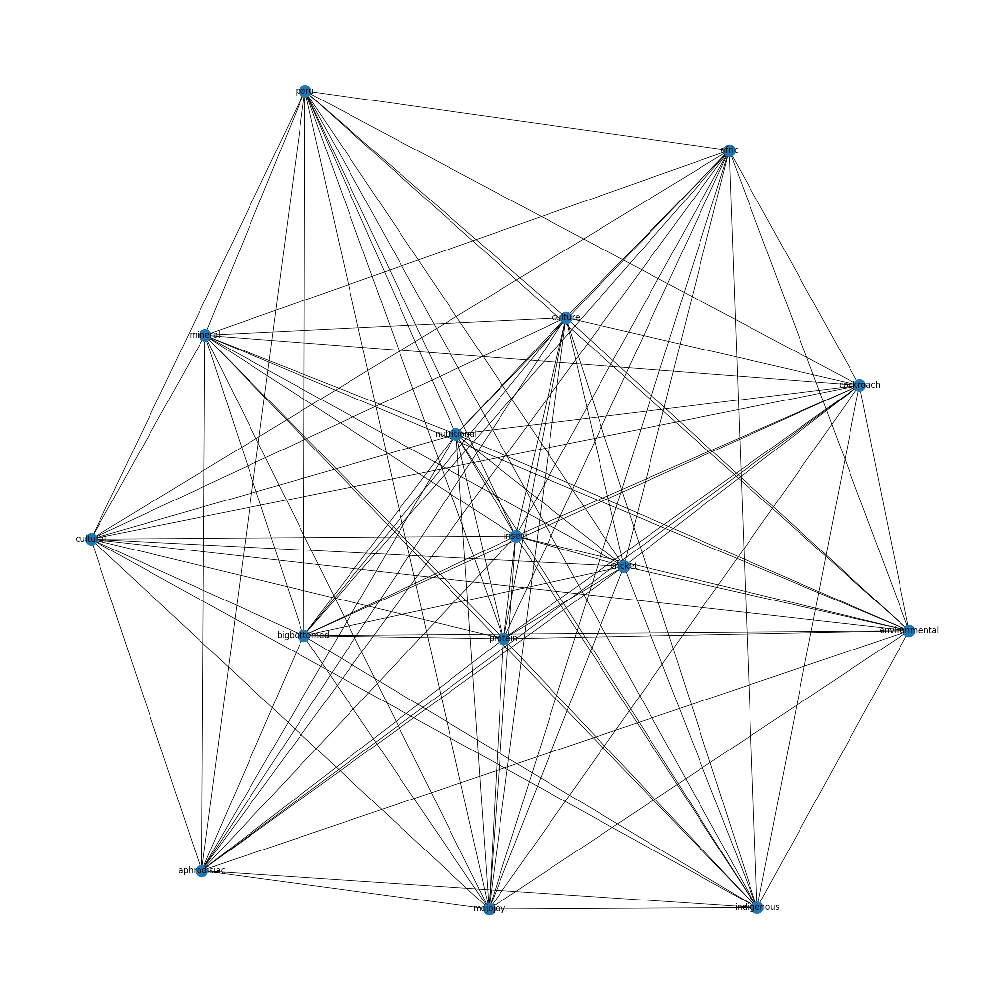

In [69]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','china','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','cheaper','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','crosscultural','gastronomy','gastronomic','footprint','sustainable','taboo','edibility','insectbased','entomophagy','folk','balance','sustainability','colombia','nutrient','familiarity','healthy','curious','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','mexico','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','multivitamin','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','russia','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','iron','critter','cricketbased','zinc','rival','vitamins','snail','omega'
]
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
p5c = p5cons.apply(clean_text)
network5 = create_red(p5c, 'network5')

In [70]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network5)
dfx

,Node,Total Co-occurrence Frequency
9,insect,19210
14,protein,10320
12,nutritional,7366
4,cricket,5980
6,culture,3766
2,bigbottomed,3252
10,mineral,2200
5,cultural,1932
3,cockroach,1662
11,mojojoy,1662


In [71]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#5N

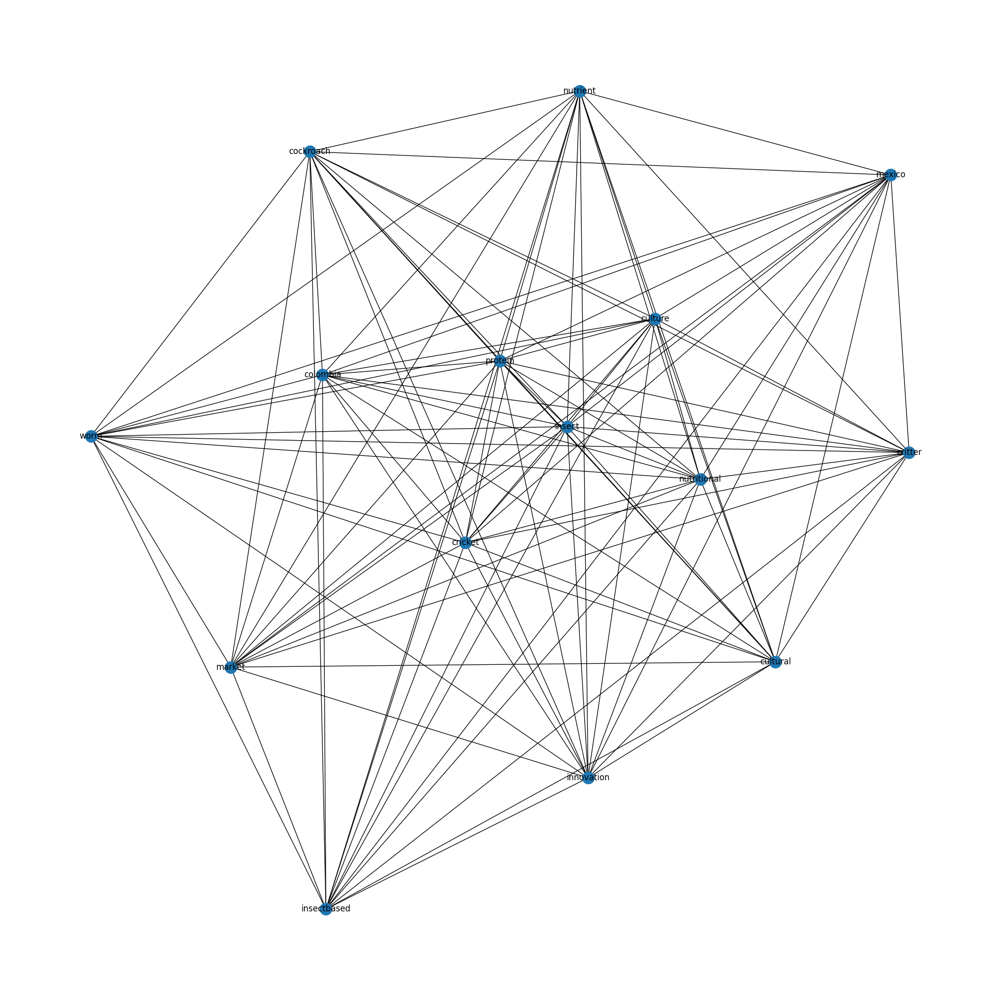

In [72]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 1:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','ecology','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','healthy','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder','ecologically']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p5n = p5noncons.apply(clean_text)
network5n = create_red(p5n, 'network5')

In [73]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network5n)
dfx

,Node,Total Co-occurrence Frequency
7,insect,13871
13,protein,5564
2,cricket,5184
12,nutritional,3164
5,culture,2951
1,colombia,2736
4,cultural,1856
0,cockroach,1631
3,critter,1631
6,innovation,1404


In [74]:
# Texto proporcionado
texto = """
harmful	232
22	researcher
resourceintensive
	powder
	ecologically
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'harmful','researcher','resourceintensive','powder','ecologically'


In [75]:
#plt.title('Question 5: Knowledge about insect-based food consumption all over the world - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P5.png', dpi=300, bbox_inches='tight')
#plt.show()

In [76]:
#print("p5c:", p5c.nodes())
#print("p5n:", p5n.nodes())


#6-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA

In [77]:
p6cons= compared['8-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA-CONS'].astype(str)
p6noncons= compared['8-KNOWLEDGE OF INSECT CONSUMPTION IN COLOMBIA-NONCONS'].astype(str)

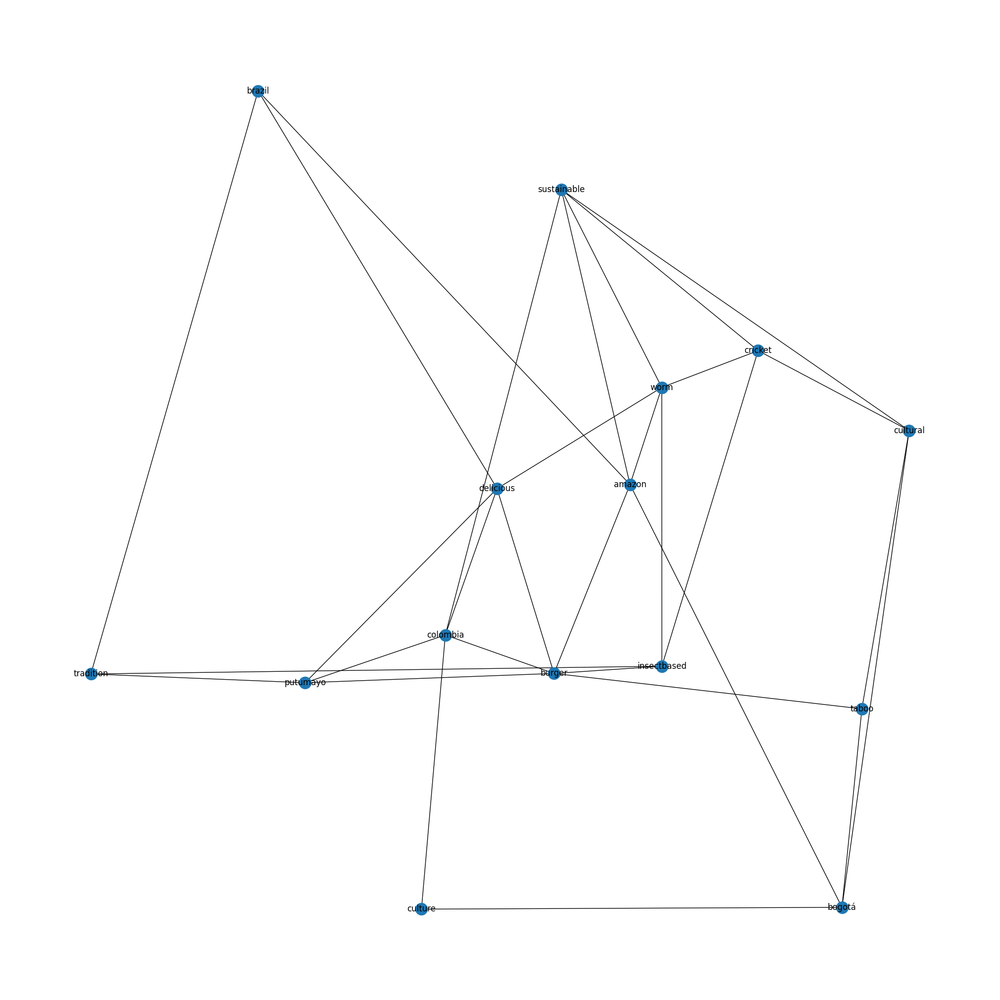

In [78]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.25:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','health','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','healthy','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder',
'restaurant','slowly','colombi','experiment','browncolored','presence','frying','largely','looked','recognized','promote','wellknown','terrible','prepare','processed','market','maní','puerto','culturally','remember','grape','remote','sell','eastern','strong','pasto','primarily','plain','accepted','changed','appearance','breaking','shine','shadow','impression','sent','industrial','colony','judging','lasting','later','left','leguizamo','sena','appetite','select','mainstream','highend','mention','method','recently','salt','mother','near','niche','restricted','opinion','pas','called','brightest','school','pale','sorry','thick','work','visually','equally','unexplored','sporadic','extensive','favorite','felt','first','forefront','costly','blood','happens','appealing','comparison','star','television','reference','asís','resistant','serious','welldeveloped','reputation','replaced','additional','blessed','wider','applied','acquired','reluctance','regulating','regulate','beginning','almost','uniqueness','thank','taking','aguazul','sector','season','along','blessing','salting','tree','stronghold','route','underrated','roasting','roast','revolution','cropping','protein','fullyfledged','hesitated','helping','haute','hailing','guaviare','grilling','grilled','grandma','goto','generates','generated','convincing','iceberg','fond','face','exists','evolves','elicits','creep','earlier','distribute','definitely','dash','hint','incredible','promotion','omit','promoting','border','pride','presentation','popularity','brown','persists','cusp','order','opening','nope','indulges','nevertheless','municipality','monserrate','mistaken','mask','centered','cesar','majority','mainly','achieving','lingering','yopal','colombian'	]
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p6c = p6cons.apply(clean_text)
network6 = create_red(p6c, 'network6')

In [79]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network6)
dfx

,Node,Total Co-occurrence Frequency
14,worm,1900
4,colombia,1200
5,cricket,1000
0,amazon,950
8,delicious,800
3,burger,712
6,cultural,270
10,putumayo,216
7,culture,208
9,insectbased,144


In [80]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#6N

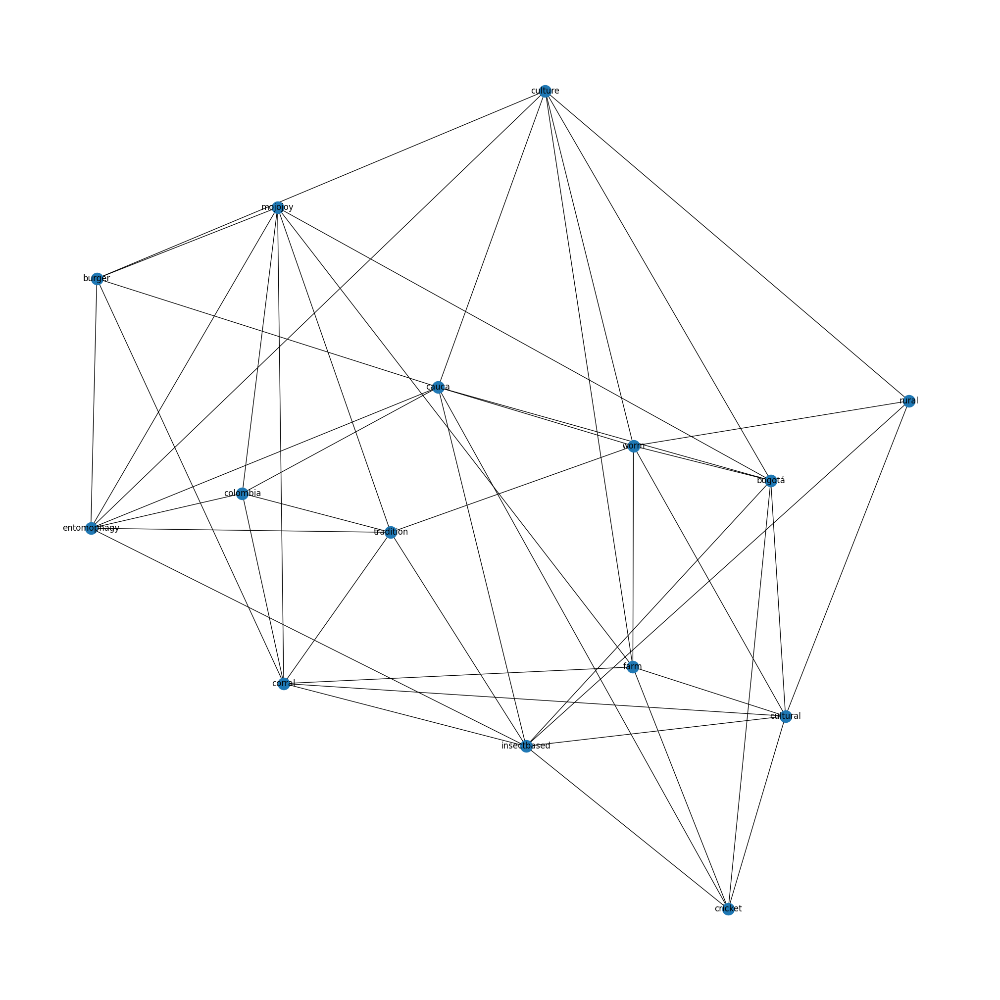

In [81]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.4:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','personally','enjoy','someone','although','open','notion','reminder','rooted','long','heard','always','probably','considered','prompt','mind','recognize','recognizing','reflect','region','particularly','important','benefit','appreciate','diverse','based','shared','story','approach','grew','leading','distinct','else','imperative','empathy','hygienic','history','encourages','fried','essential','fish','fly','heart','learned','acknowledge','population','likely','maintain','willing','welfare','vast','various','truth','toward','survival','sure','share','shaped','serf','scarce','safety','result','respectable','resourcefulness','resilience','reminded','prime','preconceived','develop','palatable','nourish','nothing','must','disgust','zone','admiration','chance','conclusion','crucial','attitude','affect','courage','compared','continues','celebrate','profoundly','bite','challenging','pushing','rapid','rapidly','reality','realizing','biting','receives','relativism','relative','bug','reconsidering','reevaluate','cherished','reevaluating','broaden','remain','regarded','book','regular','reject','prioritized','deemed','presented','overcome','normalcy','notable','colored','nourishes','nourishment','number','observe','obtaining','offlimits','climate','openminded','outlook','overlooking','prepared','claim','paramount','partake','circumstance','path','chosen','picture','piqued','choosing','positive','possibility','repulsive','preconception','reminding','bigger','argument','apprehension','surviving','task','teach','territory','theme','thrive','appears','allows','align','transcending','unexpected','unimaginable','universally','unsettling','varied','adventurer','vary','admit','ventured','wallet','adaptability','wellcooked','wholeheartedly','adapt','window','withhold','worldview','worldwide','surprisingly','support','resonate','suitable','newfound','bias','respectful','best','reveals','being','routine','safe','safely','behavior','sample','became','science','beauty','awaits','attention','shrimp','social','aspire','sound','squeamish','squeamishness','stark','started','step','aside','strain','striving','struck','next','navigate','negatively','enjoying','enthusiasm','entirely','criticism','crab','ethical','everexpanding','evident','evolving','exchange','experiencing','experimenting','exploring','expressing','extend','eyeopening','farmed','fascination','feeling','fiction','finding','fluid','costeffective','convince','force','foreign','frequent','fresh','enjoys','criticize','frontier','critique','defines','delightful','delved','dense','depletion','description','despite','deem','differ','decline','disgusting','decent','dare','cultivation','dramatically','easier','cultivate','efficiency','efficient','elicit','elsewhere','embraced','emerges','crossed','emphasize','contrast','full','navigating','inherent','confess','inspired','interaction','intertwined','intrigued','introduced','judgment','large','completely','lifestyle','compelling','logic','logical','comparing','malleable','marked','marvel','mechanism','merely','microcosm','compare','mixed','modern','movie','comfortable','muster','mustered','narrative','deeper','inherently','ingenuity','gaining','informs','garnered','genuinely','globalization','globalized','grasshopper','hamburger','continue','contemplating','constantly','highlighting','highly','considers','honestly','honoring','horizon','humbling','humility','hygiene','consciously','ignored','act','immense','connecting','confront','impose','including','incorporate','increasing','increasingly','immed','curiosity','nutrition','gastronomy','gastronomic','footprint','familiarity','relationship','related','regional','recognition','deeply','deal','realm','realize','hear','reaction','rational','rather','discovery','posed','everyday','portal','outsider','ordinary','embodiment','embody','onto','encounter','offense','occurs','engendering','nutritious','enlightening','enticing','novel','nostalgia','normalization','everevolving','overarching','place','point','pof','pleasantly','disposition','distinction','distinguish','planet','divide','eccentricity','driven','dynamic','eagerly','perceive','ease','passed','particular','ability','focus','le','landscape','foster','found','foundation','judge','journey','framed','free','located','farming','lower','mentioned','name','mutual','multifaceted','much','evolve','mirror','exemplifies','memory','fair','meateater','expansion','meal','express','matures','factor','maintaining','it','intriguingly','nature','intriguing','globe','inclination','going','importance','implication','grand','grapple','greater','grou','group','growing','hold','guided','handle','hesitation','head','healthier','given','indeed','influenced','integrating','intricately','intricacy','interwoven','intertwines','intersection','intergenerational','fusion','integrated','integral','acceptability','insecteating','futureoriented','futuristic','natural','need','reminiscent','discussion','delectable','delicacy','pwith','delicate','delve','desire','propels','determining','production','development','dialogue','dichotomy','difference','dinner','pragmatic','discourse','powerful','quirk','defy','range','daunting','remind','remains','relish','earth','contain','eaten','determines','bible','dessert','beyond','fulfill','appear','appeal','conventional','behind','exact','becoming','extends','fact','choose','back','exposure','familiar','challenge','coast','certainly','dislike','fiber','fine','comfort','functionality','baptist','amount','grown','adventure','crazy','daily','creature','greatest','bucaramanga','adding','agree','grows','emerge','embracing','element','embrace','accessible','ethos','affecting','boundary','debate','cooking','give','especially','getting','boyacá','cooky','couple','bridge','broader','change','center','celebration','cater','stood','capturing','stuff','spirit','steward','stretch','stand','carry','heat','complexity','changing','responsibility','security','scarcity','core','rollercoaster','country','rise','rich','response','seemingly','cringe','resonates','resistance','reservation','requires','repulsion','repugnant','conviction','converge','chowing','concept','solution','clarification','societal','snack','coming','commonplace','surprise','significantly','contribute','significant','connect','showcase','shot','connection','continuity','sentiment','supplanting','text','surprised','viewing','amazing','amid','viable','venturing','venture','varying','ancestral','valuable','unraveling','appeared','unknown','appetizing','appreciated','understanding','appreciation','allowing','viewpoint','captivating','aligns','yeah','acknowledging','wrap','adapting','wonder','without','address','winwin','willingness','wild','wield','affinity','agricultural','akin','alien','underscoring','underlying','underline','underlies','tied','thrives','threat','better','thinking','bewildering','testament','test','tends','board','table','sustenance','become','bat','touching','around','unconventional','uncharted','unappealing','ultimately','architect','arises','array','towards','translation','transformation','transform','associated','aversion','awareness','realization','render','invite','livestock','feel','level','lesson','flavor','learning','like','might','certain','dont','eating','people','consumption','thing','think','find','understand','different','strange','ant','something','part','culinary','love','taste','peanut','consume','good','would','others','santander','normal','belief','know','even','believe','preference','whether','impact','play','bottomed','big','role','pantry','beef','context','pork','interesting','depends','aspect','well','alternative','dietary','upbringing','society','maybe','consumed','unpleasant','individual','considering','humanity','experience','often','consuming','come','future','many','make','chicken','content','norm','world','topic','diet','type','cuisine','opportunity','personal','process','community','shape','custom','offer','went','crop','seem','could','area','spicy','background','animal','becomes','tapestry','still','exploration','another','childhood','choice','issue','kore','example','beneficial','unusual','lead','influence','tried','guess','habit','high','japanese','generation','rare','perspective','access','life','trait','provide','bag','problem','developed','source','resource','child','variety','environment','used','explore','similar','meat','common','potato','every','option','bought','never','everyone','chinese','pivotal','imagine','distinctive','great','dish','known','grow','perception','however','easily','form','exposed','lack','global','hinge','look','fascinating','palate','lens','instance','consideration','right','stomach','also','seems','seen','sense','video','shaping','though','resort','consider','specific','specie','unique','assimilate','concern','chunchullo','trying','respect','within','prospect','help','practice','surrounding','balanced','way','across','additionally','take','time','acceptable','depending','intricate','last','interplay','thought','traced','three','totally','john','tolerate','trend','potential','underscore','initially','year','hesitant','wrong','whole','welcome','honey','watch','husband','idea','identity','visited','view','impossible','vicente','incorporated','value','unfamiliar','information','ingrained','inconvenience','matter','terrified','okay','openness','seeing','salted','replacing','replace','regarding','peculiar','reason','really','person','raised','question','quantity','purpose','plate','property','promising','pleasant','product','prejudice','obtain','nuanced','term','shocking','limited','taught','locust','tasty','made','study','mean','stem','special','socorro','mostly','myriad','smaller','small','skin','skeptical','since','normalize','significance','relativity','young','anything','frequently','early','betulia','evoke','appropriate','lauded','gamechanger','insecteating','gungho','guy','innate','initiative','ingredient','indulge','hard','hel','hidden','increasingly','incorporating','highlight','highly','includes','impressive','important','honest','image','illness','grounded','grew','gastronomic','great','larger','largebottomed','gathered','general','generally','getting','kind','kicker','japanese','invaluable','intrinsic','go','intricate','goody','interplay','interesting','interest','integration','integral','expert','nourishing','remedy','delve','deal','debate','deep','deeply','deeprooted','delf','progress','program','delicacy','prized','nourishment','prevalent','prevalence','pretty','delving','depicting','dining','dinner','discovered','pot','punch','daredevil','daily','custom','cool','corner','count','cousin','regular','reflecting','refer','recognize','crossed','crucially','crunch','really','honesty','rarely','rare','range','raising','radical','quirky','distant','distinctive','plethora','overview','endures','outstanding','others','engagement','onto','enhance','onecountry','enthusiasm','offputting','enturous','oddity','occur','everevolving','every','everything','nutrientdense','exceed','exhaustive','novel','overcome','emphasize','disturbing','palatable','plate','drawback','piqued','piece','phenomenon','drink','driving','personally','drop','persist','edible','pbalance','educated','past','efficient','either','elucidation','partaking','embraced','abundance','requires','reserved','somewhat','matter','someone','mentioned','menu','snack','sixlegged','positive','mind','showing','mounting','munching','security','scoop','science','rooted','right','notion','richness','nourished','resilient','numerous','horizon','delight','eater','free','anything','animal','frontier','exploration','call','gain','amount','glimpse','allure','gather','alive','become','case','giving','beef','foster','depth','arabi','bar','fatty','diversity','aversion','feed','family','fewer','finding','central','associated','carry','dismissed','asia','foodrelated','footprint','change','discovering','chef','climate','give','closer','curiosity','globe','habit','half','beverage','hesitation','consider','higher','creative','energy','boast','history','entrepreneur','access','acceptance','cooked','crunchy','everyday','conclusion','beneficial','africa','comparable','broaden','compared','compelling','component','grapple','fare','evolving','bugeating','squirm','societal','super','stand','brimming','buffet','stem','spicing','bottomed','substantial','solid','strange','specifically','captivating','captivate','captivatingly','south','something','summary','share','categorized','revealing','commonly','said','rudimentary','composition','comprehensive','confess','confined','reunion','common','resources','connection','context','resembles','continues','require','contributor','savor','claiming','smattering','shot','cent','sink','challenging','significant','side','showcasing','show','support','chowing','serving','cherished','seriously','chest','choice','seek','chow','boost','thought','bonanza','usual','adventure','affirm','warrant','want','vivid','vital','viewed','ailment','viable','veritable','alcoholic','ventured','veil','varying','americ','varies','analysis','and','advantage','address','weave','acquainted','yeah','would','worldwide','accustomed','wood','wonderful','wild','acknowledge','actually','additionally','add','wellversed','added','wellinformed','welldocumented','wellbeing','wellbalanced','adding','usually','appeal','bodybuilder','uninformed','toss','barrier','basic','time','throughout','three','remove','beckons','therefore','texture','testament','behind','beloved','tapestry','talking','talk','tale','table','big','totally','balanced','balance','type','unfamiliarity','undoubtedly','understand','underscoring','area','uncover','array','typically','assistance','aware','truly','trove','tried','astounding','attention','available','transition','transcended','renowned','rather','reminder','long','meet','flavor','meanwhile','folk','fondly','force','foreign','forget','longstanding','local','expect','loaded','form','linked','lineup','frequently','lift','less','legit','least','firmly','feeling','feature','feast','noting','noteworthy','expertise','notably','notable','normal','nonetheless','express','negative','extend','neck','extension','familiarity','mysterious','fan','munch','fantastic','modest','furthermore','food','like','source','might','know','even','knowledge','often','content','rich','region','world','offer','various','creature','essential','diet','consumed','acid','part','dont','people','meat','heard','traditional','limited','amino','resource','consume','contribute','example','tiny','aspect','idea','valuable','flour','production','practice','conventional','certain','come','concern','however','country','addressing','especially','insight','challenge','hold','experience','good','santander','fact','scarcity','farming','much','seem','also','consuming','embracing','deficiency','realm','provide','alleviate','global','high','addition','could','tequila','level','fried','specific','nutritious','adventurous','particularly','nutrition','different','concept','cuisine','indeed','curious','acting','novelty','including','america','considered','quality','avenue','subject','little','supplement','dietary','unconventional','tribe','term','learn','future','beetle','thing','think','latin','diverse','topic','larva','posse','include','eager','staple','profile','community','eating','nature','clay','make','value','grasshopper','single','many','unique','particular','place','play','incorporate','education','norm','overall','natural','landscape','gastronomy','known','gluten','found','livestock','making','intriguing','find','mere','dish','must','factor','option','need','never','exploring','explore','lack','note','excellent','innovative','evident','information','hesitate','incredibly','feel','human','significance','scientifically','relationship','remarkable','continue','understanding','contain','reveals','roasted','role','clear','verified','chinese','seems','seen','serve','chapulines','significantly','believe','take','beyond','sustenance','regarding','container','well','purpose','powerhouse','widespread','pressing','widely','across','probably','promise','whether','bug','crucial','way','touted','wide','wary','used','though','lead','initial','territory','variety','water','vary','impact','system','worth','sure','stop','step','look','looking','interested','toward','traction','knowing','underestimated','made','wealth','abundantly','uncharted','indi','jungle','twist','turning','land','unusual','weird','indepth','treasure','venturing','translation','wellrounded','intricacy','video','potentially','spectrum','participant','replace','relatively','related','reduced','reassuring','online','opportunity','rearing','pack','read','reach','purposes','sound','providing','pasta','promising','perception','personal','pest','pressure','planet','pound','popular','represent','quite','ground','easy','breed','packed','taken','sausage','exotic','adaptation','coloring','cochinilla','interestingly','demand','dedicated','interconnectedness','crispy','project','assortment','creativity','deny','sight','connoisseur','one','skewer','enthusiast','shortage','shift','selling','ancient','conversation','stick','gourmet','calcium','baked','symbolize','perfection','closing','necessity','turn','admire','powdered','perhaps','reducing','regard','regulatory','pin','remarkably','worked','redefine','reshape','passion','resourceefficient','pinpoint','power','pique','push','produce','profound','potency','responsible','projected','post','popularly','wondered','popping','prominent','witness','proteinpacked','pondering','played','precise','weight','wisdom','uncanny','ripple','store','straight','summon','superheroes','supermarket','untapped','underwent','surface','surge','sushi','undeniably','symbol','tantalize','technical','tell','tempted','terrain','thriving','tourist','undeniable','transformed','treat','vegan','stewardship','rumor','vegetable','rushing','savored','scale','scratched','served','turned','simple','size','skewered','snippet','sold','space','spark','vibrant','speaking','spice','stage','stagnant','stall','versatility','sparked','accompany','offering','contemplate','caused','century','chomping','chowdowns','circle','class','closely','compound','condiment','constitutes','crispyfried','nutty','crossroad','cultivating','day','digging','dimension','drawn','earthy','effect','emerged','encountered','catching','care','captured','bugeater','adhering','adjustment','advocate','agent','alike','among','anecdote','anyone','arose','astonishing','audacity','avoid','away','ballgame','believed','belonging','bigbottomed','bioactive','blend','brave','brim','bring','bud','endlessly','enjoyed','enough','inevitably','insectderived','insectinfused','intake','intensive','intrigue','introspection','jampacked','keep','knowledgeable','line','acutely','medicinal','medium','meeting','mental','minilivestock','modernity','moment','momentum','movement','nittygritty','nuance','nutritionally','ingenious','industry','enterprising','indulging','environmental','ethic','ever','exactly','except','exciting','exist','existence','exploitation','famous','fancy','floating','follow','friendly','fueled','grain','grasp','healing','heritage','hurdle','mark','harmful','researcher','resourceintensive','powder',
'restaurant','slowly','colombi','experiment','browncolored','presence','frying','largely','looked','recognized','promote','wellknown','terrible','prepare','processed','market','maní','puerto','culturally','remember','grape','remote','sell','eastern','strong','pasto','primarily','plain','accepted','changed','appearance','breaking','shine','shadow','impression','sent','industrial','colony','judging','lasting','later','left','leguizamo','sena','appetite','select','mainstream','highend','mention','method','recently','salt','mother','near','niche','restricted','opinion','pas','called','brightest','school','pale','sorry','thick','work','visually','equally','unexplored','sporadic','extensive','favorite','felt','first','forefront','costly','blood','happens','appealing','comparison','star','television','reference','asís','resistant','serious','welldeveloped','reputation','replaced','additional','blessed','wider','applied','acquired','reluctance','regulating','regulate','beginning','almost','uniqueness','thank','taking','aguazul','sector','season','along','blessing','salting','tree','stronghold','route','underrated','roasting','roast','revolution','cropping','protein','fullyfledged','hesitated','helping','haute','hailing','guaviare','grilling','grilled','grandma','goto','generates','generated','convincing','iceberg','fond','face','exists','evolves','elicits','creep','earlier','distribute','definitely','dash','hint','incredible','promotion','omit','promoting','border','pride','presentation','popularity','brown','persists','cusp','order','opening','nope','indulges','nevertheless','municipality','monserrate','mistaken','mask','centered','cesar','majority','mainly','achieving','lingering','yopal','chiza','chocó','department','commerce','scene','fastfood','referred','centralized','raise','north','apart','hotspot','plump','exported','grillos','festival','spanish','insectthemed','biological','layer','caught','chain','classification','city','occasional','night','nonconsumer','public','prompted','prominence','received','possibly','occurrence','please','party','passage','perform','personality','pizza','ready','rock','recipe','suggests','whisper','waiting','wait','variation','underground','ugly','trade','touch','suppose','summarize','signify','regularly','set','secret','salsa','safari','rockstars','nation','rite','revolves','reside','remaining','rely','network','insectlike','music','moreover','emergence','elude','diversifying','diversification','difficult','dicen','deserve','dared','critter','concrete','concert','antroasting','club','close','cinema','chip','capital','cangrejo','candidate','bugbased','beautiful','backdrop','exclusive','explored','explorer','inclusion','mexic','location','label','kinda','keen','join','investigate','instead','attend','indicating','import','export','humorously','host','home','headliner','gem','friend','foremost','farmtotable','farmfresh','exporting','alone','colombian']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:15]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p6n = p6noncons.apply(clean_text)
network6n = create_red(p6n, 'network6n')

In [82]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network6n)
dfx

,Node,Total Co-occurrence Frequency
13,tradition,495
14,worm,448
3,colombia,391
4,corral,204
10,insectbased,195
2,cauca,177
6,cultural,164
0,bogotá,144
8,entomophagy,144
9,farm,128


In [83]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [84]:
#plt.title('Question 6: Knowledge about insect-based food consumption in the colombian territory - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P6.png', dpi=300, bbox_inches='tight')
#plt.show()

In [85]:
#print("p6c:", p6c.nodes())
#print("p6n:", p6n.nodes())


#P7- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS

In [86]:
p7cons= compared['P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-CONS'].astype(str)
p7noncons= compared['P40- CHILDHOOD EXPERIENCES WITH PREFERRED FOODS-NONCONS'].astype(str)

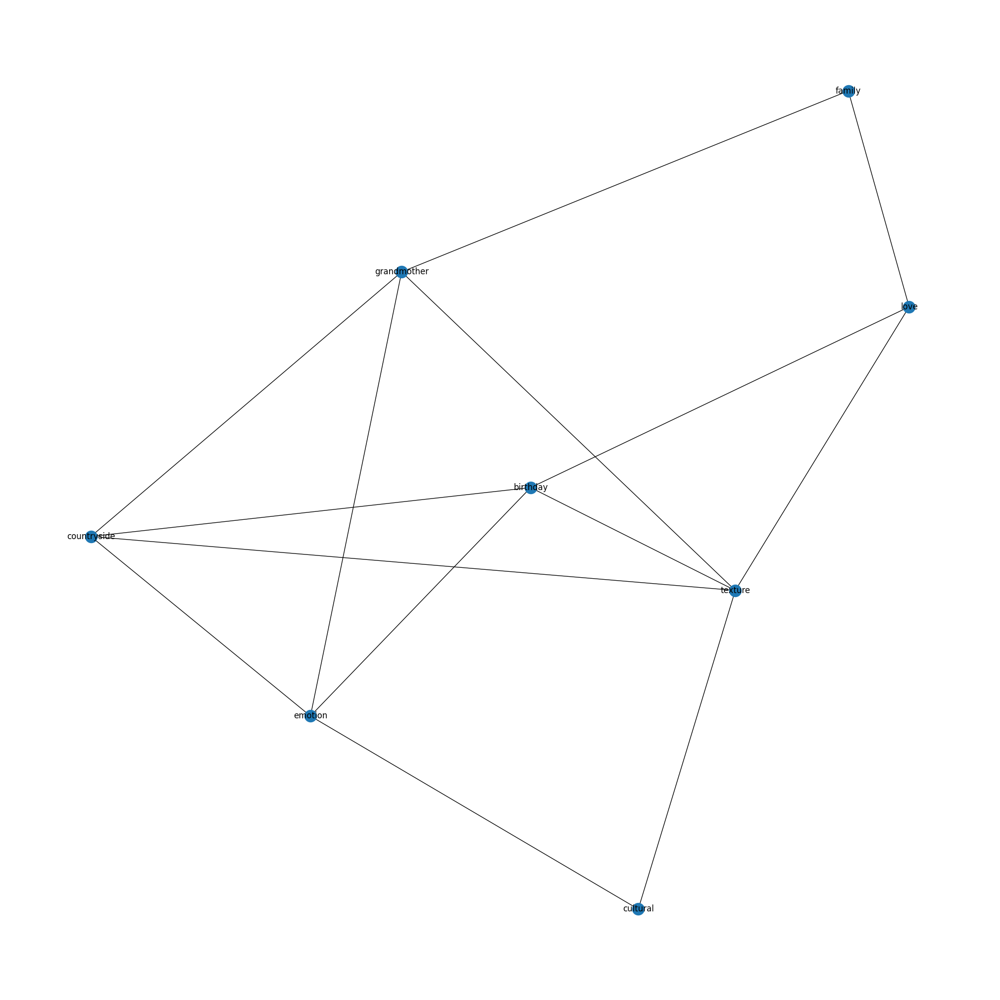

In [87]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.4:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['childhood'	,'reminds','familiarity','nostalgia','memory','special','barbecue','emotional','sweet','connection','grilled','ritual','sick','sweetness','teaching','child','thrill','happiness','testament','reward','relationship','identity','traditional','home','delicious','cream','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p7c = p7cons.apply(clean_text)
network7 = create_red(p7c, 'network7')

In [88]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network7)
dfx

,Node,Total Co-occurrence Frequency
6,love,200
7,texture,189
0,birthday,156
3,emotion,133
4,family,132
1,countryside,92
5,grandmother,90
2,cultural,84


In [89]:
# Texto proporcionado
texto = """
reminds	60
4	familiarity	36
8	nostalgia	28
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'reminds','familiarity','nostalgia'


#7N

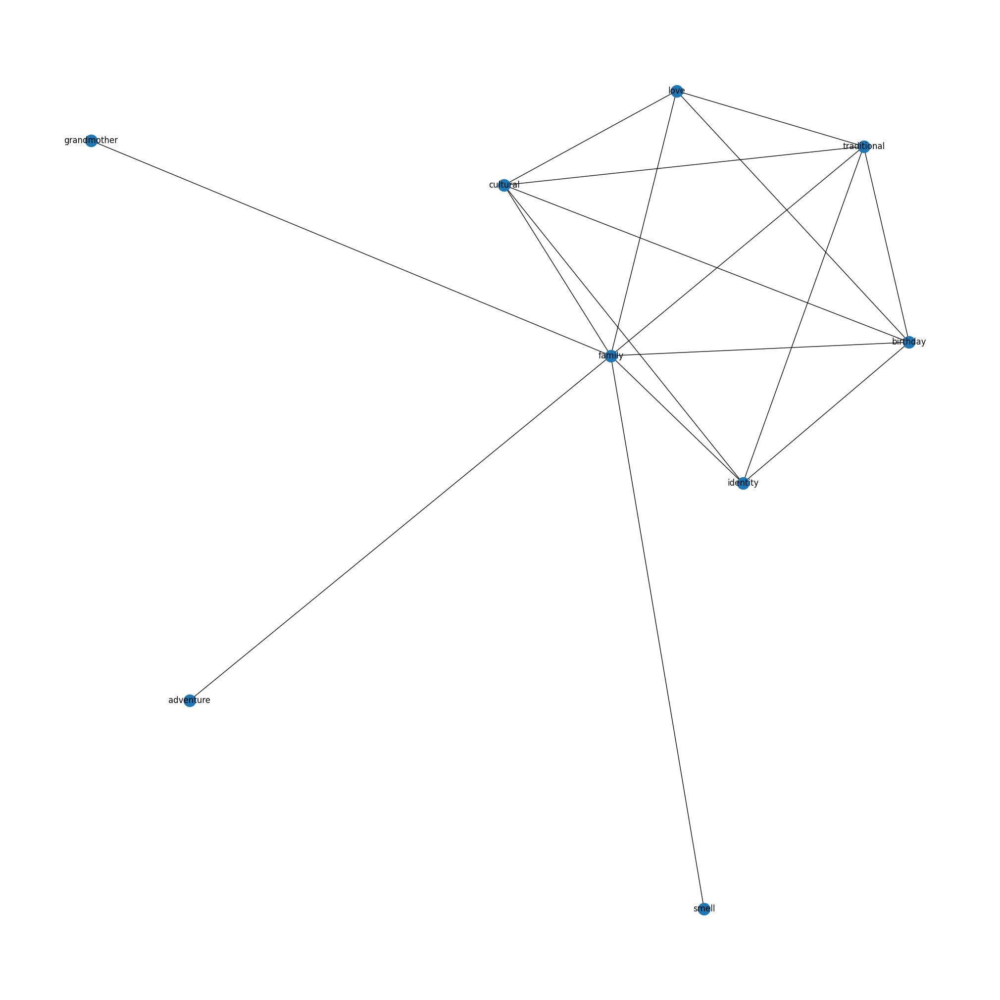

In [90]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.9:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['trip','texture','childhood','memory','emotion','sweet','choldhood', 'insectbased','insect','interconnectedness','emotional','contemplate','land','instills','constantly','consisted','intertwine','intertwined','intertwining','intriguingly','juxtaposition','labor','laden','yucca','reward','chocolate','special','tale','bean','mango','connection','since','present','paisa','little','child','specific','dietary','unconventional','bandeja','allure','adaptation','nonconsumer','enjoying','delicacy','choice','cream','freshly','cooked','link','conversation','influenced','option','sticker','similarly','arepas','aroma','today','impression','illuminate','theme','guide','groundwork','parent','fantastic','fallen','exploring','tuna','unfold','whole','diet','fond','sometimes','positive','smooth','possibility','ongoing','novel','produced','never','nature','realm','received','mainly','recipe','recurring','linking','saturday','intersection','integrating','delicious','able','cuajada','bring','avocado','create','concept','consuming','creating','ajiaco','barbecue','chef','corn','cornbased','chocolatinas','chicharrón','satisfying','capsule','receiving','came','scent','cafam','reflects','relationship','remains','reliance','sancochos','reminiscent','repertoire','reveal','brush','ritual','rolled','rural','recall','define','cast','potentially','painted','part','pea','permeated','pick','picture','pinpoint','point','cheesy','characterized','potency','potential','poured','rather','powerful','precious','change','presentday','pretty','chance','product','profile','proteinrich','provide','question','sent','sensory','several','serf','serving','arequipe','thought','throughout','tie','anything','topping','touchstone','traced','anchor','tree','almost','ultimately','uncharted','uncover','affinity','various','veggie','vein','venture','weave','whenever','window','winner','aromatic','testament','tendril','sound','setting','show','sibling','silky','bounty','born','sister','smelled','based','soothing','source','tangible','speaks','baker','badge','spell','spot','steadfast','stomach','strongly','available','symbolizing','association','outing','nowadays','openness','coladas','extends','familiar','crop','feel','feeling','fell','find','fixed','fluid','forming','framed','framework','countryside','funny','future','game','genesis','goodness','grilled','count','cornbread','hanging','hardly','heart','cue','explore','experienced','delve','dialogue','deeprooted','deeper','differ','driven','dynamic','earlier','effort','element','dairy','emphasizing','exotic','encapsulate','curiosity','enshrining','enticing','environment','envueltos','etched','everevolving','everpresent','evolution','evolving','heritage','highlight','histori','motif','connected','conjures','locally','conjure','lunchbox','mainstream','complex','maybe','melgar','completely','might','come','lifelong','navigate','need','needed','collective','collecting','norm','normal','nostalgia','collected','delightful','okay','connoisseur','leading','home','ingrained','honest','honor','however','hug','hunting','illustrating','importance','cool','incorporate','continues','infuses','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p7n = p7noncons.apply(clean_text)
network7n = create_red(p7n, 'network7n')

In [91]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network7n)
dfx

,Node,Total Co-occurrence Frequency
3,family,396
5,identity,135
6,love,135
1,birthday,102
2,cultural,102
8,traditional,102
0,adventure,18
4,grandmother,18
7,smell,18


In [92]:
# Texto proporcionado
texto = """
1	childhood	696
7	memory	209
3	emotion	108
8	sweet	84
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'childhood','memory','emotion','sweet'


In [93]:
#print("p7c:", p7c.nodes())
#print("p7n:", p7n.nodes())

In [94]:
#plt.title('Question 7: Childhood Experiences with Preferred Foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P7.png', dpi=300, bbox_inches='tight')
#plt.show()

#P8- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS

In [95]:
p8cons= compared['P50- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS\n-CONS'].astype(str)
p8noncons= compared['P50- CHILDHOOD EXPERIENCES WITH NON-PREFERRED FOODS\n – NONCONS'].astype(str)

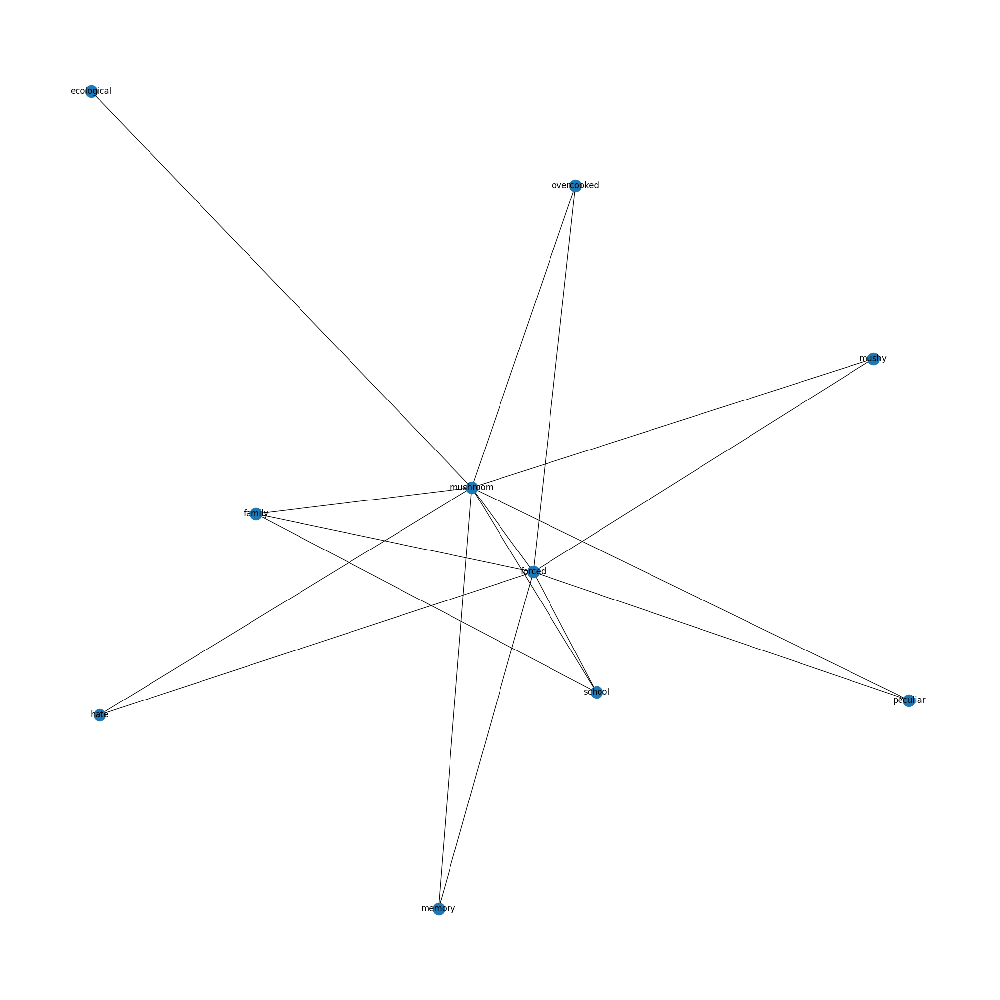

In [96]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['could','another','given','egg','problem','self','cabbage','despised','disliked','drink','matured','accept','repetitive','consume','help','okra','hide','juice','nemesis','left','limited','everyone','drinking','brussels','tried','anyone','tolerate','sprout','picky','peach','odds','piece','oncedespised','older','uninspiring','undertone','utterly','offputting','pile','overcome','nutritious','obligated','practically','merit','mind','minicabbages','muscle','worse','willingly','wellcooked','welcomed','napkin','way','newfound','ventured','normally','notice','pleasant','umami','precisely','strategically','resistance','result','revelation','richness','sauce','sautéed','seat','stubborn','secretly','stopped','side','simply','resembled','surprise','understand','reached','slyly','properly','pumpkin','typical','push','quickly','realized','terrible','realizing','reason','turnoff','reluctance','reluctantly','reminds','lasting','mashua','cringe','coaxing','cold','comprehend','consequence','consistency','convince','cosidos','cost','cuchuco','distribute','cultural','cundinamarca','cycle','decided','destined','develop','directly','discreetly','called','brother','boyacenses','bothered','adding','addition','agree','alone','amount','annoyed','anymore','appealing','appeared','appetizing','arrived','avoid','baffled','bane','beetroot','beneath','bland','distinct','doubt','insist','hardboiled','heat','herb','hope','hoping','huge','imported','issue','kiwi','actually','later','laugh','living','love','major','mamoncillo','happened','hand','green','grandmother','either','enough','everchanging','evolved','exciting','exhausted','existence','experiment','facility','fan','feed','fold','forever','fungi','garlic','gelatinous','gooey','younger','interconnectedness','contemplate','land','instills','constantly','consisted','intertwine','intertwined','intertwining','intriguingly','juxtaposition','labor','laden','yucca','reward','chocolate','special','tale','bean','mango','connection','since','present','paisa','little','child','specific','dietary','unconventional','bandeja','allure','adaptation','nonconsumer','enjoying','delicacy','choice','cream','freshly','cooked','link','conversation','influenced','option','sticker','similarly','arepas','aroma','today','impression','illuminate','theme','guide','groundwork','parent','fantastic','fallen','exploring','tuna','unfold','whole','diet','fond','sometimes','positive','smooth','possibility','ongoing','novel','produced','never','nature','realm','received','mainly','recipe','recurring','linking','saturday','intersection','integrating','delicious','able','cuajada','bring','avocado','create','concept','consuming','creating','ajiaco','barbecue','chef','corn','cornbased','chocolatinas','chicharrón','satisfying','capsule','receiving','came','scent','cafam','reflects','relationship','remains','reliance','sancochos','reminiscent','repertoire','reveal','brush','ritual','rolled','rural','recall','define','cast','potentially','painted','part','pea','permeated','pick','picture','pinpoint','point','cheesy','characterized','potency','potential','poured','rather','powerful','precious','change','presentday','pretty','chance','product','profile','proteinrich','provide','question','sent','sensory','several','serf','serving','arequipe','thought','throughout','tie','anything','topping','touchstone','traced','anchor','tree','almost','ultimately','uncharted','uncover','affinity','various','veggie','vein','venture','weave','whenever','window','winner','aromatic','testament','tendril','sound','setting','show','sibling','silky','bounty','born','sister','smelled','based','soothing','source','tangible','speaks','baker','badge','spell','spot','steadfast','stomach','strongly','available','symbolizing','association','outing','nowadays','openness','coladas','extends','familiar','crop','feel','feeling','fell','find','fixed','fluid','forming','framed','framework','countryside','funny','future','game','genesis','goodness','grilled','count','cornbread','hanging','hardly','heart','cue','explore','experienced','delve','dialogue','deeprooted','deeper','differ','driven','dynamic','earlier','effort','element','dairy','emphasizing','exotic','encapsulate','curiosity','enshrining','enticing','environment','envueltos','etched','everevolving','everpresent','evolution','evolving','heritage','highlight','histori','motif','connected','conjures','locally','conjure','lunchbox','mainstream','complex','maybe','melgar','completely','might','come','lifelong','navigate','need','needed','collective','collecting','norm','normal','nostalgia','collected','delightful','okay','connoisseur','leading','home','ingrained','honest','honor','however','hug','hunting','illustrating','importance','cool','incorporate','continues','infuses','tinajo','tender','tell','technique','togetherness','token','told','tableau','took','symposium','symphony','symbolic','touch','towards','trying','showcase','sharing','upon','right','rich','usually','utilitari','variety','revolve','reveals','rested','rest','resilience','reservoir','reserved','repository','reminding','remind','vivid','remain','rock','universality','unique','sense','turn','turned','shaped','unadulterated','shape','serve','sentimentality','undercurrent','seemingly','root','seemed','seasoning','sculpts','scarcity','satisfies','santander','unfamiliar','unifying','academic','joyous','passed','cooking','dance','current','curd','crystallize','crunch','creates','creamy','creambased','craved','coveted','cornerstone','contributed','dedication','contribute','contrary','continuity','context','constant','compass','companion','communion','communal','common','commemorate','danced','defined','comfort','eclipse','entity','ensuring','enriched','enjoyed','enjoyable','encounter','encapsulated','emphasize','emblematic','embedded','elaborate','eater','depends','earliest','drawn','dough','diverse','distaste','dislike','discern','dimension','difficulty','devoted','dessert','comforting','combination','particularly','armadillo','belonging','bell','believe','becoming','baked','backdrop','aversion','attribute','associated','associate','asked','appreciation','besides','appearance','anticipation','anchored','amplifies','amalgamation','adult','adorned','additional','activity','across','accompanied','beloved','better','color','bucaramanga','closely','clarified','chunky','choose','cheese','chapter','channel','challenge','cared','capacity','canvas','brushstrokes','bind','brushstroke','brought','brings','brimming','box','bountiful','boundless','boundary','bonding','boggy','body','entwined','essence','everyday','isolated','lettuce','learning','le','layer','larger','landscape','lady','know','knit','jubilation','access','interwoven','linked','internalize','instead','instance','insight','innocence','inner','infuse','infrequency','informed','indulgence','indelible','liking','lived','everything','moist','particular','partaking','palate','ordinary','opportunity','offering','occasion','nourish','notion','none','molding','milk','local','metamorphose','mere','melting','medium','meaning','mattered','malleability','making','lunch','look','locale','imprinted','important','impact','filling','fresh','frequently','frequency','found','forward','forged','forge','force','fluffy','fleeting','first','festivity','imbues','featured','fascinating','farm','exuberance','expressed','exploration','exchanged','evolves','evolve','evoke','evident','fruit','furthermore','fusion','generation','illustrate','idea','hunger','humble','hue','house','homemade','hold','heightened','healthy','hard','hamburger','gustatory','guiding','growth','grow','graced','go','gettogether','getting','get','gesture','geographical','youth','food','like','experience','rice','taste','dish','also','meat','made','would','always','meal','flavor','used','something','cake','even','shared','soup','culinary','prepared','liked','familial','really','becomes','time','year','type','often','dont','story','certain','pasta','think','interplay','journey','life','preference','within','example','enjoy','delight','cherished','tapestry','culture','complexity','affection','woven','thing','moment','gathering','vegetable','gallina','became','become','good','recollection','sancocho','favorite','roasted','cooky','narrative','friend','ingredient','physical','savored','one','personal','paint','day','sustenance','foster','mirror','past','pollo','many','stood','eaten','started','embodiment','preferred','influence','profound','kind','every','young','world','together','chicken','vessel','consumed','arroz','threemilk','carry','learned','form','weekend','shaping','underscore','fondness','well','formative','fish','served','felt','prepare','thread','fabric','around','bud','bridge','long','whether','care','significance','white','make','simplest','appreciate','unexpected','rooted','laughter','pudding','remember','hunted','hunt','banana','history','rarity','resonance','resonate','response','guava','growing','grew','grateful','bite','intimate','bond','give','intricate','cook','gelatin','gave','back','gastronomic','especially','said','matter','loved','plain','achievement','mosaic','deeply','early','mother','transcends','much','taught','tradition','sunday','tasty','surroundings','town','wonder','discovery','wild','daily','different','developed','peto','take','nourishment','table','novelty','commonly','conduit','conclusion','adulthood','consumption','treat','animal','apart','continue','celebration','embrace','emerges','anecdote','plate','economic','papaya','plantain','echo','eating','rabbit','regular','quite','reflecting','wanted','warmth','people','perhaps','pepper','wrapped','raised','peppered','reflect','perception','warm','rarely','recognize','rare','power','quick','week','potato','practical','practice','portal','pon','willingness','predilection','related','poignant','prefer','pleasure','preparation','whatever','went','without','wellrounded','preparing','property','protein','provides','pureed','purpose','putumayo','pizza','pin','pvery','pwith','regularly','ripe','voyage','transformed','transmission','staple','stand','squirrel','transporting','spinach','spent','travel','traveled','soul','sou','solution','solely','social','tropical','soaked','small','simple','similar','stem','still','relished','transcend','though','three','texture','soft','slimy','liver','earthy','smell','childhood','strong']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p8c = p8cons.apply(clean_text)
network8 = create_red(p8c, 'network8')

In [97]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network8)
dfx

,Node,Total Co-occurrence Frequency
2,forced,180
5,mushroom,168
9,school,60
1,family,42
3,hate,18
4,memory,18
6,mushy,18
7,overcooked,18
8,peculiar,18
0,ecological,8


In [98]:
# Texto proporcionado
texto = """
8	smell	44
0	childhood	36
9	strong	34
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'smell','childhood','strong'


#8N

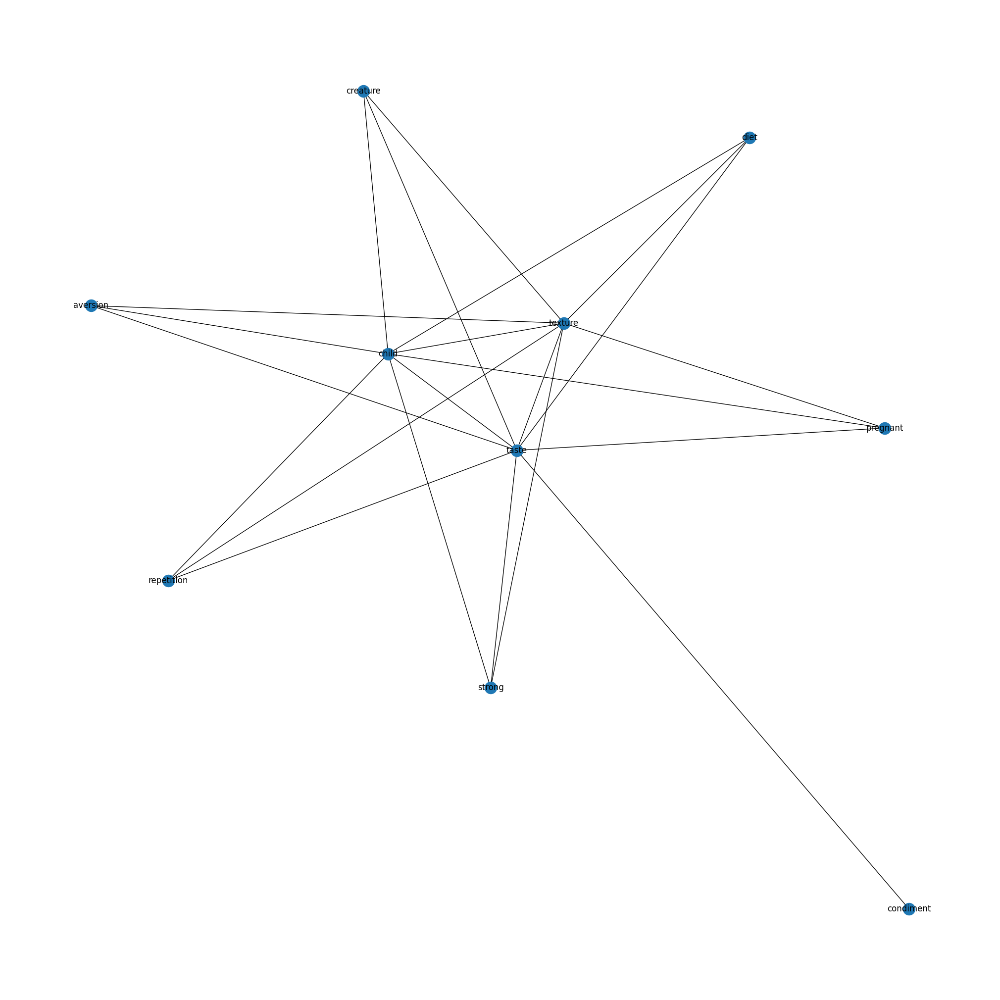

In [99]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.9:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['food','pumpkin','experience','vegetable','smell','meat','like','made','used','cabbage','still','avoid','dislike','dont','developed','certain','since','soup','never','enjoy','mazorca','added','seasoning','sauce','pizza','ground','flavor','much','also','arracacha','time','although','nutritious','people','presence','prepare','wall','preferred','preference','possible','point','persists','perhaps','would','pea','pdessert','pvomiting','pasta','young','younger','particularly','pand','nutritional','older','pata','relative','reason','sick','started','stand','taken','sometimes','taught','someone','softboiled','thought','tiny','shrimplike','stick','tolerable','tomato','served','secretly','tried','unappealing','salcedo','unpleasant','removed','reminds','value','remember','similarly','acquire','nauseous','mother','consuming','cooked','corn','current','differently','distaste','eating','egg','ended','environment','especially','even','eventually','every','example','consumed','considered','bean','additionally','animal','appetizing','asked','associate','avoided','bought','chicken','broth','came','car','changua','chea','cherry','farm','first','foot','living','kid','knorr','learned','left','little','lived','long','jelly','maggi','mandarin','meal','meant','might','mistook','juice','insect','force','guatila','found','frequently','fundamental','gelatina','grew','habichuelas','initially','hamburger','hear','however','impression','included','influenced','yucca']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p8n = p8noncons.apply(clean_text)
network8n = create_red(p8n, 'network8n')

In [100]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network8n)
dfx

,Node,Total Co-occurrence Frequency
8,taste,140
1,child,88
9,texture,69
0,aversion,28
3,creature,28
4,diet,28
5,pregnant,28
6,repetition,28
7,strong,28
2,condiment,7


In [101]:
# Texto proporcionado
texto = """
taste	175
3	food	120
8	texture	96
0	child	88
5	pumpkin	84
2	experience	80
9	vegetable	75
6	smell	50
4	meat	48
"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'taste','food','texture','child','pumpkin','experience','vegetable','smell','meat'


In [102]:
#print("p8c:", p8c.nodes())
#print("p8n:", p8n.nodes())

In [103]:
#plt.title('Question 8: Childhood experiences with disliked foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P9.png', dpi=300, bbox_inches='tight')
#plt.show()

#P9-RECENT EXPERIENCES WITH PREFERRED FOODS

In [104]:
p9cons= compared['P41-RECENT EXPERIENCES WITH PREFERRED FOODS-CONS'].astype(str)
p9noncons= compared['P41-RECENT EXPERIENCES WITH PREFERRED FOODS-NONCONS'].astype(str)

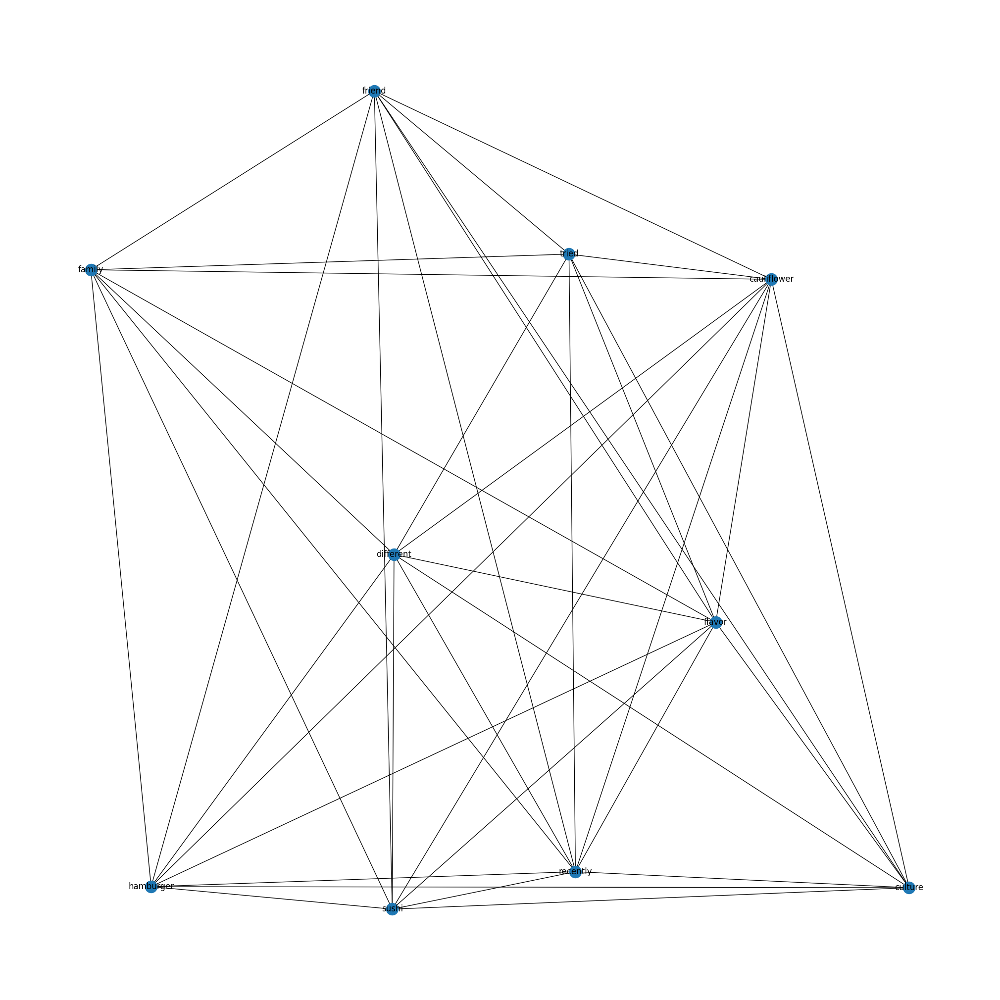

In [105]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['lifestyle','thing','food','like','differently','much','really','experience','started','dont','delicious','would','example','think','something','prepare','place','year','barley','liked','also','another','well','little','liking','diet','type','trying','small','moment','everything','impressed','many','particular','good','change','usually','cook','avocado','used','tomato','pepper','perception','nut','people','pea','trauma','pasta','trendy','pa','pistachio','order','tri','night','thanks','must','turkish','turn','milk','menu','mediumrare','typical','went','meal','maybe','within','never','pleasant','smelled','taste','soak','social','since','shrimp','setting','seems','sauce','love','russi','rice','restaurant','spinach','starting','representative','powdered','remember','regular','recipe','tasted','reason','tasting','pto','presentation','prepared','tatacoa','taught','preparation','made','added','looked','culinary','cholao','compacted','consume','cooked','country','cousin','cream','currently','look','decided','deliciously','desert','develo','developed','eaten','eating','egg','cheese','changed','challenge','celebratory','almost','anything','apart','appetite','arab','bean','bechamel','becoming','besides','birthday','bread','broccoli','buffet','cali','carbohydrate','celebration','employee','enjoy','enjoyable','great','group','health','helped','hungry','juicier','last','late','lately','almond','legume','lentil','lettuce','lived','living','location','grew','given','enjoyed','geographical','enjoying','especially','experienced','experiencing','exploring','exquisite','extremely','feel','fell','find','fine','first','fish','forced','found','framework','gastronomic','learn']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p9c = p9cons.apply(clean_text)
network9 = create_red(p9c, 'network9')

In [106]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network9)
dfx

,Node,Total Co-occurrence Frequency
9,tried,198
2,different,160
8,sushi,150
7,recently,144
0,cauliflower,111
4,flavor,111
5,friend,96
6,hamburger,84
1,culture,72
3,family,72


In [107]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

#9N

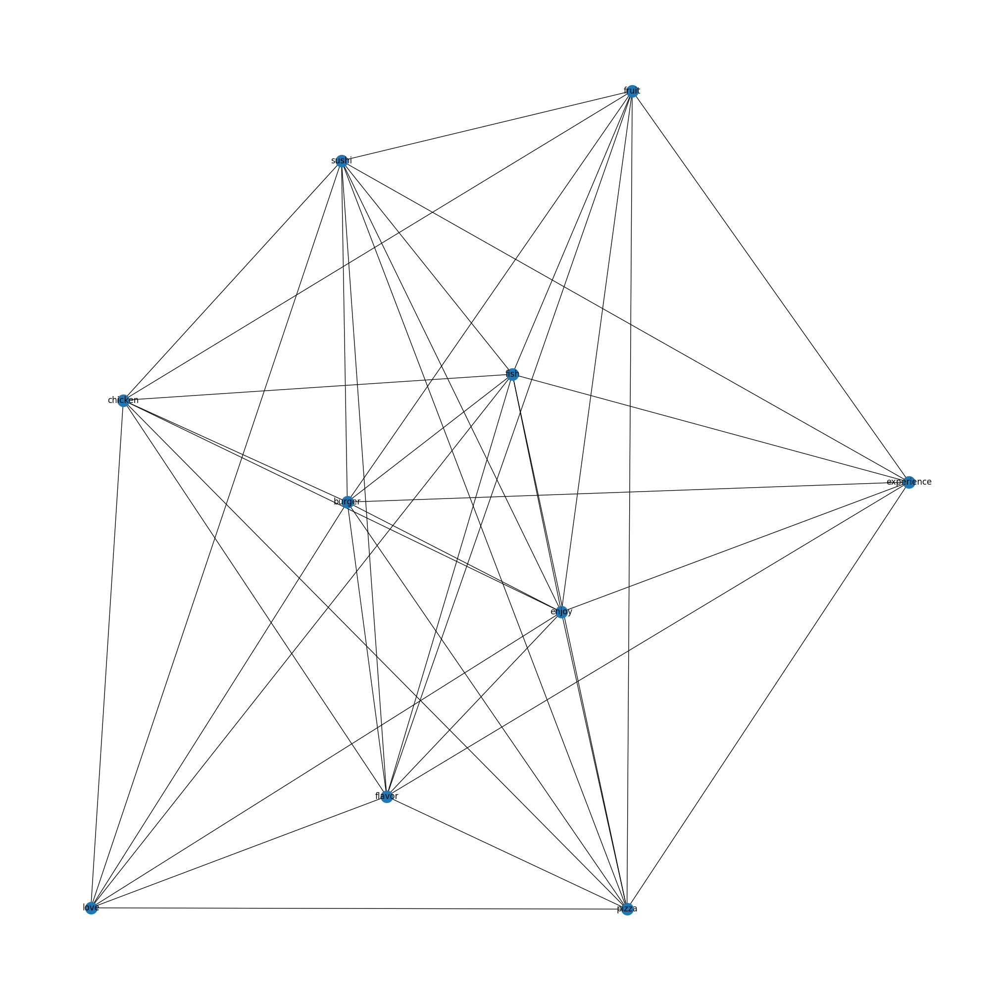

In [108]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['gastronomy','food','gathering','social','like','thing','especially','trying','dish','used','good','started','hamburger','even','right','stuff','crepe','sometimes','lasagna','lately','made','coast','plate','bogota','taste','never','appreciate','waffle','shrimp','time','recently','different','delicious','onion','change','diet','surprisingly','mouth','found','developed','garlic','goodness','spaghetti','special','fry','fried','weird','snail','mature','pasta','occasion','muscle','moved','place','plantain','mexic','prawn','pregnancy','meat','mandarin','sausage','protein','pto','liked','life','recent','kid','jeno','itali','rome','salmon','restaurant','french','book','birthday','dislike','development','texture','brotherinlaw','bud','daughter','cream','crab','called','tomato','type','ceviche','cheese','trip','traveling','tri','also','unique','chinese','family','working','every','variety','eating','enthusiast','various','enjoyed','anchovy','surprise','squid','find','egg','unappealing','party','paradise','trust','quite','pand','rare','unknown','pretty','peace','prepared','whole','unconventional','power','pleasure','pleasant','value','rarely','person','understanding','upgraded','spiciness','response','really','sound','smooth','sneak','someone','take','sou','soup','treat','suddenly','story','start','want','standard','specifically','showed','showdown','shot','seeing','section','secret','second','wide','thought','roll','reward','tossing','translation','world','resist','rephrasing','repetitive','opened','actually','one','consume','consumption','cool','culinary','dance','delicate','deliciously','discover','either','enough','entirely','everyday','example','excitement','excites','explore','explosion','feast','fiesta','firework','first','form','full','funky','consuming','competition','gave','combo','affair','affinity','already','always','amazed','amazing','appeal','appreciating','arrival','avoid','become','begun','best','bite','bland','bumped','cared','certain','chance','check','childhood','clarity','clear','gamechanger','getting','often','later','adulting','liking','little','long','make','makeover','medium','meeting','mentor','menu','might','mild','mini','minivacation','missing','motivated','mystery','needed','note','occasionally','offbeat','offered','officially','level','know','give','knew','goto','guilty','guru','hanging','happened','healthy','highquality','hospital','hospitalized','importance','include','increase','indulging','influence','influenced','influencers','ingredient','innovative','integrating','introduced','italy','keep','kick','wrapped']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p9n = p9noncons.apply(clean_text)
network9n = create_red(p9n, 'network9n')

In [109]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network9n)
dfx

,Node,Total Co-occurrence Frequency
0,burger,432
4,fish,432
2,enjoy,392
5,flavor,350
9,sushi,260
1,chicken,245
8,pizza,212
6,fruit,200
7,love,141
3,experience,138


In [110]:
# Texto proporcionado
texto = """

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

In [111]:
#print("p9c:", p9c.nodes())
#print("p9n:", p9n.nodes())

In [112]:
#plt.title('Question 9: Recent experiences with preferred foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P9.png', dpi=300, bbox_inches='tight')
#plt.show()

#P10-RECENT EXPERIENCES WITH DISLIKED FOODS

In [113]:
p10cons= compared['P51-RECENT EXPERIENCES WITH DISLIKED FOODS-CONS'].astype(str)
p10noncons= compared['P51-RECENT EXPERIENCES WITH DISLIKED FOODS-NONCONS'].astype(str)

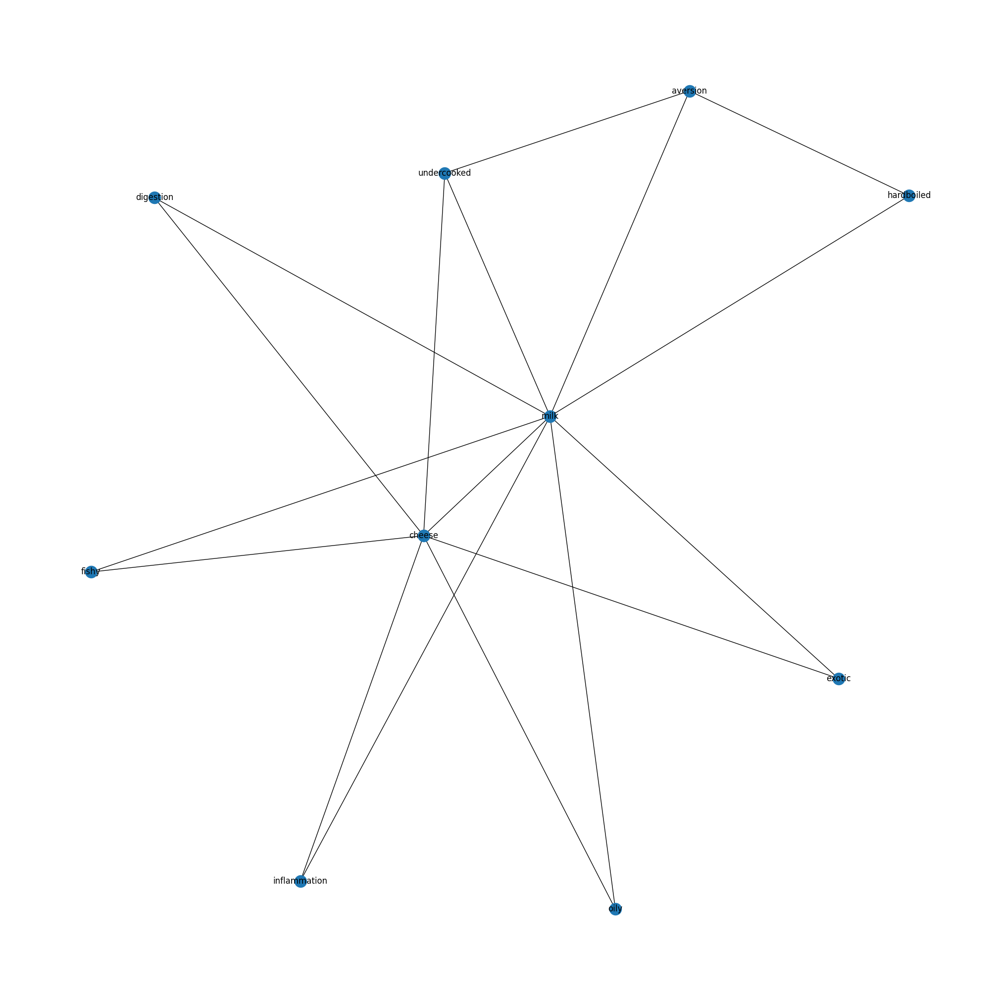

In [114]:
def clean_text(text):
    additional_stopwords = []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['tried','taste','pepper','texture','weird','avoid','egg','sweet','diet','tasted','veggie','health','liver','lentil','glutenfree','like','food','chicken','dont','much','eating','bell','thing','experience','restaurant','dessert','back','even','know','never','anything','nope','bone','burger','something','nogo','dish','nugget','pizza','super','many','vegetable','place','fish','flavor','pas','past','home','fruit','hard','made','good','blood','cautious','sandwich','time','coffee','truck','love','lose','look','hair','take','healthy','vibe','water','well','happened','interest','might','mess','paisa','real','rice','right','pastry','salad','pasta','sausage','shrimp','paella','since','sound','spicy','stand','moving','stuff','popcorn','worth','green','family','certain','cake','drink','crunchy','either','depends','blue','bean','enough','day','consumption','consuming','dislike','always','contain','aged','agree','found','flour','garlic','color','cheeseboard','special','count','said','challenge','cream','starting','scene','soft','contains','sardine','completely','condiment','stick','sauce','shrim','serving','serve','snack','sushi','work','whether','whatever','watery','also','appeal','appreciate','usually','used','turned','trying','attention','avocado','tofu','think','banana','tend','bite','body','taco','bud','sure','cause','strong','crunch','reason','reputation','long','need','else','enemy','mouth','enjoy','enjoyable','menu','meal','especially','adventure','excellent','exciting','local','drinking','expensive','list','eye','left','learned','feel','keep','issue','follow','giving','happening','eater','nothing','repeat','rejected','reduced','hamburger','currently','rarely','ramen','processed','prepared','curry','prefer','postpregnancy','portion','daughter','poorly','plate','often','definitely','pineapple','people','developed','different','digest','party','dressing','otherwise','opened','one','added','yeah','tres','lech','thanks','stopped','stomach','zero','intolerance','must','ruin','service','fancy','bogotá','fearing','getting','urchin','took','strongly','slowly','pandemic','sprout','specific','soda','seemed','pain','mazamorra','care','chontaduro','carbonated','call','crime','resumed','revolted','cardboard','secondary','came','budget','simple','slime','brussels','smelling','repeatedly','redcolored','soap','careful','checking','changed','peppercrazy','pitaya','pool','realize','praise','pretty','price','psauce','pudding','quinoa','breath','oyster','tough','tripledecker','anymore','vowed','ancient','went','wife','wing','wobbly','worked','working','afraid','yikes','associated','toast','birth','specialized','breaking','spoiled','bracket','brace','became','tired','sunbath','tastiest','terrible','balut','tiny','overrated','curb','horrible','fertilized','fishshaped','foot','frog','gave','gelatin','cilantro','goodbye','halfshell','choy','hated','hawaii','hiding','hike','club','fear','cone','delicacy','cute','cutlet','cutting','dared','date','cool','diner','drowning','duck','ever','expiration','honestly','hunt','overkill','indigestion','mode','mold','movie','choked','nemesis','next','none','nono','chestnut','number','oceanflavored','onetime','onion','ordered','mild','accept','mayonnaise','killed','inferno','inherently','interested','joint','kick','leafy','looked','leaving','choking','leg','lesson','liverwurst','longer','abdominal']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p10c = p10cons.apply(clean_text)
network10 = create_red(p10c, 'network10')

In [115]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network10)
dfx

,Node,Total Co-occurrence Frequency
7,milk,108
1,cheese,78
0,aversion,30
9,undercooked,30
5,hardboiled,18
2,digestion,12
3,exotic,12
4,fishy,12
6,inflammation,12
8,oily,12


In [116]:
# Texto proporcionado
texto = """
tried	918
6	taste	611
4	pepper	488
7	texture	413
9	weird	260

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'tried','taste','pepper','texture','weird'


#10N

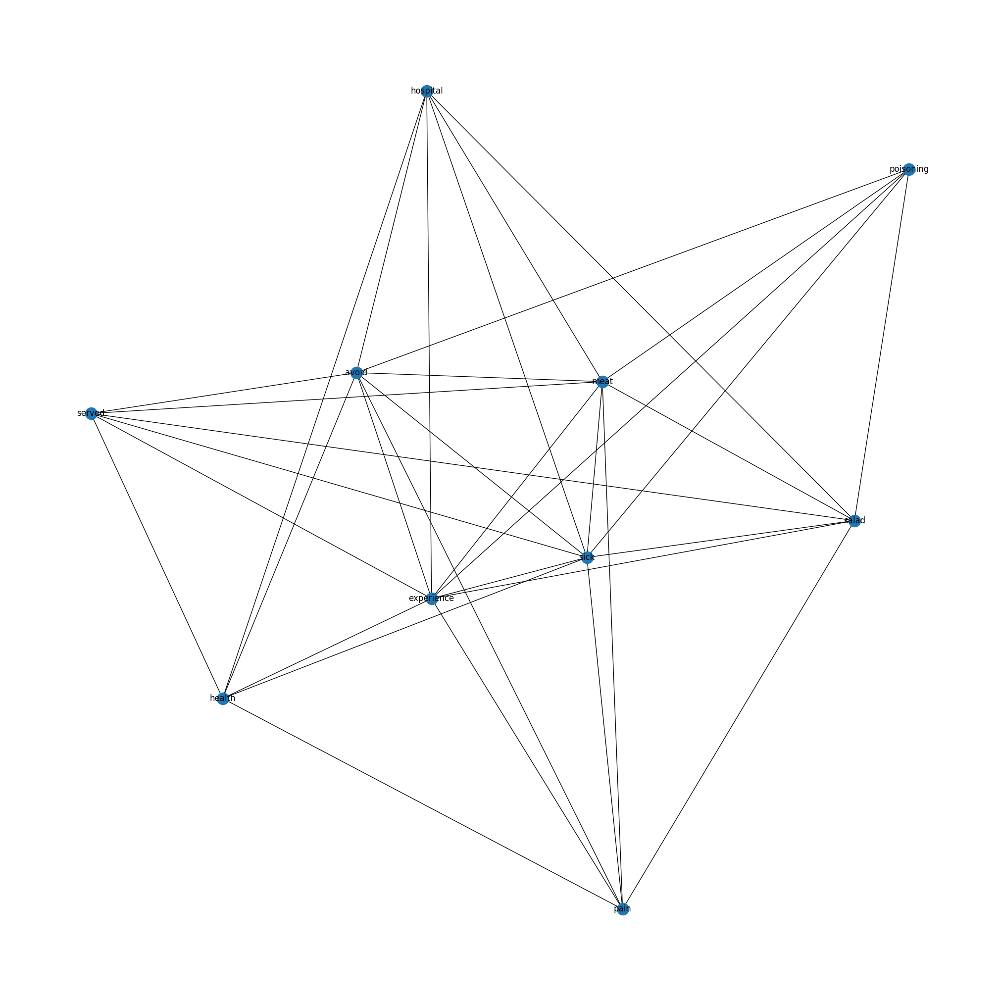

In [117]:
def clean_text(text):
    additional_stopwords =  []
    nltk_stopwords = set(stopwords.words('english')).union(additional_stopwords)
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    cleaned_tokens = []
    for token in tokens:
        token = ''.join([char for char in token if char not in string.punctuation])
        if token and token.lower() not in nltk_stopwords and len(token) > 3 and token.lower() != 've':
            token = re.sub(r'([a-z])([A-Z])', r'\1 \2', token)
            cleaned_tokens.append(lemmatizer.lemmatize(token.lower()))
    text_clean = ' '.join(cleaned_tokens)
    text_clean = ' '.join(text_clean.split())
    text_clean = re.sub(r'\d+', '', text_clean)
    return text_clean
def create_red(p1n, network_id):
    min_word_frequency = 1
    vectorizer = CountVectorizer(ngram_range=(1, 1), min_df=min_word_frequency)
    X_p1n = vectorizer.fit_transform(p1n)  # Vectorización
    words = vectorizer.get_feature_names_out()  # Palabras en la red
    G1n = nx.Graph()
    cooccurrence_matrix = (X_p1n.T @ X_p1n).toarray()  # Convertir a matriz densa
    for word in words:
        G1n.add_node(word)
    for i, word1 in enumerate(words):
        for j, word2 in enumerate(words):
            if i < j:
                weight = cooccurrence_matrix[i, j]
                if weight > 5 and random.random() < 0.8:  # 50% de probabilidad de añadir la arista
                    G1n.add_edge(word1, word2, weight=weight)
    nodes_to_remove = ['feel','fish','feeling','safer','trauma','mushy','overcooked','combined','cleanse','caused','badtasting','food','like','dont','used','aversion','reason','certain','sometimes','consumption','taste','eating','recent','stand','dish','make','currently','sauce','rib','consume','made','acne','soup','pickle','yeah','grain','hard','body','high','heavy','life','grilled','mess','know','good','never','level','pomegranate','wrong','weak','wasting','want','vendor','uric','tomato','time','thick','sugary','stuff','stopped','spinach','something','seed','restaurant','gone','prepared','prefer','pork','reduced','much','either','flour','anymore','although','also','alone','cream','choice','dairy','developed','beetroot','even','burger','smart','skin','soft','simply','fruit','spicy','sound','sight','carnivore','spoiled','buying','steak','steer','similar','come','clear','safe','consumed','restrict','restricting','condition','right','rodizio','rough','share','completely','santa','company','scarred','seafood','sto','seemed','still','suero','train','tri','tricky','tried','trust','trusted','turn','amount','almost','well','without','wonder','worth','would','affecting','advised','year','tough','business','totally','bought','reputable','sure','surprise','swear','swell','tabasco','tell','texture','thing','thought','averse','tired','tolerate','appetizing','respect','reluctance','repulsed','except','invited','irritation','expect','large','learned','leather','left','lesson','enjoyable','ingredient','lip','list','liver','long','look','enjoy','making','marta','interesting','infection','repetitive','guava','gathering','general','getting','given','going','friend','flow','felt','guess','impression','hamburger','haunt','family','fair','expired','homemade','experiencing','house','meal','egg','easy','cross','perspective','pfor','disaster','diet','poorly','decided','precaution','cutting','pto','milk','queasy','cousin','recently','recommended','costeño','relationship','gamechanger','remind','peating','pasta','past','passed','mind','mouth','move','easily','need','negative','done','nogo','occasionally','often','overload','disgusted','parent','particularly','party','zone']
    G1n.remove_nodes_from(nodes_to_remove)
    degrees = dict(G1n.degree())
    top_20_nodes = sorted(degrees, key=degrees.get, reverse=True)[:10]
    nodes_to_keep = set(top_20_nodes)
    nodes_to_remove_specific = set(G1n.nodes()) - set(top_20_nodes)
    G1n.remove_nodes_from(nodes_to_remove_specific)
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G1n)
    nx.draw(G1n, pos, with_labels=True)
    plt.show()
    all_network_labels[network_id] = {word: word for word in G1n.nodes()}
    return G1n
# Aplicar la función clean_text a la copia de la columna
p10n = p10noncons.apply(clean_text)
network10n = create_red(p10n, 'network10n')

In [118]:
def create_node_frequency_dataframe(G):
    node_frequencies = {node: sum(weight for _, _, weight in G.edges(node, data='weight')) for node in G.nodes()}
    dfx = pd.DataFrame(node_frequencies.items(), columns=['Node', 'Total Co-occurrence Frequency'])
    dfx = dfx.sort_values(by='Total Co-occurrence Frequency', ascending=False)
    return dfx
dfx = create_node_frequency_dataframe(network10n)
dfx

,Node,Total Co-occurrence Frequency
4,meat,280
9,sick,259
0,avoid,175
1,experience,160
2,health,132
7,salad,116
3,hospital,72
5,pain,72
8,served,72
6,poisoning,60


In [119]:
# Texto proporcionado
texto = """
8	feel	402
10	fish	174
9	feeling	118
20	safer	42
26	trauma	42
14	mushy	42
15	overcooked	42
6	combined	42
5	cleanse	42
4	caused	42
3	badtasting	42

"""
lineas = texto.split('\n')
palabras = []
for linea in lineas:
    palabras_linea = linea.split()
    palabras_sin_numeros = [palabra for palabra in palabras_linea if not any(c.isdigit() for c in palabra)]
    palabras.extend(palabras_sin_numeros)
cadena_palabras = ','.join(f"'{palabra}'" for palabra in palabras)
print(cadena_palabras)

'feel','fish','feeling','safer','trauma','mushy','overcooked','combined','cleanse','caused','badtasting'


In [120]:
#plt.title('Question 10: Recent experiences with disliked foods - Communities Bipartite Network')
#plt.axis('off')
#plt.legend(handles=combined_handles, loc='upper right', title="Nodes", bbox_to_anchor=(0.02, 0.98), fontsize=13)
#plt.savefig('P10.png', dpi=300, bbox_inches='tight')
#plt.show()

#Pickle

Download de las redes

In [121]:
# Diccionario con todas las redes
all_networks = {
    'network1': network1, 'network1n': network1n, 'network2': network2, 'network2n': network2n,
    'network3': network3, 'network3n': network3n, 'network4': network4, 'network4n': network4n,
    'network5': network5, 'network5n': network5n, 'network6': network6, 'network6n': network6n,
    'network7': network7, 'network7n': network7n, 'network8': network8, 'network8n': network8n,
    'network9': network9, 'network9n': network9n, 'network10': network10, 'network10n': network10n
}
# Guardar cada red en un archivo separado
for name, network in all_networks.items():
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.pickle'
    with open(file_path, 'wb') as f:
        pickle.dump(network, f)

# Exportar el diccionario de etiquetas
with open('all_network_labels.pickle', 'wb') as f:
    pickle.dump(all_network_labels, f)

#Unificación y prepración de redes

Nodos y aristas compartidas para unificación.

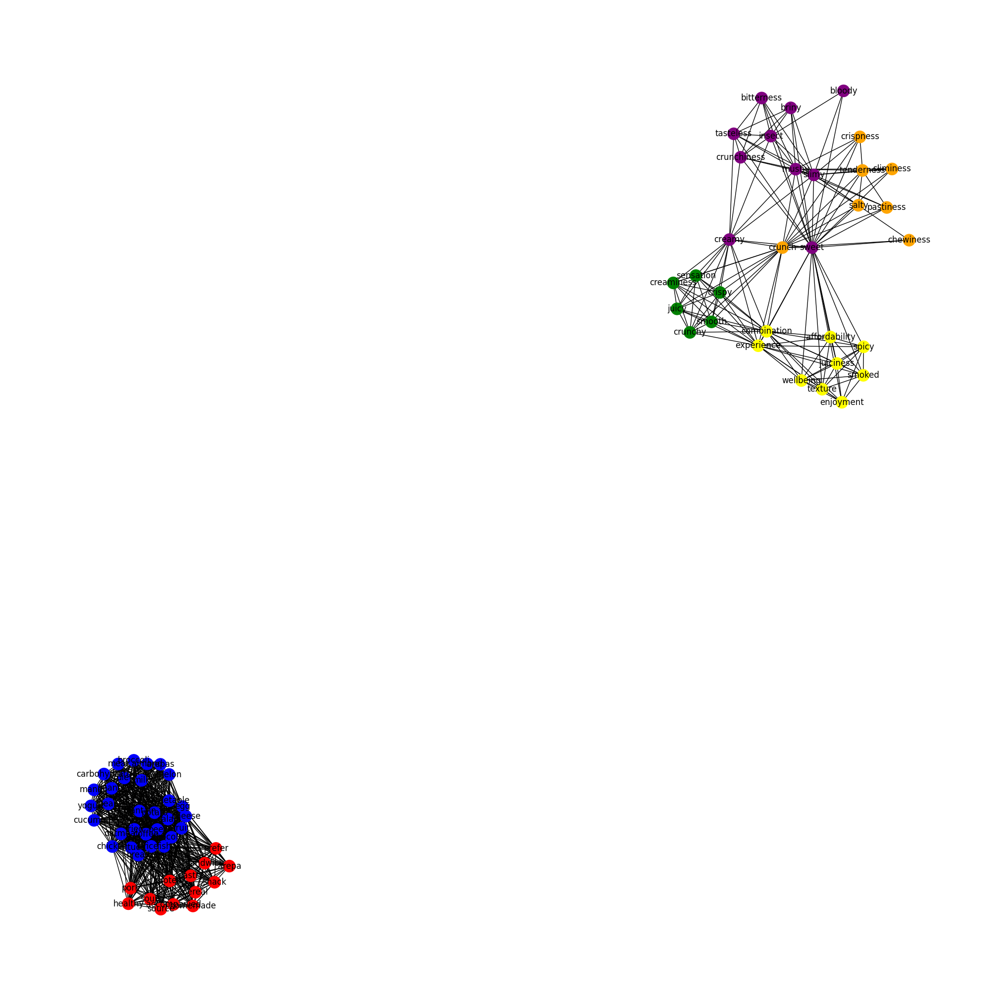

In [122]:
networks = [network1, network1n, network2, network2n, network3, network3n]
colors = ['red', 'blue', 'green', 'yellow', 'orange', 'purple']  # Ajustar según el número de redes


combined_network = nx.Graph() # Combinar redes
for network, color in zip(networks, colors):
    for node, attrs in network.nodes(data=True):     # Añadir  color
        combined_network.add_node(node, color=color)
    for u, v, attrs in network.edges(data=True):
        combined_network.add_edge(u, v, color=color)

plt.figure(figsize=(20, 20))
pos = nx.spring_layout(combined_network)
nx.draw(combined_network, pos, node_color=[combined_network.nodes[n]['color'] for n in combined_network.nodes], with_labels=True)
plt.show()

# Exportar a GEXF
nx.write_gexf(combined_network, 'combined_network.gexf')


#GEXF para Gephi

In [123]:
import networkx as nx

# Diccionario con todas las redes
all_networks = {
    'network1': network1, 'network1n': network1n, 'network2': network2, 'network2n': network2n,
    'network3': network3, 'network3n': network3n, 'network4': network4, 'network4n': network4n,
    'network5': network5, 'network5n': network5n, 'network6': network6, 'network6n': network6n,
    'network7': network7, 'network7n': network7n, 'network8': network8, 'network8n': network8n,
    'network9': network9, 'network9n': network9n, 'network10': network10, 'network10n': network10n
}

# Guardar cada red en formato GEXF
for name, network in all_networks.items():
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.gexf'
    nx.write_gexf(network, file_path)


#Upload de las redes

In [124]:
network_names = [
    'network1', 'network1n', 'network2', 'network2n',
    'network3', 'network3n', 'network4', 'network4n',
    'network5', 'network5n', 'network6', 'network6n',
    'network7', 'network7n', 'network8', 'network8n',
    'network9', 'network9n', 'network10', 'network10n'
]

# Cargar todas las redes desde sus archivos
all_networks = {}
for name in network_names:
    file_path = f'/content/drive/MyDrive/Projects/Insects/{name}_network.pickle'
    with open(file_path, 'rb') as f:
        all_networks[name] = pickle.load(f)


# Ruta al archivo donde se guardó el diccionario
file_path = '/content/drive/MyDrive/Projects/Insects/all_network_labels.pickle'

# Cargar el diccionario desde el archivo
with open(file_path, 'rb') as f:
    all_network_labels = pickle.load(f)

In [125]:
net1 = all_networks['network1'] #Eating Patterns C
net1n = all_networks['network1n'] #Eating Patterns N
net2 = all_networks['network2'] #Characteristics and preferences C
net2n = all_networks['network2n'] #Characteristics and preferences N
net3 = all_networks['network3'] #Characteristics non prefered food C
net3n = all_networks['network3n'] #Characteristics non prefered food N
#-------
net4 = all_networks['network4'] #Cultural C
net4n = all_networks['network4n'] #Cultural N
net5 = all_networks['network5'] #Knowledge Int C
net5n = all_networks['network5n'] #Knowledge Int N
net6 = all_networks['network6'] #Knowledge Colombia C
net6n = all_networks['network6n'] #Knowledge Colombia N
#----- Chilhood Experiences
net7 = all_networks['network7']
net7n = all_networks['network7n']
net8 = all_networks['network8']
net8n = all_networks['network8n']
net9 = all_networks['network9']
net9n = all_networks['network9n']
net10 = all_networks['network10']
net10n = all_networks['network10n']
#To rename the networks is pretty important in the multiplex creation, since the multiplex code will assume the names given here.
net1.name = 'net1' #Eating Patterns C
net1n.name = 'net1n' #Eating Patterns N
net2.name = 'net2' #Characteristics and preferences C
net2n.name = 'net2n' #Characteristics and preferences N
net3.name = 'net3n' #Characteristics non prefered food C
net3n.name = 'net3n' #Characteristics non prefered food N
#-------
net4.name = 'net4' #Cultural C
net4n.name = 'net4n' #Cultural N
net5.name = 'net5' #Knowledge Int C
net5n.name = 'net5n' #Knowledge Int N
net6.name = 'net6' #Knowledge Colombia C
net6n.name = 'net6n' #Knowledge Colombia N
#----- Chilhood Experiences
net7.name = 'net7' #childhood + prefered food C
net7n.name = 'net7n' #childhood + prefered food N
net8.name = 'net8' #childhood + non prefered food C
net8n.name = 'net8n' #childhood + non prefered food N
#----------------------------------------------------
net9.name = 'net9' #Recent + prefered food C
net9n.name = 'net9n' #Recent + prefered food N
net10.name = 'net10' #Recent + non prefered food C
net10n.name = 'net10n' #Recent + non prefered food N

#Multiplex

es posible, en base a este codigo generar un dataframe que imprima una columna llamada nodos donde esten todas las etiquetas de los nodos, una columna que se llame capa que contenga la capa que corresponde a cada nodo, una columa que diga centralidad intercapa y se imprima la centralidad intercapa de cada nodo, una columa que diga comunidad y que se imprima un asterisco * si el nodo tiene alta comunidad, ** dos asteriscos ysi la comunidad es media y *** tres asteriscos si la comunidd del nodo es baja.

#Eating paterns

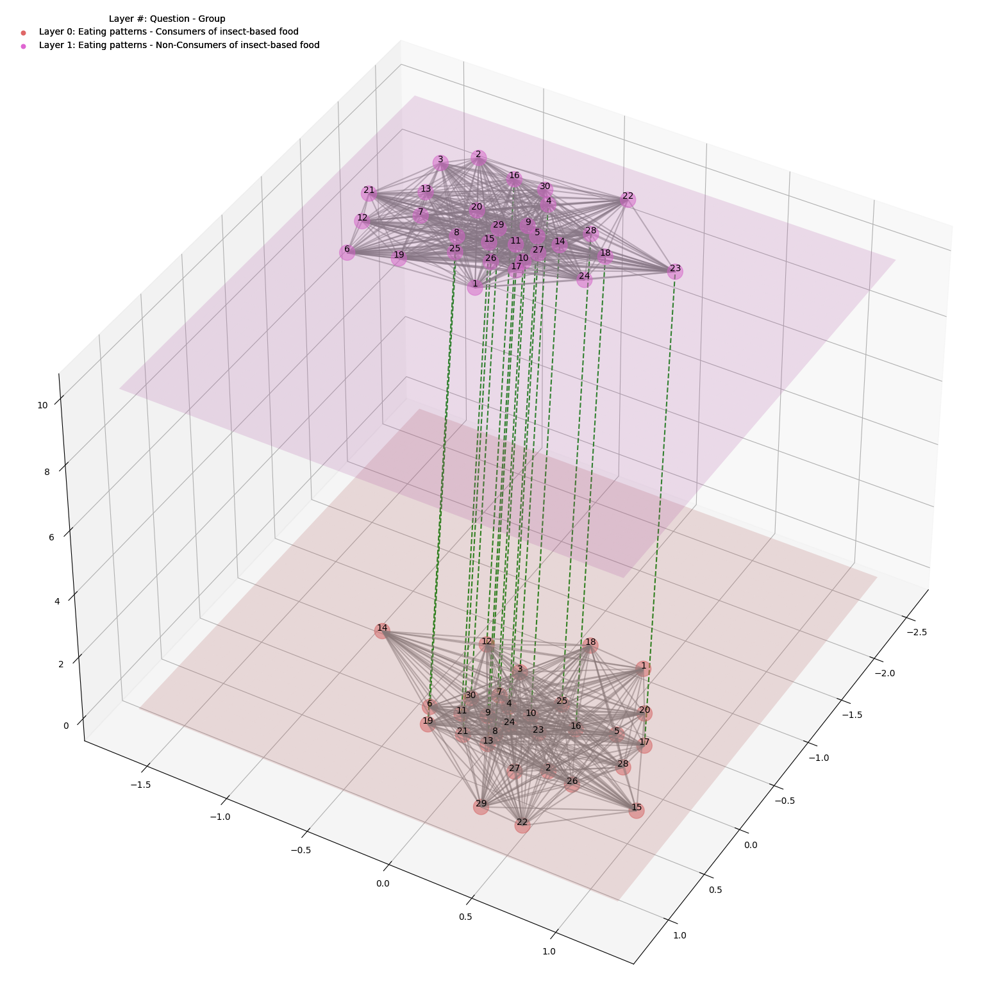

In [126]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})
    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()
        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net1, net1n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.5, linestyle='-', zorder=1)
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net1':'#DF6767',
    'net1n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Eating patterns - Consumers of insect-based food':'#DF6767',
    'Layer 1: Eating patterns - Non-Consumers of insect-based food':'#DF67D2'
}
network_offsets = {
    'net1': {'x_offset': 0.5, 'y_offset': 0.5}, #naranja
    'net1n': {'x_offset': -1.5, 'y_offset': -0.5}, #rosado
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=30) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net1, net1n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=4.7, iterations=40),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork1.svg', format='svg', dpi=300)

In [127]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df = df.to_latex(index=0)
df


,Node,CN,L,EC,IC
0,1 (accompanied),,0,0.18,23
1,2 (arepa),,0,0.164,21
2,3 (beef),"(beef, 1)",0,0.207*,29
3,4 (bread),"(bread, 1)",0,0.195*,27
4,5 (cereal),,0,0.178,23
5,6 (cheese),"(cheese, 1)",0,0.179*,25
6,7 (chicken),"(chicken, 1)",0,0.177*,25
7,8 (chocolate),"(chocolate, 1)",0,0.187*,26
8,9 (coffee),"(coffee, 1)",0,0.178*,25
9,10 (egg),"(egg, 1)",0,0.162*,23


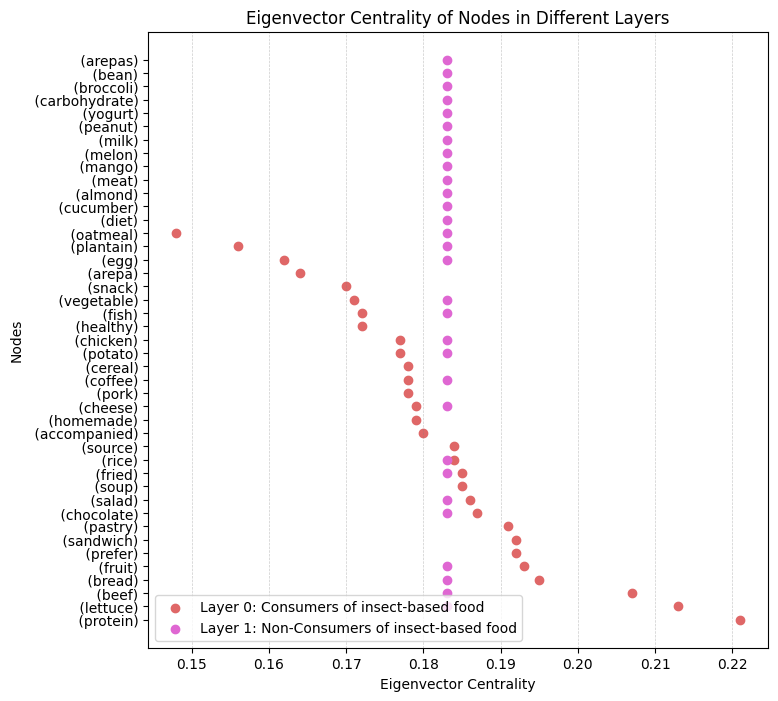

In [128]:
df['Node_Name'] = df['Node'].str.extract(r'(\D+)')
df['EC_Value'] = df['EC'].str.rstrip('*').astype(float)
df_sorted = df.sort_values(by='EC_Value', ascending=False)
plt.figure(figsize=(8, 8))
colors = ['#DF6767', '#DF67D2']
for layer in df_sorted['L'].unique(): # Graficamos cada grupo por separado para tener una leyenda para cada uno.
    df_layer = df_sorted[df_sorted['L'] == layer]
    df_layer = df_layer.drop_duplicates(subset='Node_Name') # Aseguramos que cada etiqueta de nodo se muestre solo una vez.
    plt.scatter(df_layer['EC_Value'], df_layer['Node_Name'], c=colors[layer],
                label=f'Layer {layer}: {"Consumers" if layer == 0 else "Non-Consumers"} of insect-based food')
plt.grid(which='major', linestyle='--', linewidth='0.5', color='grey', axis='x', alpha=0.4)
plt.xlabel('Eigenvector Centrality')
plt.ylabel('Nodes')
plt.title('Eigenvector Centrality of Nodes in Different Layers')
plt.legend(loc='best')
plt.show()
fig.savefig('ECLayer1.svg', format='svg', dpi=300)

#Characteristics

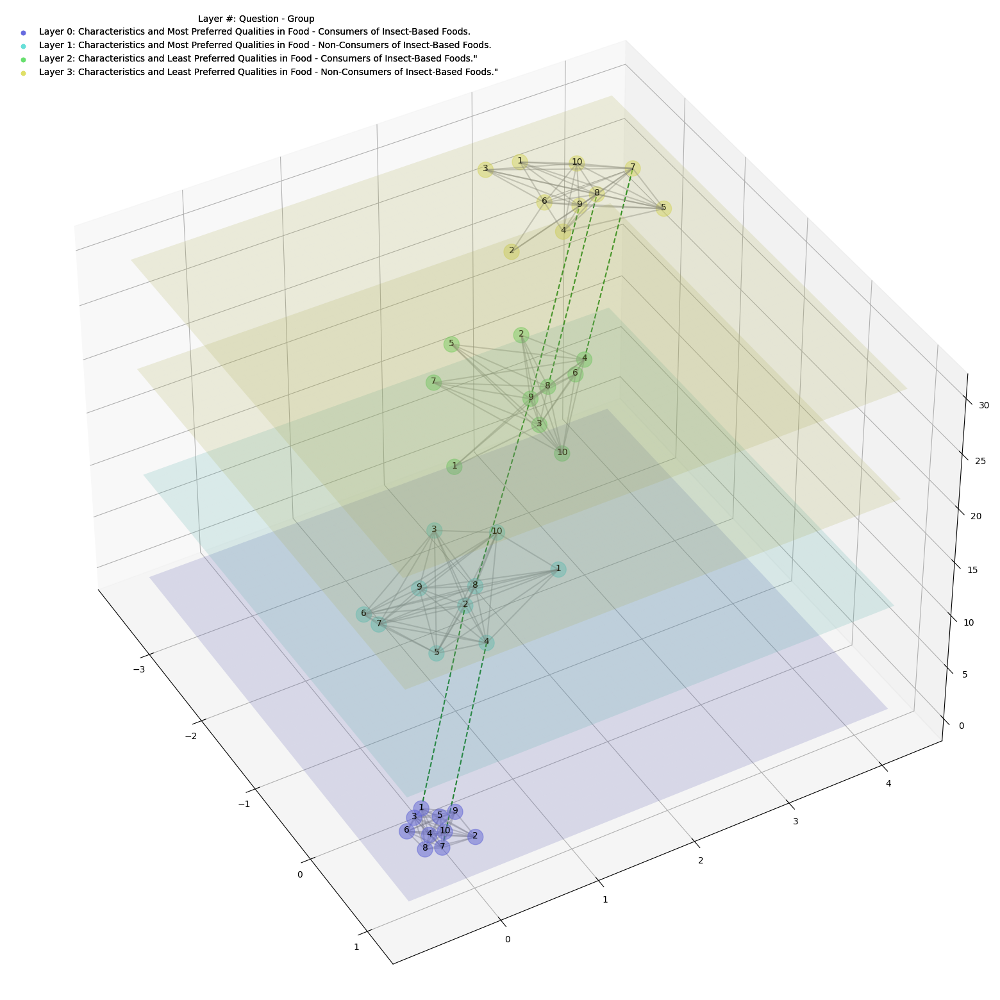

In [129]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net2, net2n, net3, net3n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net2':'#676BDF',
    'net2n':'#67DFD8',
    'net3':'#67DF6E',
    'net3n':'#DFDF67'
}

legend_infou = {
    'Layer 0: Characteristics and Most Preferred Qualities in Food - Consumers of Insect-Based Foods.':'#676BDF',
    'Layer 1: Characteristics and Most Preferred Qualities in Food - Non-Consumers of Insect-Based Foods.':'#67DFD8',
    'Layer 2: Characteristics and Least Preferred Qualities in Food - Consumers of Insect-Based Foods."':'#67DF6E',
    'Layer 3: Characteristics and Least Preferred Qualities in Food - Non-Consumers of Insect-Based Foods."':'#DFDF67'
}
network_offsets = {
    'net2': {'x_offset': 1.0, 'y_offset': 0.0}, #morado
    'net2n': {'x_offset': -0.9, 'y_offset': 1}, #Aguamarina
    'net3': {'x_offset': 3.5, 'y_offset': 0.0}, #verde
    'net3n': {'x_offset': -0.8, 'y_offset': 1}, #Amarilla -> Toda la visualización depende de dónde está la primera y la últoma red.
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=40, azim=-30) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net2, net2n, net3, net3n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=3, iterations=17),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()

# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork2.svg', format='svg', dpi=300)

In [130]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df2 = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df2 = df2.to_latex(index= 0)
df2

,Node,CN,L,EC,IC
0,1 (combination),"(combination, 1)",0,0.316*,11
1,2 (creaminess),,0,0.316,9
2,3 (creamy),,0,0.316,9
3,4 (crispy),,0,0.316,9
4,5 (crunch),,0,0.316,9
5,6 (crunchy),,0,0.316,9
6,7 (experience),"(experience, 1)",0,0.316*,11
7,8 (juicy),,0,0.316,9
8,9 (sensation),,0,0.316,9
9,10 (smooth),,0,0.316,9


\begin{table}[h]
\caption{Title of the Table}
\label{Table:2}
\begin{tabular}{llrlr}
\toprule
              Node &                CN &  L &      EC &  IC \\
\midrule
   1 (combination) &            (2, 1) &  0 &  0.212* &   5 \\
    2 (creaminess) &                   &  0 &   0.556 &   6 \\
        3 (creamy) &                   &  0 &   0.246 &   2 \\
    4 (crispiness) &                   &  0 &   0.246 &   2 \\
     5 (crispness) &                   &  0 &   0.275 &   2 \\
       6 (crunchy) &                   &  0 &    0.34 &   3 \\
       7 (grilled) &                   &  0 &   0.362 &   3 \\
         8 (juicy) &                   &  0 &   0.065 &   1 \\
        9 (mixing) &                   &  0 &   0.346 &   3 \\
   10 (smoothness) &                   &  0 &    0.28 &   3 \\
 1 (affordability) &                   &  1 &   0.302 &   8 \\
   2 (combination) &                   &  1 &   0.334 &  11 \\
     3 (enjoyment) &                   &  1 &   0.302 &   8 \\
    4 (experience) &                   &  1 &   0.269 &   7 \\
     5 (juiciness) &                   &  1 &   0.334 &   9 \\
        6 (smoked) &                   &  1 &   0.334 &   9 \\
         7 (spicy) &                   &  1 &   0.306 &   8 \\
         8 (sweet) &            (9, 2) &  1 &  0.306* &  10 \\
       9 (texture) &                   &  1 &   0.334 &   9 \\
    10 (wellbeing) &                   &  1 &   0.334 &   9 \\
     1 (chewiness) &                   &  2 &   0.213 &   3 \\
     2 (crispness) &                   &  2 &   0.343 &   5 \\
        3 (crunch) &                   &  2 &   0.401 &   7 \\
   4 (ecofriendly) &                   &  2 &   0.213 &   3 \\
         5 (fried) &                   &  2 &   0.213 &   3 \\
         6 (mushy) &            (7, 3) &  2 &   0.35* &   7 \\
     7 (pastiness) &                   &  2 &   0.295 &   4 \\
         8 (slimy) &            (8, 3) &  2 &  0.453* &  10 \\
         9 (sweet) &            (9, 3) &  2 &  0.252* &   9 \\
   10 (tenderness) &                   &  2 &   0.326 &   5 \\
    1 (bitterness) &                   &  3 &   0.288 &   6 \\
        2 (bloody) &                   &  3 &   0.145 &   3 \\
         3 (briny) &                   &  3 &   0.288 &   6 \\
        4 (creamy) &                   &  3 &   0.242 &   5 \\
   5 (crunchiness) &                   &  3 &   0.351 &   8 \\
        6 (insect) &                   &  3 &   0.368 &   9 \\
         7 (mushy) &                   &  3 &   0.351 &  10 \\
         8 (slimy) &                   &  3 &   0.368 &  11 \\
         9 (sweet) &                   &  3 &   0.339 &  10 \\
    10 (tasteless) &                   &  3 &   0.351 &   8 \\
\bottomrule
\end{tabular}

#Cultural Beleifs

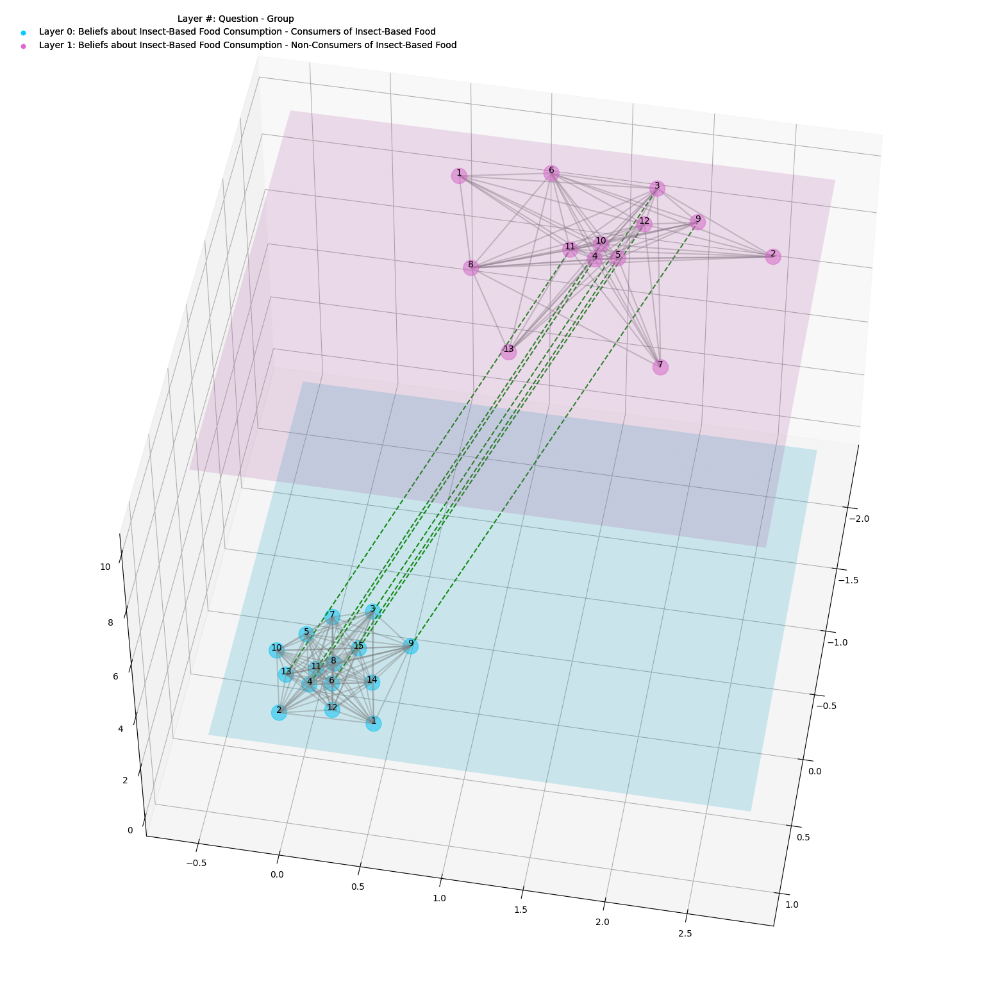

In [131]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net4, net4n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=10, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)

legend_info = {
    'net4':'#03CDFE',
    'net4n':'#DF67D2'
}
legend_infou = {
    'Layer 0: Beliefs about Insect-Based Food Consumption - Consumers of Insect-Based Food':'#03CDFE',
    'Layer 1: Beliefs about Insect-Based Food Consumption - Non-Consumers of Insect-Based Food':'#DF67D2'
}
network_offsets = {
    'net4': {'x_offset': -0.5, 'y_offset': -0.5}, #Azul
    'net4n': {'x_offset': -1.5, 'y_offset': 1.5}, #Purpura
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=50, azim=370) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net4, net4n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=2.5, iterations=30),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()

# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork3.svg', format='svg', dpi=300)

In [132]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df3 = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df3 = df3.to_latex(index=0)
df3

,Node,CN,L,EC,IC
0,1 (acceptance),,0,0.258,14
1,2 (bigbottomed),,0,0.258,14
2,3 (cricket),"(cricket, 1)",0,0.258*,16
3,4 (cultural),"(cultural, 1)",0,0.258*,16
4,5 (culturally),,0,0.258,14
5,6 (culture),"(culture, 1)",0,0.258*,16
6,7 (ecological),,0,0.258,14
7,8 (food),,0,0.258,14
8,9 (heritage),"(heritage, 1)",0,0.258*,16
9,10 (history),,0,0.258,14


\begin{tabular}{llrlr}
\toprule
              Node &                  CN &  L &      EC &  IC \\
\midrule
   1 (bigbottomed) &             (1, 1) &  0 &  0.355* &   8 \\
       2 (cricket) &             (4, 1) &  0 &  0.272* &   7 \\
 3 (crosscultural) &                     &  0 &   0.216 &   4 \\
      4 (cultural) &              (5, 1) &  0 &  0.309* &   7 \\
    5 (culturally) &                     &  0 &   0.339 &   6 \\
       6 (culture) &              (6, 1) &  0 &  0.179* &   5 \\
       7 (diverse) &                     &  0 &    0.14 &   3 \\
     8 (ecosystem) &                     &  0 &   0.229 &   5 \\
 9 (environmental) &              (9, 1) &  0 &  0.229* &   7 \\
     10 (heritage) &             (10, 1) &  0 &  0.269* &   7 \\
      11 (history) &                     &  0 &   0.264 &   4 \\
  12 (nutritional) &                     &  0 &   0.233 &   5 \\
      13 (protein) &             (12, 1) &  0 &  0.394* &   9 \\
       14 (region) &                     &  0 &   0.093 &   2 \\
    15 (tradition) &             (13, 1) &  0 &  0.162* &   5 \\
   1 (bigbottomed) &                     &  1 &    0.22 &   7 \\
     2 (cockroach) &                     &  1 &    0.23 &   6 \\
       3 (colombi) &                     &  1 &   0.267 &   7 \\
       4 (cricket) &                     &  1 &   0.243 &   8 \\
      5 (cultural) &                     &  1 &   0.364 &  12 \\
       6 (culture) &                     &  1 &   0.264 &   9 \\
     7 (diversity) &                     &  1 &    0.27 &   7 \\
        8 (edible) &                     &  1 &   0.239 &   6 \\
 9 (environmental) &                     &  1 &   0.197 &   7 \\
     10 (heritage) &                     &  1 &   0.256 &   8 \\
       11 (insect) &                     &  1 &     0.3 &   8 \\
      12 (protein) &                     &  1 &   0.371 &  12 \\
    13 (tradition) &                     &  1 &   0.323 &  11 \\
\bottomrule
\end{tabular}


#Knowlwdge

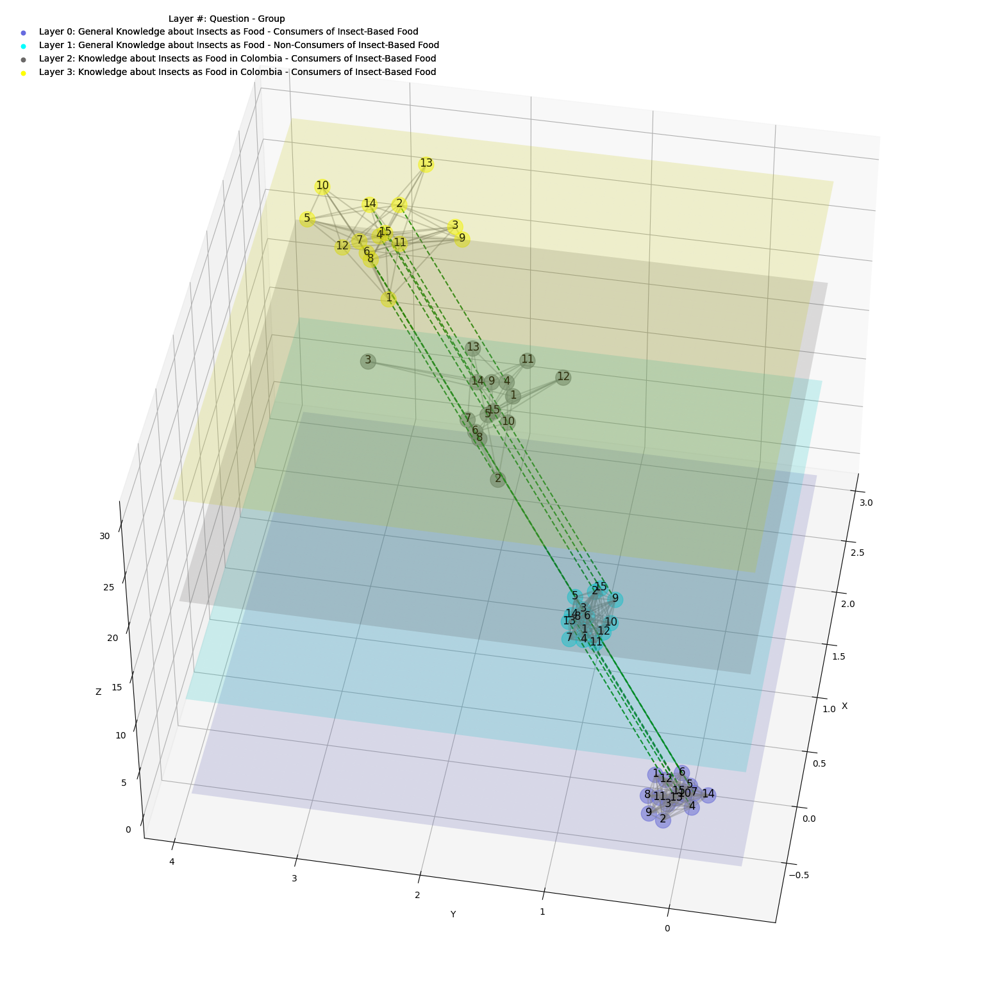

In [133]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net5, net5n, net6, net6n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=12, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net5':'#676BDF',
    'net5n':'#03FEFE',
    'net6':'#6B6968',
    'net6n':'#FEFE03'
}
legend_infou = {
'Layer 0: General Knowledge about Insects as Food - Consumers of Insect-Based Food': '#676BDF',
'Layer 1: General Knowledge about Insects as Food - Non-Consumers of Insect-Based Food': '#03FEFE',
'Layer 2: Knowledge about Insects as Food in Colombia - Consumers of Insect-Based Food': '#6B6968',
'Layer 3: Knowledge about Insects as Food in Colombia - Consumers of Insect-Based Food': '#FEFE03'
}
network_offsets = {
    'net5': {'x_offset': 0, 'y_offset':0}, #morado
    'net5n': {'x_offset':0.6, 'y_offset': 1}, #Aguamarina
    'net6': {'x_offset': 0.6, 'y_offset':1}, #negra
    'net6n': {'x_offset':0.6, 'y_offset': 1}, #Amarilla -> Toda la visualización depende de dónde está la primera y la últoma red.
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=45, azim=190) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net5, net5n, net6, net6n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=2, iterations=30),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork4.svg', format='svg', dpi=300)

In [134]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df4 = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df4 = df4.to_latex(index=0)
df4

,Node,CN,L,EC,IC
0,1 (afric),,0,0.258,14
1,2 (aphrodisiac),,0,0.258,14
2,3 (bigbottomed),,0,0.258,14
3,4 (cockroach),"(cockroach, 1)",0,0.258*,16
4,5 (cricket),"(cricket, 1)",0,0.258*,16
5,6 (cultural),"(cultural, 1)",0,0.258*,16
6,7 (culture),"(culture, 1)",0,0.258*,16
7,8 (environmental),,0,0.258,14
8,9 (indigenous),,0,0.258,14
9,10 (insect),"(insect, 1)",0,0.258*,16


\begin{tabular}{llrlr}
\toprule
                Node &                CN &  L &      EC &  IC \\
\midrule
           1 (afric) &                   &  0 &    0.19 &   4 \\
     2 (bigbottomed) &                   &  0 &   0.269 &   5 \\
      11 (cockroach) &            (2, 1) &  0 &  0.318* &   8 \\
       12 (cultural) &                   &  0 &    0.28 &   5 \\
         3 (culture) &            (5, 1) &  0 &  0.231* &   6 \\
      4 (indigenous) &                   &  0 &   0.264 &   5 \\
         13 (insect) &            (8, 1) &  0 &  0.228* &   6 \\
         5 (mineral) &                   &  0 &   0.231 &   4 \\
         6 (mojojoy) &                   &  0 &   0.264 &   5 \\
     7 (nutritional) &           (12, 1) &  0 &  0.154* &   5 \\
           14 (peru) &                   &  0 &   0.266 &   5 \\
         8 (protein) &                   &  0 &   0.307 &   6 \\
        9 (scorpion) &                   &  0 &   0.254 &   5 \\
        15 (vitamin) &                   &  0 &   0.259 &   5 \\
           10 (worm) &           (15, 1) &  0 &  0.307* &   8 \\
           1 (china) &                   &  1 &   0.159 &   3 \\
       2 (cockroach) &                   &  1 &   0.273 &   7 \\
        3 (colombia) &           (11, 2) &  1 &   0.23* &   6 \\
         4 (critter) &                   &  1 &   0.193 &   3 \\
         5 (culture) &            (4, 2) &  1 &  0.197* &   8 \\
      6 (ecological) &                   &  1 &   0.136 &   3 \\
      7 (innovation) &                   &  1 &   0.301 &   5 \\
          8 (insect) &            (6, 2) &  1 &   0.28* &  10 \\
     9 (insectbased) &                   &  1 &   0.333 &   6 \\
         10 (market) &                   &  1 &   0.162 &   3 \\
         11 (mexico) &                   &  1 &   0.238 &   4 \\
    12 (nutritional) &                   &  1 &    0.31 &   8 \\
 13 (sustainability) &                   &  1 &   0.123 &   3 \\
    14 (sustainable) &                   &  1 &   0.395 &   7 \\
           15 (worm) &           (15, 2) &  1 &  0.351* &  10 \\
          9 (amazon) &                   &  2 &   0.204 &   4 \\
          1 (bogotá) &            (2, 3) &  2 &  0.096* &   4 \\
         10 (brazil) &                   &  2 &   0.121 &   2 \\
          2 (burger) &            (3, 3) &  2 &  0.279* &   6 \\
       11 (colombia) &            (5, 3) &  2 &  0.192* &   7 \\
        12 (cricket) &            (6, 3) &  2 &  0.311* &   7 \\
   13 (cricketbased) &                   &  2 &   0.193 &   3 \\
        3 (cultural) &            (7, 3) &  2 &  0.324* &   7 \\
         4 (culture) &            (8, 3) &  2 &    0.3* &   8 \\
       5 (delicious) &                   &  2 &   0.304 &   5 \\
          6 (insect) &           (11, 3) &  2 &  0.183* &   7 \\
         7 (mojojoy) &                   &  2 &   0.396 &   6 \\
       14 (scorpion) &                   &  2 &    0.22 &   4 \\
       8 (tradition) &           (14, 3) &  2 &  0.325* &   7 \\
           15 (worm) &           (15, 3) &  2 &  0.235* &   9 \\
         1 (amazona) &                   &  3 &   0.182 &   5 \\
          2 (bogotá) &                   &  3 &   0.232 &   8 \\
          3 (burger) &                   &  3 &   0.295 &  10 \\
           4 (cauca) &                   &  3 &   0.253 &   6 \\
        5 (colombia) &                   &  3 &   0.109 &   5 \\
         6 (cricket) &                   &  3 &   0.202 &   7 \\
        7 (cultural) &                   &  3 &     0.2 &   8 \\
         8 (culture) &                   &  3 &   0.332 &  11 \\
     9 (entomophagy) &                   &  3 &   0.289 &   7 \\
           10 (farm) &                   &  3 &   0.275 &   7 \\
         11 (insect) &                   &  3 &     0.2 &   7 \\
         12 (mexico) &                   &  3 &   0.276 &   7 \\
          13 (rural) &                   &  3 &   0.279 &   7 \\
      14 (tradition) &                   &  3 &   0.394 &  13 \\
           15 (worm) &                   &  3 &   0.223 &   8 \\
\bottomrule
\end{tabular}


#Childhood

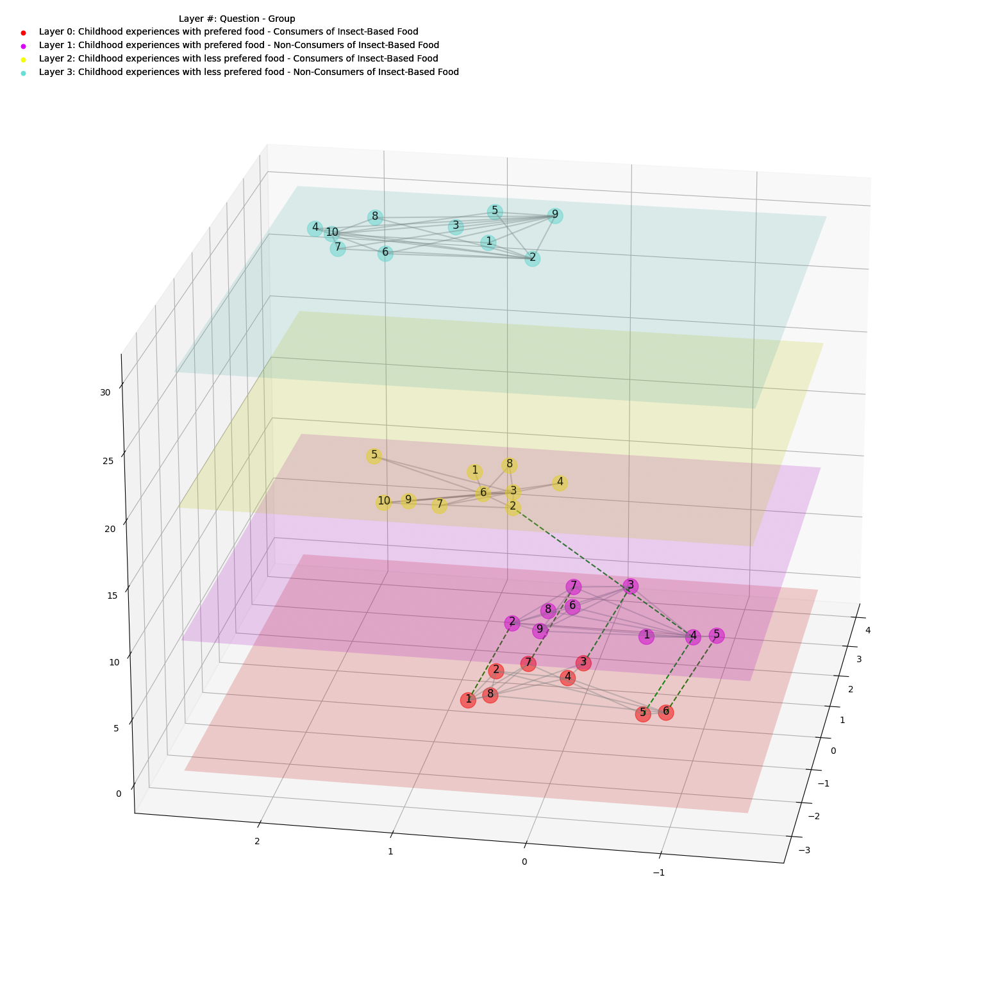

In [135]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net7, net7n, net8, net8n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=12, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net7':'#FE0303',
    'net7n':'#DC03FE', #Morado
    'net8':'#F6FE03', #Amarillo
    'net8n':'#67DFD8',

}
legend_infou = {
    'Layer 0: Childhood experiences with prefered food - Consumers of Insect-Based Food':'#FE0303',
    'Layer 1: Childhood experiences with prefered food - Non-Consumers of Insect-Based Food':'#DC03FE',
    'Layer 2: Childhood experiences with less prefered food - Consumers of Insect-Based Food':'#F6FE03',
    'Layer 3: Childhood experiences with less prefered food - Non-Consumers of Insect-Based Food':'#67DFD8'
}
network_offsets = {
    'net7': {'x_offset': -1, 'y_offset': 0.5},
    'net7n': {'x_offset': -1.5, 'y_offset': -0.5}, #Morado
    'net8': {'x_offset': -1.0, 'y_offset': 0.4}, #Amarillo
    'net8n': {'x_offset': 0.8, 'y_offset': 0.5},
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=22, azim=190) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net7, net7n, net8, net8n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=3, iterations=3),
                                    ax=ax)
graph.calculate_eigenvector_centrality()
graph.get_edges_between_layers_by_eigenvector_centrality()
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()

# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork5.svg', format='svg', dpi=300)

In [136]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df5 = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df5 = df5.to_latex(index=0)
df5

,Node,CN,L,EC,IC
0,1 (birthday),"(birthday, 1)",0,0.407*,6
1,2 (countryside),,0,0.43,4
2,3 (cultural),"(cultural, 1)",0,0.221*,4
3,4 (emotion),,0,0.381,4
4,5 (family),"(family, 1)",0,0.173*,4
5,6 (grandmother),"(grandmother, 1)",0,0.381*,6
6,7 (love),"(love, 1)",0,0.274*,5
7,8 (texture),,0,0.453,5
8,1 (adventure),,1,0.096,1
9,2 (birthday),,1,0.413,7


#Recent

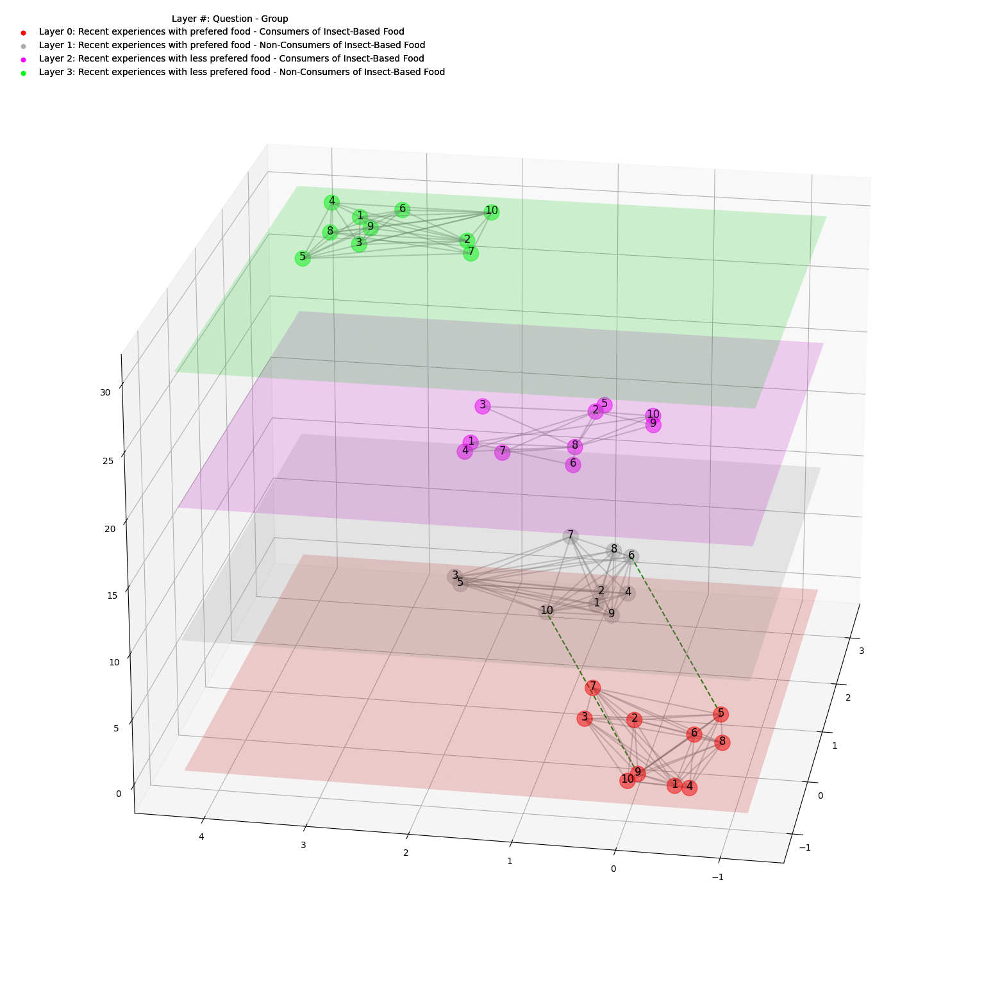

In [137]:
class LayeredNetworkGraph(object):
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        self.graphs = graphs
        self.total_layers = len(graphs)
        self.node_labels = node_labels
        self.layout = layout
        if ax:
            self.ax = ax
        else:
            fig = plt.figure()
            self.ax = fig.add_subplot(111, projection='3d')
        self.eigenvector_centrality = {}
        self.get_nodes()
        self.get_edges_within_layers()
        self.calculate_eigenvector_centrality()  # Primero calcula la centralidad
        self.get_edges_between_layers_by_eigenvector_centrality()  # Luego obtén los bordes basados en la centralidad
        self.get_node_positions()
        self.draw()
    def get_nodes(self):
        self.nodes = []
        for z, g in enumerate(self.graphs):
            self.nodes.extend([(node, z) for node in g.nodes()])
    def get_edges_within_layers(self):
        self.edges_within_layers = []
        for z, g in enumerate(self.graphs):
            self.edges_within_layers.extend([((source, z), (target, z)) for source, target in g.edges()])
    def get_edges_between_layers_by_eigenvector_centrality(self):
        self.edges_between_layers_by_eigenvector_centrality = []
        for z1, g in enumerate(self.graphs[:-1]):
            z2 = z1 + 1
            h = self.graphs[z2]
            shared_nodes = set(g.nodes()) & set(h.nodes())
            sorted_nodes = sorted(shared_nodes, key=lambda n:self.eigenvector_centrality[(n, z1)], reverse=True)
            self.edges_between_layers_by_eigenvector_centrality.extend([((node, z1), (node, z2)) for node in sorted_nodes])
    def calculate_eigenvector_centrality(self):
        for z, g in enumerate(self.graphs):
            centrality = nx.eigenvector_centrality(g)
            self.eigenvector_centrality.update({(n, z): centrality[n] for n in g.nodes()})


    def get_node_positions(self, *args, **kwargs):
        composition = self.graphs[0]
        for h in self.graphs[1:]:
            composition = nx.compose(composition, h)
        pos = self.layout(composition, *args, **kwargs)
        self.node_positions = dict()

        for z, g in enumerate(self.graphs):
            layer_offset = z * 10  # Desplazamiento en z
            network_name = g.name
            # Obtén los desplazamientos de x e y para esta red específica
            x_layer_offset = network_offsets.get(network_name, {}).get('x_offset', 0) * z
            y_layer_offset = network_offsets.get(network_name, {}).get('y_offset', 0) * z

            # Actualiza las posiciones de los nodos con los desplazamientos personalizados
            self.node_positions.update({
                (node, z): (pos[node][0] + x_layer_offset, pos[node][1] + y_layer_offset, layer_offset)
                for node in g.nodes()
            })
    def draw_nodes(self, nodes, color,alpha =None, *args, **kwargs):
        x, y, z = zip(*[self.node_positions[node] for node in nodes])
        self.ax.scatter(x, y, z, color=color, alpha = 0.5, *args, **kwargs)
    def draw_edges(self, edges, *args, **kwargs):
        segments = [(self.node_positions[source], self.node_positions[target]) for source, target in edges]
        line_collection = Line3DCollection(segments, *args, **kwargs)
        self.ax.add_collection3d(line_collection)
    def get_extent(self, pad=0.1):
        xyz = np.array(list(self.node_positions.values()))
        xmin, ymin, _ = np.min(xyz, axis=0)
        xmax, ymax, _ = np.max(xyz, axis=0)
        dx = xmax - xmin
        dy = ymax - ymin
        return (xmin - pad * dx, xmax + pad * dx), \
            (ymin - pad * dy, ymax + pad * dy)
    def draw_plane(self, z, *args, **kwargs):
        network_name = self.graphs[z].name
        color = legend_info.get(network_name, '#CCCCCC')
        (xmin, xmax), (ymin, ymax) = self.get_extent(pad=0.1)
        u = np.linspace(xmin, xmax, 150)
        v = np.linspace(ymin, ymax, 150)
        U, V = np.meshgrid(u, v)
        layer_offset = z * 10
        W = layer_offset * np.ones_like(U)
        self.ax.plot_surface(U, V, W, color=color, *args, **kwargs)
    def synchronize_labels(self):
        # Asegura que cada nodo en node_positions tenga una etiqueta en node_labels.
        missing_labels = set(self.node_positions.keys()) - set(self.node_labels.keys())
        for node in missing_labels:
            self.node_labels[node] = f"Nodo {node[0]}"

        # Opcionalmente, también podría eliminar cualquier etiqueta que no tenga un nodo correspondiente.
        extra_labels = set(self.node_labels.keys()) - set(self.node_positions.keys())
        for node in extra_labels:
            del self.node_labels[node]
    def draw(self):
        self.draw_edges(self.edges_within_layers, color='black', alpha=0.3, linestyle='-', zorder=2)
        self.draw_edges(self.edges_between_layers, color='Red', alpha=0.8, linestyle='--', zorder=2)
        for z in range(self.total_layers):
            # Se llama a draw_plane con el color correcto
            self.draw_plane(z, alpha=0.2, zorder=1)
            color = legend_info.get(self.graphs[z].name, 'default_color')
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
        if self.node_labels:
            self.draw_node_labels(self.node_labels,
                                  horizontalalignment='center',
                                  verticalalignment='center',
                                  zorder=100)
    def draw_node_labels(self, labels, font_size=9, color='black', **kwargs):  # Tamaño de fuente reducido
        for node, (x, y, z) in self.node_positions.items():
            label = labels.get(node, f'{node[0]}')
            self.ax.text(x, y, z, label, fontsize=font_size, color=color, alpha=0.7, **kwargs)  # Añadida transparencia
node_labels = {}
for z, g in enumerate([net9, net9n, net10, net10n]):
    for node in g.nodes():
        node_labels[(node, z)] = f'Nodo {node}'
class ModifiedLayeredNetworkGraph(LayeredNetworkGraph): #Se encarga únicamente de las comunidades de las redes.
    def __init__(self, graphs, node_labels=None, layout=nx.spring_layout, ax=None):
        super().__init__(graphs, node_labels=node_labels, layout=layout, ax=ax)
        """Determine edges between layers based on community detection."""
    def order_nodes_by_community(self):
        multiplex_network = nx.Graph()
        for z, g in enumerate(self.graphs):
            g = nx.relabel_nodes(g, {n: (n, z) for n in g.nodes()})
            multiplex_network = nx.compose(multiplex_network, g)
        partition = community_louvain.best_partition(multiplex_network)
        community_sizes = defaultdict(int)
        for node, community in partition.items():
            community_sizes[community] += 1
        ordered_nodes = {}
        for z, g in enumerate(self.graphs):
            nodes_in_layer = [(n, community_sizes[partition[(n, z)]]) for n in g.nodes()]
            nodes_in_layer.sort(key=lambda x: x[1], reverse=True)
            ordered_nodes[z] = [node for node, _ in nodes_in_layer]
        # Actualiza las etiquetas de los nodos
        for z, nodes in ordered_nodes.items():
            for i, node in enumerate(nodes):
                self.node_labels[(node, z)] = f'{i + 1}'
    def draw(self):
        top_centrality_edges = self.edges_between_layers_by_eigenvector_centrality[:3]
        other_edges = self.edges_between_layers_by_eigenvector_centrality[3:]
        self.draw_edges(top_centrality_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(other_edges, color='green', alpha=0.9, linestyle='--', zorder=2)
        self.draw_edges(self.edges_within_layers, color='grey', alpha=0.4, linestyle='-', zorder=1)
        # Dibuja planos para cada capa
        for z in range(self.total_layers):
            self.draw_plane(z, alpha=0.18, zorder=1)
        # Dibuja TODOS los nodos de TODAS las capas con el color correspondiente
        for z in range(self.total_layers):
            color = legend_info[list(legend_info.keys())[z]]  # Obtiene el color de la leyenda
            self.draw_nodes([node for node in self.nodes if node[1] == z], color=color, s=300, zorder=5)
class NodeLabelPrinter:
    def __init__(self, ax, node_positions, node_labels, font_size=12, color='black'):
        self.ax = ax
        self.node_positions = node_positions
        self.node_labels = node_labels
        self.font_size = font_size
        self.color = color
    def print_labels(self):
        for node, position in self.node_positions.items():
            if node in self.node_labels:
                x, y, z = position
                label = self.node_labels[node]
                self.ax.text(x, y, z + 0.1, label, fontsize=self.font_size, color=self.color,
                             ha='center', va='center', zorder=11)
legend_info = {
    'net9':'#FE0303',
    'net9n':'#ADADAD',
    'net10':'#F303FE',
    'net10n':'#03FE12'
}
legend_infou = {
    'Layer 0: Recent experiences with prefered food - Consumers of Insect-Based Food':'#FE0303', #Rojo
    'Layer 1: Recent experiences with prefered food - Non-Consumers of Insect-Based Food':'#ADADAD',
    'Layer 2: Recent experiences with less prefered food - Consumers of Insect-Based Food':'#F303FE', #Lila/Morado
    'Layer 3: Recent experiences with less prefered food - Non-Consumers of Insect-Based Food':'#03FE12' #verde
}
network_offsets = {
    'net9': {'x_offset': 3.5, 'y_offset': 0.3}, #Rojo
    'net9n': {'x_offset': 0.5, 'y_offset': 1}, #
    'net10': {'x_offset': 0.5, 'y_offset': 0.5}, #Morado
    'net10n': {'x_offset': 0.8, 'y_offset': 1}, #Verde
}
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.view_init(elev=22, azim=190) #Elevación y Eje Z
graph = ModifiedLayeredNetworkGraph([net9, net9n, net10, net10n],
                                    node_labels=node_labels,
                                    layout=lambda G: nx.spring_layout(G, k=7, iterations=3),
                                    ax=ax)
graph.order_nodes_by_community()
label_printer = NodeLabelPrinter(ax, graph.node_positions, node_labels)
label_printer.print_labels()

# Código para la leyenda y para mostrar la gráfica
for label, color in legend_infou.items():
    ax.scatter([], [], c=color, label=label)
legend_color = ax.legend(title="Layer #: Question - Group", loc='upper left', frameon=False)
ax.add_artist(legend_color)
plt.draw()
plt.show()
fig.savefig('Multinetwork6.svg', format='svg', dpi=300)

In [138]:
top_centrality_edges = {}
for edge in graph.edges_between_layers_by_eigenvector_centrality:
    top_centrality_edges[edge[0]] = edge[1]  # Mapear el nodo de la capa actual a su nodo conectado en la siguiente capa
data = []
for node in graph.nodes:
    centrality_marker = ''
    connected_node_label = ''
    if node in top_centrality_edges:
        centrality_marker = '*'
        connected_node = top_centrality_edges[node]
        connected_node_label = connected_node[0],connected_node[1]  # Modificado para mostrar solo el número y la capa
    eigenvector_centrality = round(graph.eigenvector_centrality.get(node, 0), 3)
    node_label_and_number = f"{node_labels.get(node, 'Nodo')} ({node[0]})"
    layer = node[1]
    degree = len([edge for edge in graph.edges_within_layers if node in edge])
    inter_layer_connections = len([target for edge in graph.edges_between_layers_by_eigenvector_centrality for target in edge if node in edge])
    inter_layer_centrality = degree + inter_layer_connections
    row = {
        'Node': node_label_and_number,
        'CN': connected_node_label,
        'L': layer,
        'EC': f"{eigenvector_centrality}{centrality_marker}",
        'IC': inter_layer_centrality
    }
    data.append(row)
df6 = pd.DataFrame(data, columns=['Node', 'CN', 'L', 'EC', 'IC'])
#df6 = df6.to_latex(index = 0)
df6

,Node,CN,L,EC,IC
0,1 (cauliflower),,0,0.342,9
1,2 (culture),,0,0.308,8
2,3 (different),,0,0.308,8
3,4 (family),,0,0.308,8
4,5 (flavor),"(flavor, 1)",0,0.342*,11
5,6 (friend),,0,0.308,8
6,7 (hamburger),,0,0.312,8
7,8 (recently),,0,0.342,9
8,9 (sushi),"(sushi, 1)",0,0.312*,10
9,10 (tried),,0,0.274,7


\begin{tabular}{llrlr}
\toprule
            Node &           CN &  L &      EC &  IC \\
\midrule
 1 (cauliflower) &              &  0 &   0.352 &   8 \\
   2 (different) &              &  0 &   0.217 &   5 \\
      3 (family) &              &  0 &   0.305 &   7 \\
      4 (flavor) &  (flavor, 1) &  0 &  0.338* &  10 \\
      5 (friend) &  (friend, 1) &  0 &  0.304* &   9 \\
   6 (hamburger) &              &  0 &   0.338 &   8 \\
        7 (meat) &              &  0 &   0.304 &   7 \\
    8 (recently) &              &  0 &   0.316 &   7 \\
       9 (sushi) &   (sushi, 1) &  0 &  0.352* &  10 \\
      10 (tried) &   (tried, 1) &  0 &  0.316* &   9 \\
      1 (burger) &              &  1 &   0.318 &   8 \\
     2 (chicken) &              &  1 &   0.291 &   7 \\
 3 (combination) &              &  1 &   0.351 &   9 \\
       4 (enjoy) &              &  1 &   0.327 &   8 \\
        5 (fish) &              &  1 &   0.351 &   9 \\
      6 (flavor) &              &  1 &   0.327 &  10 \\
      7 (friend) &              &  1 &   0.212 &   7 \\
       8 (pizza) &              &  1 &   0.318 &   8 \\
       9 (sushi) &              &  1 &   0.351 &  11 \\
      10 (tried) &              &  1 &   0.291 &   9 \\
   1 (associate) &              &  2 &   0.288 &   3 \\
    2 (aversion) &              &  2 &   0.242 &   4 \\
      3 (cheese) &              &  2 &   0.516 &   8 \\
   4 (digestion) &              &  2 &   0.232 &   2 \\
      5 (exotic) &              &  2 &   0.232 &   2 \\
  6 (hardboiled) &              &  2 &   0.176 &   2 \\
        7 (milk) &              &  2 &   0.483 &   7 \\
       8 (mushy) &              &  2 &   0.232 &   2 \\
   9 (pregnancy) &              &  2 &   0.288 &   3 \\
       10 (sick) &    (sick, 3) &  2 &  0.288* &   5 \\
        1 (acid) &              &  3 &   0.254 &   5 \\
       2 (avoid) &              &  3 &   0.357 &   8 \\
  3 (experience) &              &  3 &   0.357 &   8 \\
      4 (health) &              &  3 &   0.369 &   8 \\
        5 (meat) &              &  3 &   0.369 &   8 \\
        6 (pain) &              &  3 &   0.299 &   6 \\
     7 (product) &              &  3 &   0.299 &   6 \\
       8 (salad) &              &  3 &   0.269 &   6 \\
      9 (served) &              &  3 &   0.254 &   5 \\
       10 (sick) &              &  3 &   0.303 &   8 \\
\bottomrule
\end{tabular}


La centralidad de autovector es una medida que evalúa la importancia de un nodo en una red en función de la importancia de sus vecinos. En otras palabras, un nodo tiene una alta centralidad de autovector si está conectado con otros nodos que también son importantes.

Cuando observas la tabla con la centralidad de autovector agregada, cada fila representa un nodo en tu red. Aquí hay algunas pautas generales para interpretar la centralidad de autovector:

Mayor Valor Significa Mayor Importancia: Los nodos con valores más altos de centralidad de autovector son considerados más importantes en la red.

Influencia Indirecta: Si un nodo tiene una alta centralidad de autovector, significa que está conectado a otros nodos que también son importantes. Esto refleja la capacidad del nodo para influir indirectamente en la red a través de sus conexiones.

No es Solo Cantidad de Conexiones: A diferencia de la centralidad de grado, la centralidad de autovector no se basa únicamente en la cantidad de conexiones directas de un nodo, sino en la importancia de esos nodos conectados.

En resumen, al analizar la centralidad de autovector, puedes identificar nodos que tienen un impacto indirecto significativo en la red al estar conectados con otros nodos importantes. Esto puede ser útil para comprender la estructura de la red y la influencia potencial de ciertos nodos en la difusión de información o la propagación de comportamientos.

#Pagerank NetworkX

#ÍNdice de DICE: para ámbos grupos cons y noncons

#Teoria de redes.

François Chollet and J.J. Allaire. "Deep Learning with Python." Capítulo 6: Deep learning for text and sequences. Manning Publications, 2018.

Sebastian Raschka and Vahid Mirjalili. "Python Machine Learning, 3rd Edition." Capítulo 7: Text Mining. Packt Publishing, 2019. ---> se llama (3) Sebastian Raschka en el google drive


Jurafsky, D., & Martin, J. H. (2008). Speech and language processing (2nd ed.). Prentice Hall. ---> está guardado como ed3book.pdf en el drive ---> Muy buen documento para justificar y estructurar la metodología del documento.


Natural language processing (NLP) is a subfield of artificial intelligence that deals with the understanding and generation of human language. One of the most important tasks in NLP is text mining, which is the process of extracting valuable information from unstructured text data. (Jurafsky & Martin, 2008)

Vectorization is a technique that is used to represent text data in a way that can be easily processed by a computer. This is done by converting the text into a vector of numbers, where each number represents the frequency of a particular word or phrase in the text.

There are a number of different ways to vectorize text data, but one of the most common is to use ngrams. An ngram is a sequence of n consecutive words or phrases. For example, the trigram "the quick brown fox" is a sequence of three consecutive words.

Ngrams can be used to capture the meaning of text data by representing the relationships between words and phrases. This makes them a powerful tool for text mining tasks such as sentiment analysis, topic modeling, and information retrieval.

The use of ngrams for text vectorization is well-supported by the literature. In their book "Speech and Language Processing," Jurafsky and Martin (2008) discuss the use of ngrams for language modeling and information retrieval. They note that ngrams can be used to capture the statistical dependencies between words and phrases, which can be helpful for improving the performance of NLP tasks.

In their book "Deep Learning with Python," Chollet and Allaire (2018) also discuss the use of ngrams for text vectorization. They note that ngrams can be used to create a more expressive representation of text data, which can be helpful for improving the performance of deep learning models.

Finally, in their book "Python Machine Learning, 3rd Edition," Raschka and Mirjalili (2019) discuss the use of ngrams for text vectorization. They note that ngrams can be used to improve the performance of NLP tasks such as sentiment analysis and topic modeling.

In conclusion, the use of ngrams for text vectorization is well-supported by the literature. Ngrams can be used to capture the meaning of text data by representing the relationships between words and phrases. This makes them a powerful tool for text mining tasks such as sentiment analysis, topic modeling, and information retrieval.

#MultinetX *texto en cursiva*

In [140]:
!pip install python-multipart
!pip install git+https://github.com/nkoub/multinetx.git

  Cloning https://github.com/nkoub/multinetx.git to /tmp/pip-req-build-404xgmth
  Running command git clone --filter=blob:none --quiet https://github.com/nkoub/multinetx.git /tmp/pip-req-build-404xgmth
  Resolved https://github.com/nkoub/multinetx.git to commit 767ffa817bb47a3a2c06758808152ce03bc468e6
  Preparing metadata (setup.py) ... done


In [141]:
import networkx as nx
from community import community_louvain
import numpy as np
import multinetx as mx

In [152]:
def convert_to_int_labels(G): #transformar nodos a etiquetas enteras
    mapping = {node: i for i, node in enumerate(G.nodes())}
    return nx.relabel_nodes(G, mapping)
def detectar_comunidades(G): #comunidades
    return community_louvain.best_partition(G)
def calcular_peso(nodo1, nodo2, propiedades1, propiedades2): #Se implementa una función para identificar los pesos de las aristas basado en sus propiedades especificas.
    return (propiedades1[nodo1]['grado'] + propiedades2[nodo2]['grado']) / 2
def crear_grafo_bipartito(comunidades1, comunidades2, propiedades1, propiedades2): # Ahora la función acepta cuatro argumentos
    B = nx.Graph()
    for nodo, comunidad in comunidades1.items():
        B.add_node(f"net1_{nodo}", bipartite=0, comunidad=comunidad)
    for nodo, comunidad in comunidades2.items():
        B.add_node(f"net1n_{nodo}", bipartite=1, comunidad=comunidad)
    for nodo1, comunidad1 in comunidades1.items():  # Pequeño ciclo for que trabaja en base al peso que se les da a las propiedades de los nodos, esto en base al artiulo de Santraetal.
        for nodo2, comunidad2 in comunidades2.items():
            if comunidad1 == comunidad2:
                peso = calcular_peso(nodo1, nodo2, propiedades1, propiedades2) # Usa las propiedades para calcular el peso
                B.add_edge(f"net1_{nodo1}", f"net1n_{nodo2}", weight=peso)
    return B
net1_int = convert_to_int_labels(net1) #transformar nodos a etiquetas enteras... aplicando la función.
net1n_int = convert_to_int_labels(net1n)
propiedades_net1 = {nodo: {'grado': net1_int.degree(nodo)} for nodo in net1_int.nodes()} #Función de propiedades (Comunidad y grado)
propiedades_net1n = {nodo: {'grado': net1n_int.degree(nodo)} for nodo in net1n_int.nodes()}
mg = mx.MultilayerGraph() # Crear un grafo multicapa y añadir las capas
mg.add_layer(net1_int)
mg.add_layer(net1n_int)
comunidades_net1 = detectar_comunidades(net1_int) # Detectar comunidades en cada capa aplicando función.
comunidades_net1n = detectar_comunidades(net1n_int)
grafo_bipartito = crear_grafo_bipartito(comunidades_net1, comunidades_net1n, propiedades_net1, propiedades_net1n) # Construir un grafo bipartito
print("Nodos del grafo bipartito:", grafo_bipartito.nodes(data=True)) # Inspeccionar el grafo bipartito
print("Aristas del grafo bipartito:", grafo_bipartito.edges(data=True))

Nodos del grafo bipartito: [('net1_0', {'bipartite': 0, 'comunidad': 0}), ('net1_1', {'bipartite': 0, 'comunidad': 0}), ('net1_2', {'bipartite': 0, 'comunidad': 0}), ('net1_3', {'bipartite': 0, 'comunidad': 1}), ('net1_4', {'bipartite': 0, 'comunidad': 0}), ('net1_5', {'bipartite': 0, 'comunidad': 1}), ('net1_6', {'bipartite': 0, 'comunidad': 1}), ('net1_7', {'bipartite': 0, 'comunidad': 0}), ('net1_8', {'bipartite': 0, 'comunidad': 0}), ('net1_9', {'bipartite': 0, 'comunidad': 0}), ('net1_10', {'bipartite': 0, 'comunidad': 0}), ('net1_11', {'bipartite': 0, 'comunidad': 0}), ('net1_12', {'bipartite': 0, 'comunidad': 1}), ('net1_13', {'bipartite': 0, 'comunidad': 1}), ('net1_14', {'bipartite': 0, 'comunidad': 0}), ('net1_15', {'bipartite': 0, 'comunidad': 0}), ('net1_16', {'bipartite': 0, 'comunidad': 0}), ('net1_17', {'bipartite': 0, 'comunidad': 0}), ('net1_18', {'bipartite': 0, 'comunidad': 1}), ('net1_19', {'bipartite': 0, 'comunidad': 1}), ('net1_20', {'bipartite': 0, 'comunidad': 

El detectos de comunidades generaba un diccionario en las variables comunidades_net1 y comunidades_net1n con numeros enteros, entonces diseñé una función para transformar estos valores y así poder interpretarlos más adelante agrupando las comunidades y poder usarlas como criterio para seleccionar los pesos y demás.

In [153]:
def agrupar_comunidades(comunidades):
    comunidades_agrupadas = {}
    for nodo, comunidad in comunidades.items():
        if comunidad in comunidades_agrupadas:
            comunidades_agrupadas[comunidad].add(nodo)
        else:
            comunidades_agrupadas[comunidad] = {nodo}
    return comunidades_agrupadas
comunidades_agrupadas_net1 = agrupar_comunidades(comunidades_net1)
comunidades_agrupadas_net1n = agrupar_comunidades(comunidades_net1n)


Identificar Meta-nodos y Meta-aristas: Tus meta-nodos son las comunidades detectadas en cada capa. Las meta-aristas las estableces conectando comunidades (meta-nodos) de diferentes capas.

Asignación de Pesos a Meta-aristas: El peso de una meta-arista debe reflejar la interacción entre las comunidades de las capas conectadas. Esto puede basarse en la cantidad de aristas entre los nodos de estas comunidades y sus propiedades. Puedes utilizar una métrica como la suma o el promedio de los grados de los nodos involucrados, o cualquier otra métrica relevante según tu análisis.

Crear Conexiones entre Capas: Añade aristas en tu MultilayerGraph (mg) para representar estas meta-aristas. Por ejemplo, si tienes una comunidad en la capa 1 y otra en la capa 2 que deben estar conectadas, añade una arista entre representantes (o nodos promedio) de estas comunidades en tu MultilayerGraph.

In [154]:
def conectar_comunidades(comunidad1, comunidad2, G1, G2, umbral):
    # Encuentra los nodos comunes entre dos comunidades
    nodos_comunes = set(comunidad1).intersection(set(comunidad2))
    # Conectar si la cantidad de nodos comunes supera el umbral
    return len(nodos_comunes) > umbral
def calcular_peso_meta_arista(comunidad1, comunidad2, G1, G2):
    # Calcula el peso basado en la cantidad de aristas entre las comunidades
    peso = sum(1 for u, v in G1.edges() if u in comunidad1 and v in comunidad2)
    return peso
# Determina el umbral para conectar comunidades
umbral_conexion = 5  # Ajusta este valor según tus necesidades
# Conectar comunidades y asignar pesos a las meta-aristas
for id_comunidad1, nodos_comunidad1 in comunidades_agrupadas_net1.items():
    for id_comunidad2, nodos_comunidad2 in comunidades_agrupadas_net1n.items():
        if conectar_comunidades(nodos_comunidad1, nodos_comunidad2, net1_int, net1n_int, umbral_conexion):
            peso = calcular_peso_meta_arista(nodos_comunidad1, nodos_comunidad2, net1_int, net1n_int)
            grafo_bipartito.add_edge(f"comunidad_{id_comunidad1}", f"comunidad_{id_comunidad2}", weight=peso)

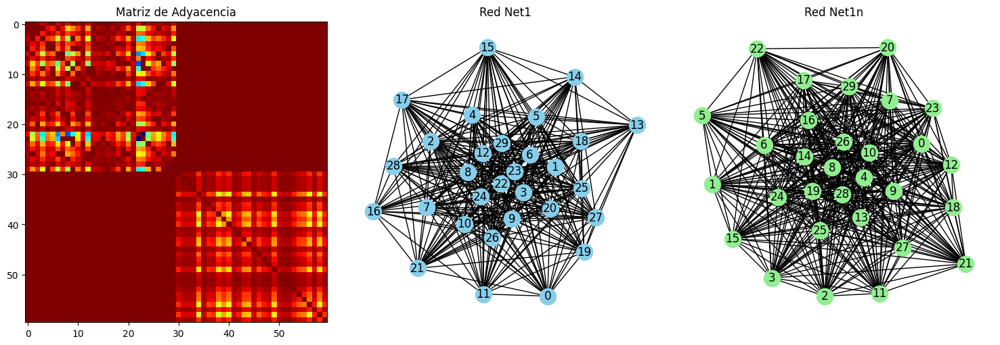

In [160]:
net1_int = convert_to_int_labels(net1)
net1n_int = convert_to_int_labels(net1n)
mg = mx.MultilayerGraph()
mg.add_layer(net1_int)
mg.add_layer(net1n_int)
comunidades_net1 = detectar_comunidades(net1_int)
comunidades_net1n = detectar_comunidades(net1n_int)
grafo_bipartito = crear_grafo_bipartito(comunidades_net1, propiedades_net1, propiedades_net1n, comunidades_net1n)
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
# Visualización de la matriz de adyacencia
ax = axs[0]
ax.imshow(mx.adjacency_matrix(mg).todense(), origin='upper', interpolation='nearest', cmap=plt.cm.jet_r)
ax.set_title('Matriz de Adyacencia')
# Visualización de net1
ax = axs[1]
pos = nx.spring_layout(net1_int, k=2)
nx.draw(net1_int, pos, ax=ax, with_labels=True, node_color='skyblue')
ax.set_title('Red Net1')
# Visualización de net1n
ax = axs[2]
pos = nx.spring_layout(net1n_int, k=2)
nx.draw(net1n_int, pos, ax=ax, with_labels=True, node_color='lightgreen')
ax.set_title('Red Net1n')
plt.tight_layout()
plt.show()


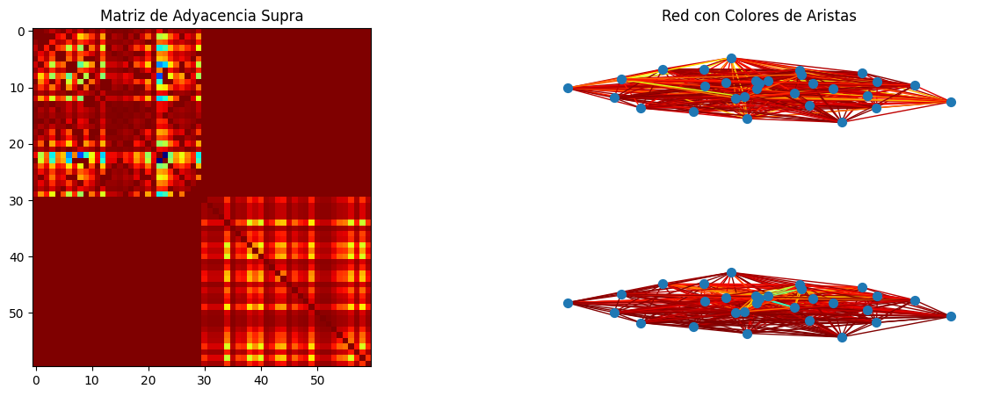

In [161]:
# Visualización
fig = plt.figure(figsize=(15, 5))
# Matriz de adyacencia supra
ax1 = fig.add_subplot(121)
ax1.imshow(mx.adjacency_matrix(mg, weight='weight').todense(), origin='upper', interpolation='nearest', cmap=plt.cm.jet_r)
ax1.set_title('Matriz de Adyacencia Supra')
# Red con colores de aristas
ax2 = fig.add_subplot(122)
ax2.axis('off')
ax2.set_title('Red con Colores de Aristas')
pos = mx.get_position(mg, mx.fruchterman_reingold_layout(mg), layer_vertical_shift=0.2, layer_horizontal_shift=0.0, proj_angle=47)
mx.draw_networkx(mg, pos=pos, ax=ax2, node_size=50, with_labels=False, edge_color=[mg[a][b]['weight'] for a,b in mg.edges()], edge_cmap=plt.cm.jet_r)
plt.show()
